In [1]:
%matplotlib inline

# Import custom scripts

In [2]:
path_scripts = '/Users/simjoo/Projects/10X_Skin/scripts/'

In [3]:
import sys
sys.path.append(path_scripts)

In [4]:
from Skin10X_misc_scripts_v1_4 import *
from Skin10X_plot_v1_0 import *
from Skin10X_affinity_propagation_v1_4 import *
from Skin10X_mann_whitney_u_v1_3 import *
from Skin10X_pseudotemporal_ordering_v1_3 import *

/Users/simjoo/anaconda/lib/python3.6/site-packages/h5py/__init__.py:36: FutureWarning: Conversion of the second argument of issubdtype from `float` to `np.floating` is deprecated. In future, it will be treated as `np.float64 == np.dtype(float).type`.
  from ._conv import register_converters as _register_converters
/Users/simjoo/.local/lib/python3.6/site-packages/scanpy/api/__init__.py:6: FutureWarning: 

In a future version of Scanpy, `scanpy.api` will be removed.
Simply use `import scanpy as sc` and `import scanpy.external as sce` instead.

  FutureWarning


In [5]:
import csv
import os
import scipy.io
import pickle
import scanpy.api as sc

In [6]:
#exp_id = create_ID()

In [7]:
exp_id = '201806201840'
path_input = '/Users/simjoo/Projects/10X_Skin/data_input/v1.5'
path_output = '/Users/simjoo/Projects/10X_Skin/data_output/v1.5'
path_figures = '/Users/simjoo/Projects/10X_Skin/figures/v1.5'

# Initialize engines

In [8]:
from ipyparallel import Client

In [9]:
c = Client()

In [10]:
dview = c[:]

In [11]:
dview.execute('import sys')
dview.execute('sys.path.append("/Users/simjoo/Projects/10X_Skin/scripts/")')
dview.execute('from Skin10X_affinity_propagation_v1_4 import *')
dview.execute('Skin10X_mann_whitney_u_v1_4 import *')

<AsyncResult: execute>

# Import and compile data

In [13]:
dir_5w = '/Users/simjoo/Projects/10X_Skin/data_input/v1.5/raw_5w/'
dir_9w = '/Users/simjoo/Projects/10X_Skin/data_input/v1.5/raw_9w/'

In [14]:
mat_5w = scipy.io.mmread(os.path.join(dir_5w, "matrix.mtx"))
mat_9w = scipy.io.mmread(os.path.join(dir_9w, "matrix.mtx"))

In [15]:
gene_ids_5w = [row[0] for row in csv.reader(open(os.path.join(dir_5w, "genes.tsv")), delimiter="\t")]
gene_ids_9w = [row[0] for row in csv.reader(open(os.path.join(dir_9w, "genes.tsv")), delimiter="\t")]

In [16]:
gene_names_5w = [row[1] for row in csv.reader(open(os.path.join(dir_5w, "genes.tsv")), delimiter="\t")]
gene_names_9w = [row[1] for row in csv.reader(open(os.path.join(dir_9w, "genes.tsv")), delimiter="\t")]

In [17]:
barcodes_5w = ['%s-5w' % row[0][:-2] for row in csv.reader(open(os.path.join(dir_5w, "barcodes.tsv")), delimiter="\t")]
barcodes_9w = ['%s-9w' % row[0][:-2] for row in csv.reader(open(os.path.join(dir_9w, "barcodes.tsv")), delimiter="\t")]

In [18]:
seq_5w = pd.DataFrame(mat_5w.toarray(), index = gene_names_5w, columns = barcodes_5w)
seq_9w = pd.DataFrame(mat_9w.toarray(), index = gene_names_9w, columns = barcodes_9w)

In [19]:
seq = pd.concat([seq_5w, seq_9w], axis = 1)

In [20]:
print(len(seq.index))

27998


In [21]:
print(len(seq.columns))

6335


In [22]:
seq = fuse_genes_v1(seq)

In [23]:
print(len(seq.index))

27933


## Subsequent analysis revealed that replicate 9wk3 might - in addition to being low yield - have problems with cross-contamination due to e.g. dysfunctional droplet generation. We therefore decided to exclude data from this replicate.

In [23]:
bc = loadData_v1(path_input, exp_id, 'assigned_barcodes', 'Series')
cells_replicate = pd.Series(index = seq.columns)
for ix in cells_replicate.index:
    if type(bc['%s-1' % ix[:-3]]) != str:
        cells_replicate[ix] = '%s unassigned' % ix.split('-')[-1]
    elif bc['%s-1' % ix[:-3]] == 'unassigned':
        cells_replicate[ix] = '%s unassigned' % ix.split('-')[-1]
    else:
        cells_replicate[ix] = bc['%s-1' % ix[:-3]]

In [24]:
Counter(cells_replicate)

Counter({'5wk3': 663,
         '5wk1': 1488,
         '5wk2': 1156,
         '5w unassigned': 24,
         '9wk2': 1392,
         '9wk3': 235,
         '9wk1': 1181,
         '9w unassigned': 196})

In [26]:
c_sel = cells_replicate[cells_replicate!='9wk3'].index

In [27]:
len(c_sel)

6100

In [28]:
seq = seq[c_sel]

### Checkpoint

In [29]:
#saveData_v1(seq, path_output, exp_id, 'seq')

In [12]:
seq = loadData_v1(path_output, exp_id, 'seq', 'DataFrame')

In [13]:
cells_stage = pd.Series([c[-2:] for c in seq.columns], index = seq.columns)

# Normalize cells using computeSumFactors in scran (R)

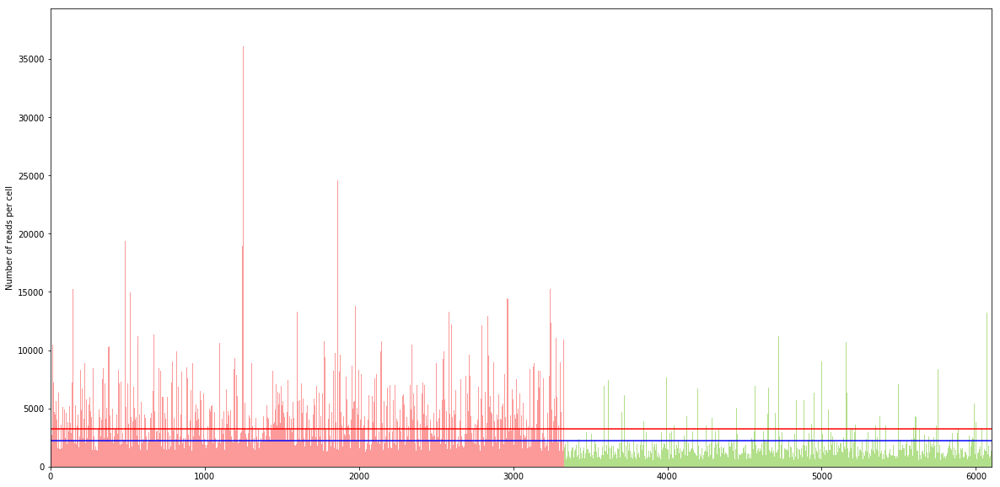

In [32]:
draw_barplots_QC(seq,'reads',cells_stage,{'5w':'#fb9a99','9w':'#b2df8a'})

In [33]:
sf = pd.Series(loadData_v1(path_output, exp_id, 'sf', 'DataFrame'))
sf.index = [ix.replace('.','-') for ix in sf.index]

### Remove cells with size factor <= 0 (low quality cells) and normalize data

In [34]:
np.sum(sf<=0)

3

In [35]:
col_sel = sf[sf>0].index

In [36]:
len(col_sel)

6097

In [37]:
seqN = seq[col_sel] / sf[col_sel]

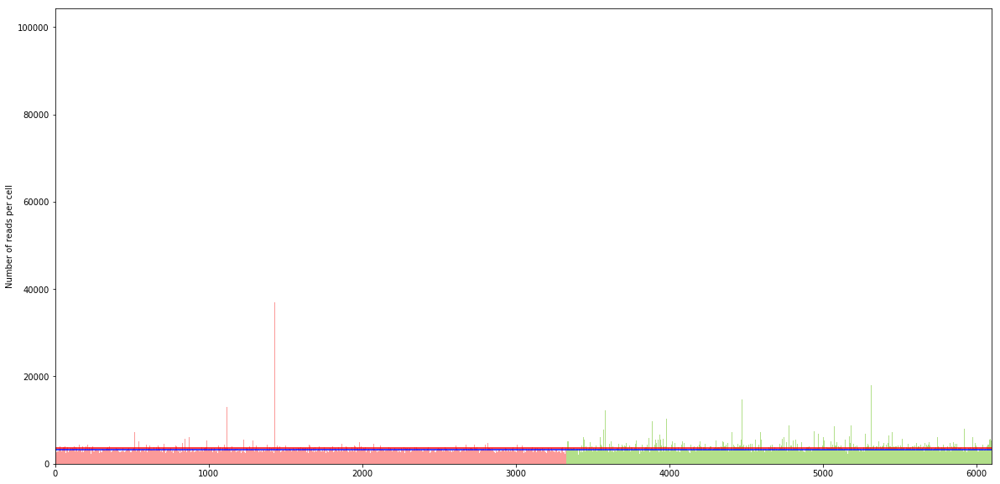

In [38]:
draw_barplots_QC(seqN,'reads',cells_stage,{'5w':'#fb9a99','9w':'#b2df8a'})

### Checkpoint

In [39]:
#saveData_v1(seqN, path_output, exp_id, 'seqN')

In [14]:
seqN = loadData_v1(path_output, exp_id, 'seqN', 'DataFrame')

# 1st level clustering with Affinity Propagation

## Feature selection

In [41]:
seq_1st = dropNull_v2X(seqN, path_input, cutoff_mean = 0.00)


Dropping unexpressed genes from dataset


In [42]:
len(seq_1st.index)

17771

In [43]:
len(seq_1st.columns)

6097


Dropping unexpressed genes from dataset

After mean expression cutoff of 0.025, 9054 genes remain

After high variance feature selection, 2500 genes remain


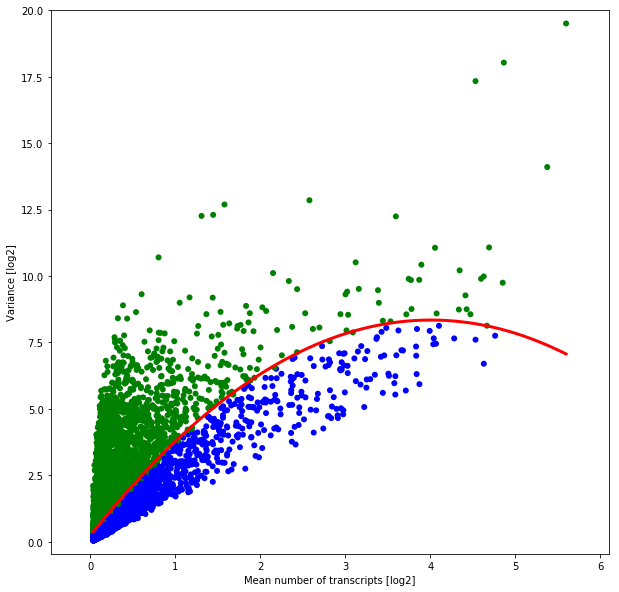

In [44]:
seq_sel_1st = select_features_log2_var_polyfit_v2(seq_1st, 0.025, 2500)

### Checkpoint

In [45]:
#saveData_v1(seq_sel_1st, path_output, exp_id, 'seq_sel_1st')

In [13]:
seq_sel_1st = loadData_v1(path_output, exp_id, 'seq_sel_1st', 'DataFrame')

## Dimensionality reduction with PCA

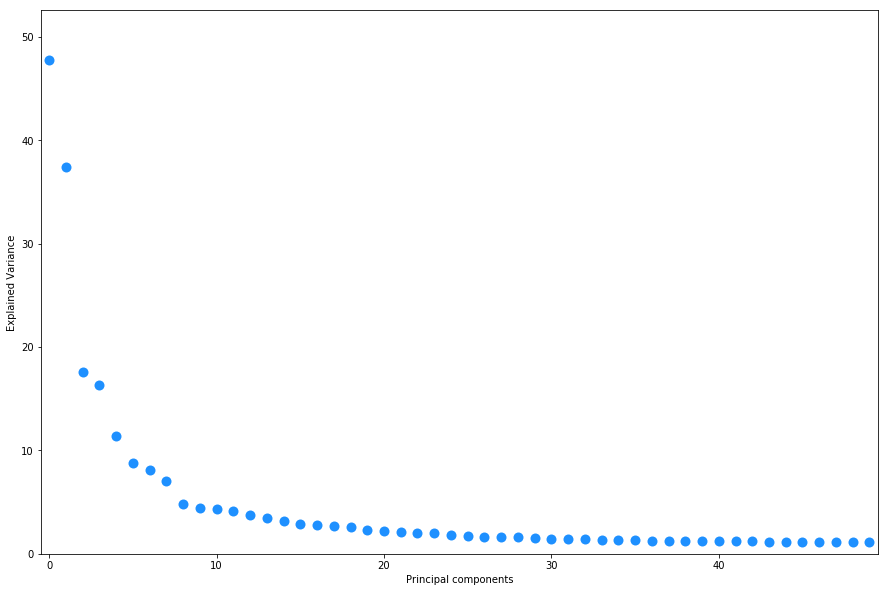

In [47]:
pca_explained_var(seq_sel_1st)

In [48]:
seq_sel_1st_pca, dist_c_1st = dim_reduc_pca(seq_sel_1st, 30, 'euclidean', inverse_transform = False)

In [49]:
aff_c_1st = - dist_c_1st

## Umap embedding of PCs

In [14]:
scdata_1st = to_scanpy(seq_sel_1st)

In [54]:
sc.pp.pca(scdata_1st, n_comps = 30)

In [55]:
sc.pp.neighbors(scdata_1st, n_neighbors=25, n_pcs=30, method = 'umap')

/Users/simjoo/anaconda/lib/python3.6/site-packages/scanpy/neighbors/__init__.py:123: RuntimeWarning: invalid value encountered in sqrt
  distances = np.sqrt(distances)


In [56]:
sc.tl.umap(scdata_1st, min_dist= 1, spread = 10)

/Users/simjoo/anaconda/lib/python3.6/site-packages/scanpy/neighbors/umap/umap_.py:1173: RuntimeWarning: divide by zero encountered in power
  return 1.0 / (1.0 + a * x ** (2 * b))


In [57]:
umap_1st = pd.DataFrame(scdata_1st.obsm['X_umap'], index = scdata_1st.obs['CellID'], columns = ['x','y'])

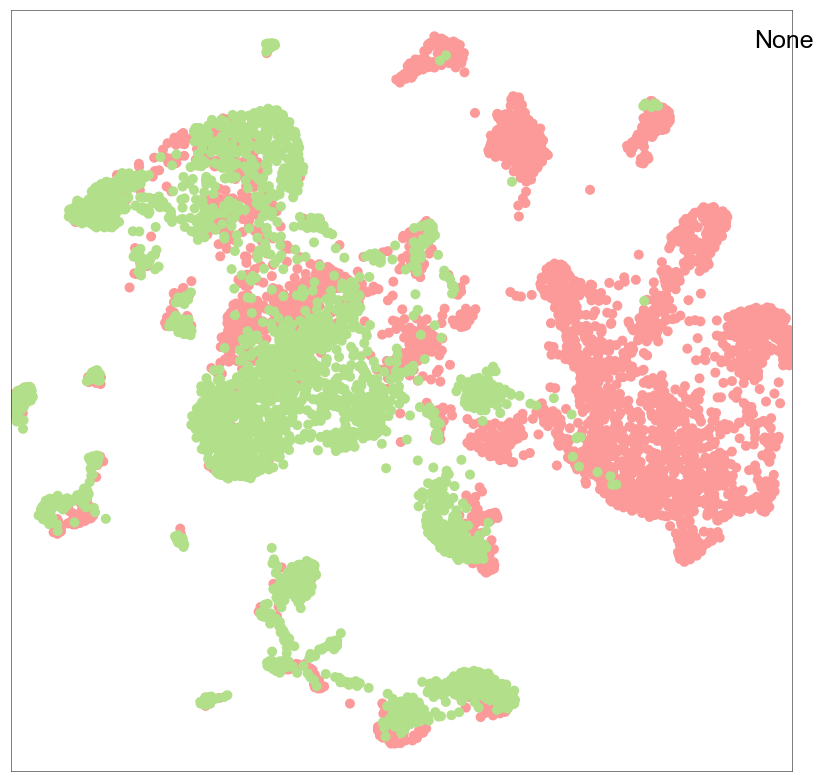

In [61]:
draw_tSNE(umap_1st, cells_stage, number = None, cmap = {'5w':'#fb9a99','9w':'#b2df8a'})

## Cell clustering

In [62]:
cl_c_1st_AP =  AP_clustering_v4P(aff_c_1st, 0, -500, 0.9)

In [63]:
len(set(cl_c_1st_AP))

20

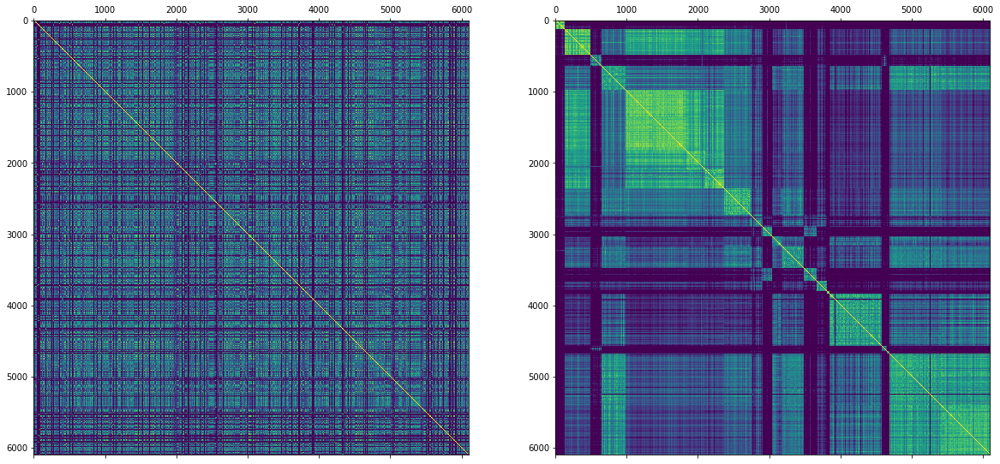

In [67]:
draw_AP_dist_mat(aff_c_1st, cl_c_1st_AP, cmap = plt.cm.viridis, vmin = -25.0, vmax = 0.0)

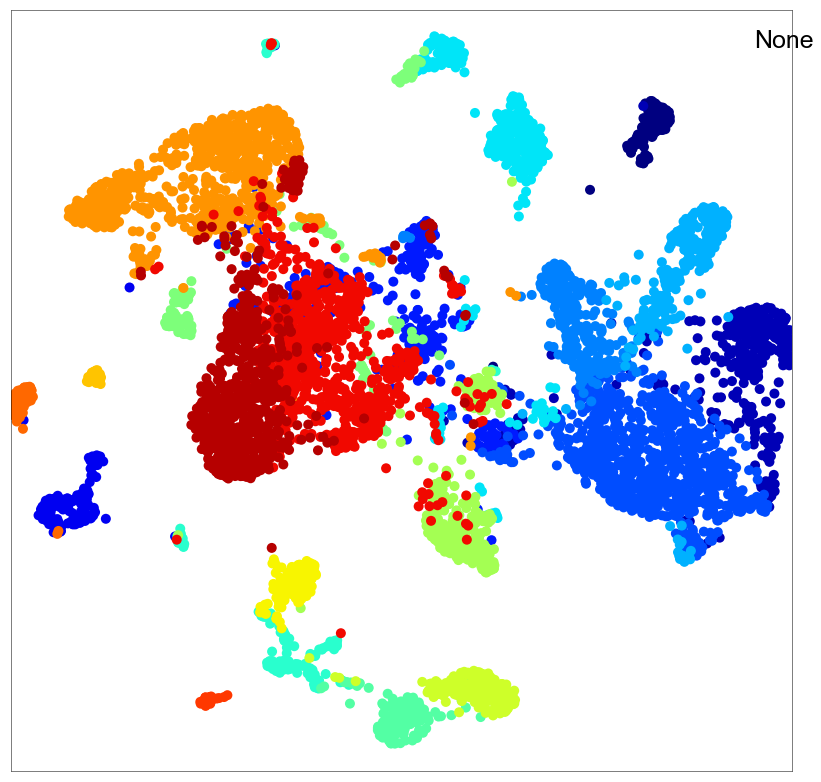

In [68]:
draw_tSNE(umap_1st, cl_c_1st_AP, number = None, cmap = plt.cm.jet)

## Consolidate clustering and tSNE by reassigning cluster outliers (less then 10 of 50 nearest neighbors in tSNE assigned to same cluster)

In [71]:
dist_1st_ts = eucl_2d(umap_1st.loc[cl_c_1st_AP.index])

In [72]:
cl_c_1st_AP = smooth_clustering(dist_1st_ts, cl_c_1st_AP, 50, 10)

336/6097 cells reassigned!


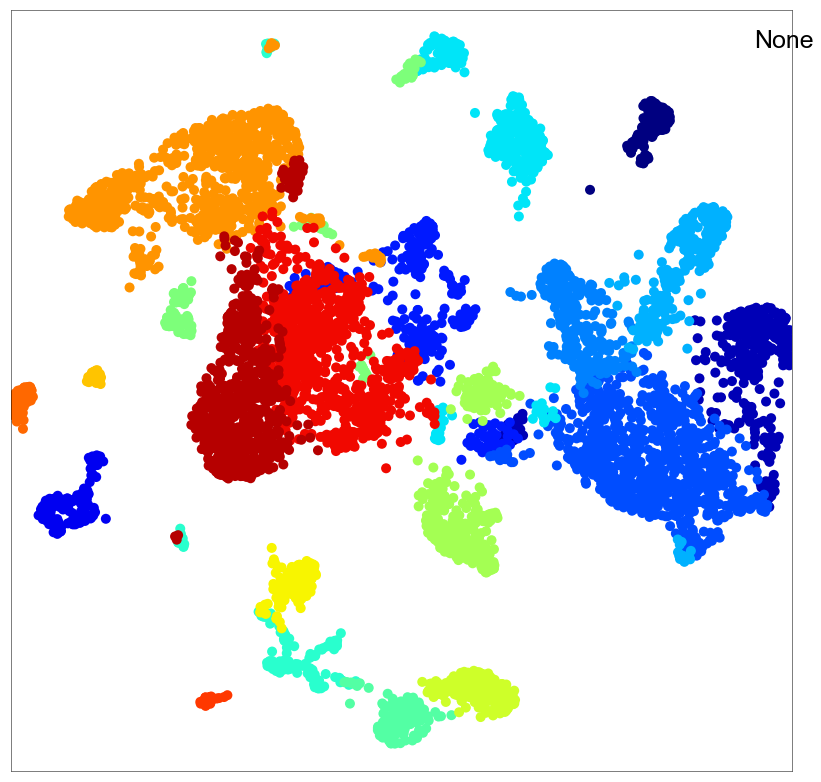

In [73]:
draw_tSNE(umap_1st, cl_c_1st_AP, number = None, cmap = plt.cm.jet)

### Checkpoint

In [74]:
#saveData_v1(umap_1st, path_output, exp_id, 'umap_1st')
#saveData_v1(cl_c_1st_AP, path_output, exp_id, 'cl_c_1st_AP')

In [75]:
umap_1st = loadData_v1(path_output, exp_id, 'umap_1st','DataFrame')
cl_c_1st_AP = loadData_v1(path_output, exp_id, 'cl_c_1st_AP','Series')

## Combine clusters according to main compartments (EPI: permanent epidermis, ANA: anagen HF, FIB: fibroblast-like, IMM: immune cells, VASC: vascular cells, MEL: melanocytes)

In [76]:
cl_c_1st_AP_sel = pd.Series('None', index = cl_c_1st_AP.index)

c_sel_EPI = cl_c_1st_AP[cl_c_1st_AP.isin([3,8,10,11,15,18,19])].index
cl_c_1st_AP_sel[c_sel_EPI] = 'EPI'

c_sel_ANA = cl_c_1st_AP[cl_c_1st_AP.isin([1,4,5,6,7])].index
cl_c_1st_AP_sel[c_sel_ANA] = 'ANA'

c_sel_FIB = cl_c_1st_AP[cl_c_1st_AP.isin([9,12])].index
cl_c_1st_AP_sel[c_sel_FIB] = 'FIB'

c_sel_IMM = cl_c_1st_AP[cl_c_1st_AP.isin([2,16,14])].index
cl_c_1st_AP_sel[c_sel_IMM] = 'IMM'

c_sel_VASC = cl_c_1st_AP[cl_c_1st_AP.isin([13])].index
cl_c_1st_AP_sel[c_sel_VASC] = 'VASC'

c_sel_MEL = cl_c_1st_AP[cl_c_1st_AP.isin([0,17])].index
cl_c_1st_AP_sel[c_sel_MEL] = 'MEL'

In [77]:
Counter(cl_c_1st_AP_sel)

Counter({'MEL': 163,
         'ANA': 2081,
         'IMM': 258,
         'EPI': 3135,
         'FIB': 316,
         'VASC': 144})

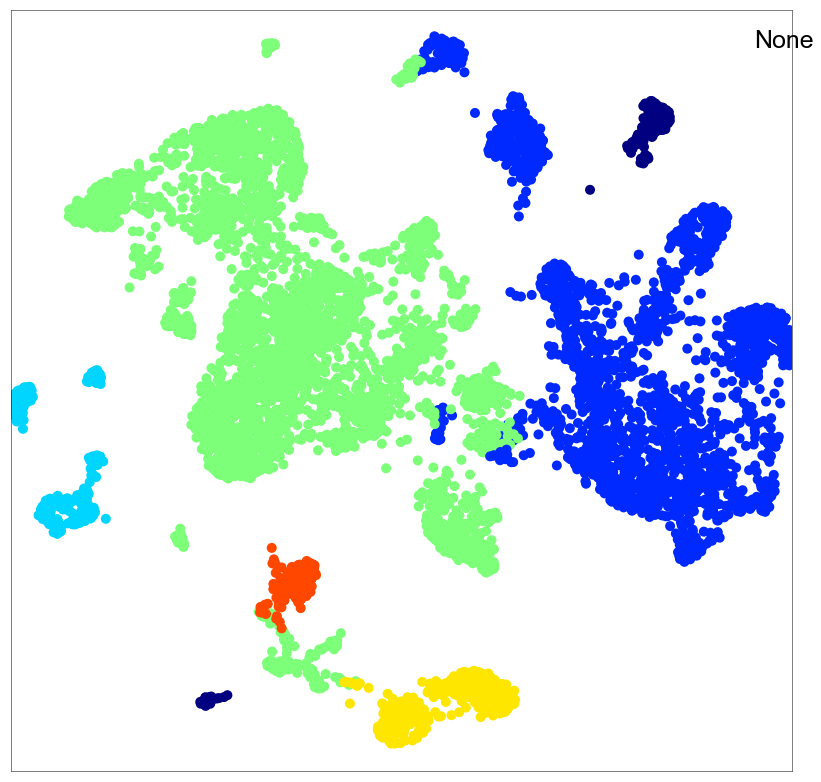

In [78]:
draw_tSNE(umap_1st, cl_c_1st_AP_sel, number = None, cmap = plt.cm.jet)

### Checkpoint

In [79]:
#saveData_v1(cl_c_1st_AP_sel, path_output, exp_id, 'cl_c_1st_AP_sel')

In [80]:
cl_c_1st_AP_sel = loadData_v1(path_output, exp_id, 'cl_c_1st_AP_sel','Series')

# 1st level clustering with Seurat

## Import clustering data and tSNE

In [81]:
cl_c_1st_S = pd.read_csv('%s/Seurat/TenX_Skin_1stLevel_Tsne_35PCs_30Perplexity_resolutions_1-2_ClusterIdentity.txt' % path_output, 
                         sep = '\t', header = None, index_col = 0, low_memory = False, squeeze = True)

In [82]:
cl_c_1st_S = AP_groups_reorder_v2(cl_c_1st_S, range(len(set(cl_c_1st_S))))

In [83]:
len(cl_c_1st_S)

6098

In [84]:
tsne_1st_S = pd.read_csv('%s/Seurat/TenX_Skin_1stLevel_Tsne_35PCs_30Perplexity_resolutions_1-2_TSNEcoordinates.txt' % path_output, 
                         sep = '\t', index_col = 0, header = 0)
tsne_1st_S.columns = ['x','y']

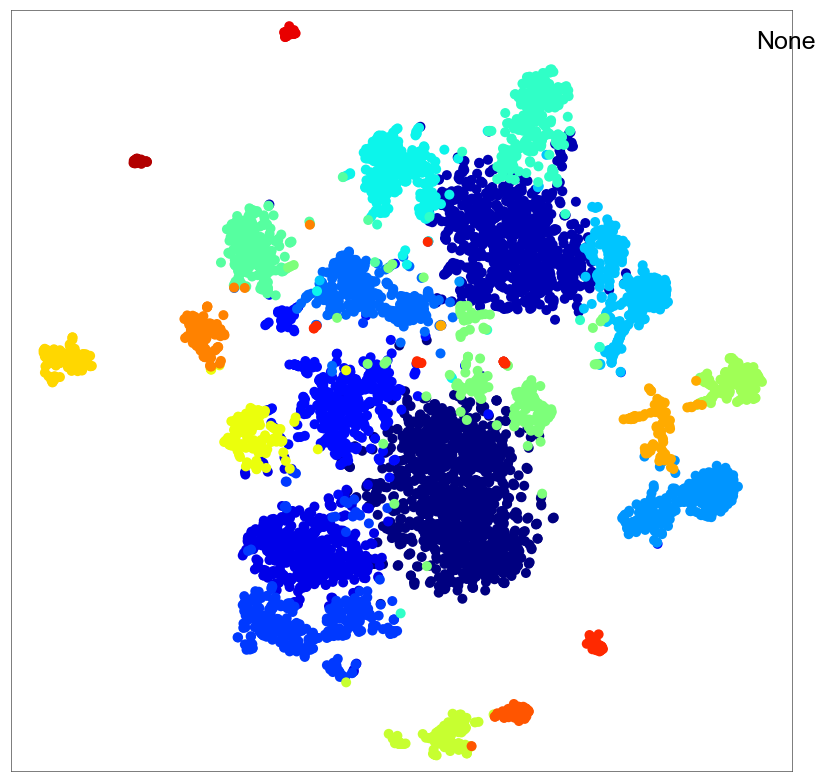

In [85]:
draw_tSNE(tsne_1st_S, cl_c_1st_S, number = None, cmap = plt.cm.jet, pad = 2)

## Compare AP and Seurat

In [86]:
c_sel = list(set(cl_c_1st_AP.index) & set(cl_c_1st_S.index))

In [87]:
len(c_sel)

6095

In [88]:
seurat_vs_AP_1st = seurat_vs_AP(cl_c_1st_S[c_sel], cl_c_1st_AP[c_sel])

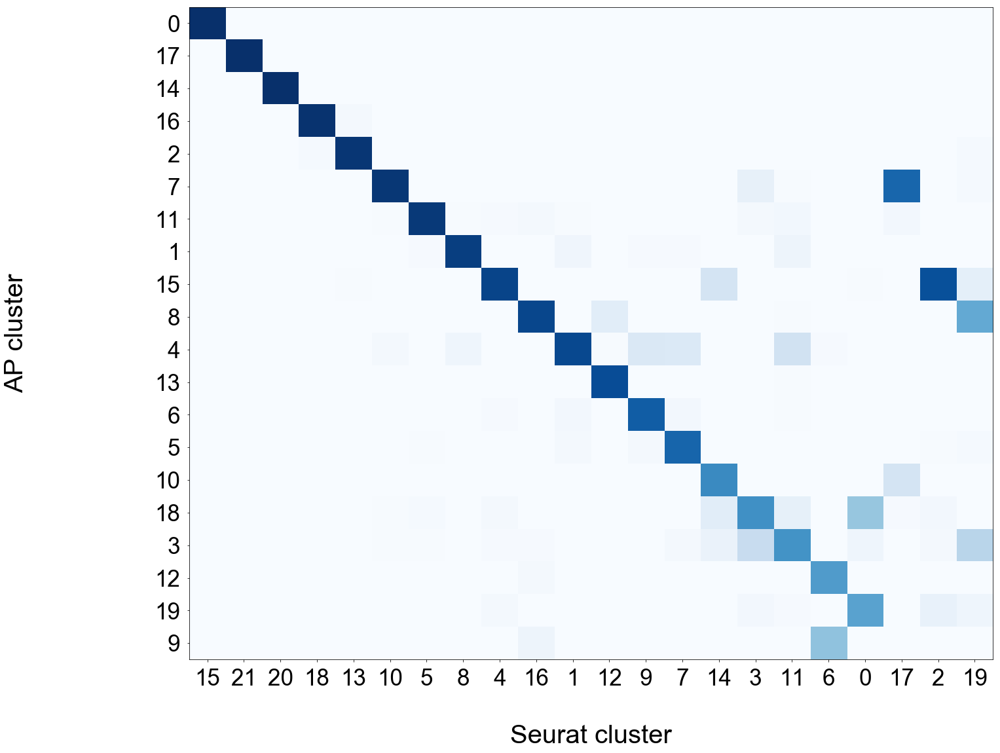

In [89]:
data = seurat_vs_AP_1st

#generate figure

fig = plt.figure(facecolor = 'w', figsize = (len(data.columns), len(data.index)))
gs = plt.GridSpec(nrows = 2, ncols = 1, wspace=0.0, hspace=0.0, height_ratios=[1.0, 11.0])

#generate plot

ax = plt.subplot(gs[1])

#generate xaxis

ax.set_xlim(-0.5, len(data.columns) - 0.5)
ax.set_xticks(np.arange(0, len(data.columns)))
ax.set_xticklabels([c for c in data.columns], family = 'Arial', fontsize = 35)
ax.set_xlabel('Seurat cluster', family = 'Arial', fontsize = 40)
ax.xaxis.set_label_coords(0.5, -0.1)
ax.tick_params(axis='x', which='major', pad=10)

#generate yaxis

ax.set_ylim(len(data.index) -0.5, -0.5)
ax.set_yticks(np.arange(0, len(data.index)))
ax.set_yticklabels([ix for ix in data.index], family = 'Arial', fontsize = 35)
ax.set_ylabel('AP cluster', family = 'Arial', fontsize = 40)
ax.yaxis.set_label_coords(-0.2, 0.5)
ax.tick_params(axis='y', which='major', pad=10)

#plot data

ax.imshow(data.astype(float),
          cmap = plt.cm.Blues,
          aspect = 'auto',
          interpolation = 'nearest',
          vmin = 0, vmax = 1)

## Combine clusters according to main compartments (EPI: permanent epidermis, ANA: anagen HF, FIB: fibroblast-like, IMM: immune cells, VASC: vascular cells, MEL: melanocytes)

In [90]:
#consider only the cells which passed both the Seurat QC and were included in the scran normalized data

c_sel = [c for c in cl_c_1st_S.index if c in seqN.columns]

In [91]:
len(c_sel)

6095

In [92]:
cl_c_1st_S_sel = pd.Series('None', index = c_sel)

cl_c_1st_S_sel[cl_c_1st_S.isin([0,2,3,4,5,11,14])] = 'EPI'
cl_c_1st_S_sel[cl_c_1st_S.isin([1,7,8,9,10,17])] = 'ANA'
cl_c_1st_S_sel[cl_c_1st_S.isin([6,16])] = 'FIB'
cl_c_1st_S_sel[cl_c_1st_S.isin([13,18,19])] = 'IMM'
cl_c_1st_S_sel[cl_c_1st_S.isin([12])] = 'VASC'
cl_c_1st_S_sel[cl_c_1st_S.isin([15,21])] = 'MEL'
cl_c_1st_S_sel[cl_c_1st_S.isin([20])] = 'MISC'

In [93]:
Counter(cl_c_1st_S_sel)

Counter({'EPI': 3000,
         'ANA': 2013,
         'FIB': 435,
         'VASC': 161,
         'IMM': 286,
         'MEL': 163,
         'MISC': 37})

In [94]:
len(cl_c_1st_S_sel)

6095

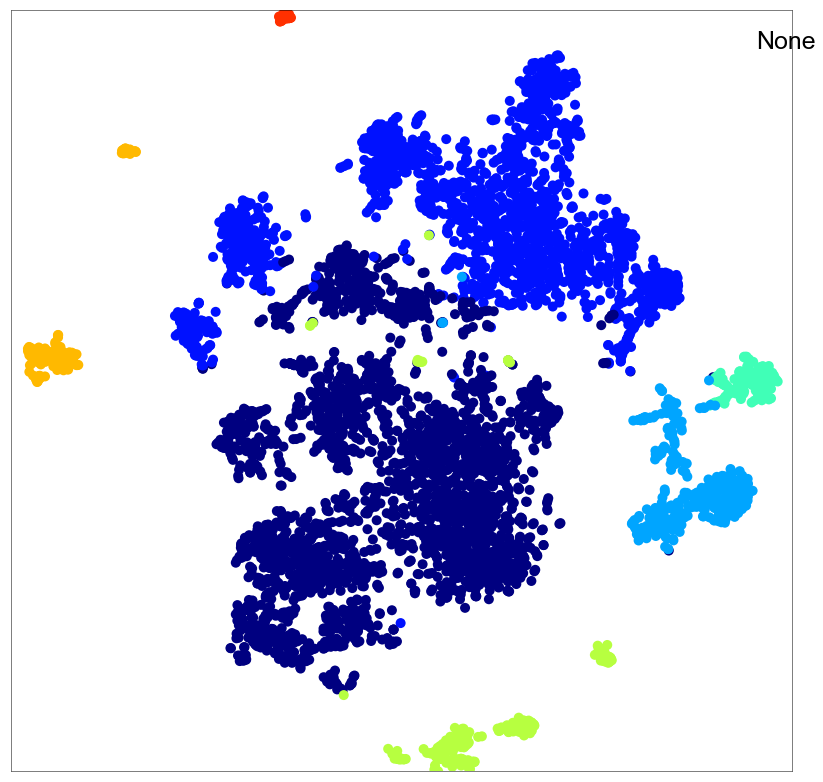

In [95]:
draw_tSNE(tsne_1st_S, cl_c_1st_S_sel, number = None, cmap = plt.cm.jet)

### Checkpoint

In [96]:
#saveData_v1(cl_c_1st_S_sel, path_output, exp_id, 'cl_c_1st_S_sel')

In [97]:
cl_c_1st_S_sel = loadData_v1(path_output, exp_id, 'cl_c_1st_S_sel','Series')

## Compare AP and Seurat (fused clusters)

In [98]:
seurat_vs_AP_1st_sel = seurat_vs_AP(cl_c_1st_S_sel[c_sel], cl_c_1st_AP_sel[c_sel])

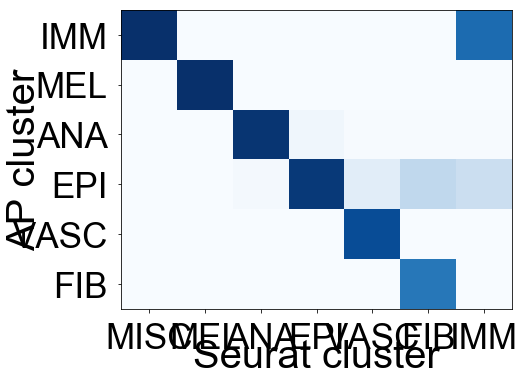

In [99]:
data = seurat_vs_AP_1st_sel

#generate figure

fig = plt.figure(facecolor = 'w', figsize = (len(data.columns), len(data.index)))
gs = plt.GridSpec(nrows = 2, ncols = 1, wspace=0.0, hspace=0.0, height_ratios=[1.0, 11.0])

#generate plot

ax = plt.subplot(gs[1])

#generate xaxis

ax.set_xlim(-0.5, len(data.columns) - 0.5)
ax.set_xticks(np.arange(0, len(data.columns)))
ax.set_xticklabels([c for c in data.columns], family = 'Arial', fontsize = 35)
ax.set_xlabel('Seurat cluster', family = 'Arial', fontsize = 40)
ax.xaxis.set_label_coords(0.5, -0.1)
ax.tick_params(axis='x', which='major', pad=10)

#generate yaxis

ax.set_ylim(len(data.index) -0.5, -0.5)
ax.set_yticks(np.arange(0, len(data.index)))
ax.set_yticklabels([ix for ix in data.index], family = 'Arial', fontsize = 35)
ax.set_ylabel('AP cluster', family = 'Arial', fontsize = 40)
ax.yaxis.set_label_coords(-0.2, 0.5)
ax.tick_params(axis='y', which='major', pad=10)

#plot data

ax.imshow(data.astype(float),
          cmap = plt.cm.Blues,
          aspect = 'auto',
          interpolation = 'nearest',
          vmin = 0, vmax = 1)

# Use Seurat 1st level clustering + tSNE as it provides a more crisp overview over the main sources of hetereogenity in the data. 

In [100]:
cl_c_1st = cl_c_1st_S_sel

In [101]:
Counter(cl_c_1st)

Counter({'EPI': 3000,
         'ANA': 2013,
         'FIB': 435,
         'VASC': 161,
         'IMM': 286,
         'MEL': 163,
         'MISC': 37})

In [102]:
tsne_1st = tsne_1st_S.loc[cl_c_1st.index]

In [103]:
cmap_1st = {'EPI':'#1b9e77',
            'ANA':'#d95f02',
            'FIB':'#7570b3',
            'IMM':'#e7298a',
            'VASC':'#66a61e',
            'MEL':'#e6ab02',
            'MISC':'#666666'}

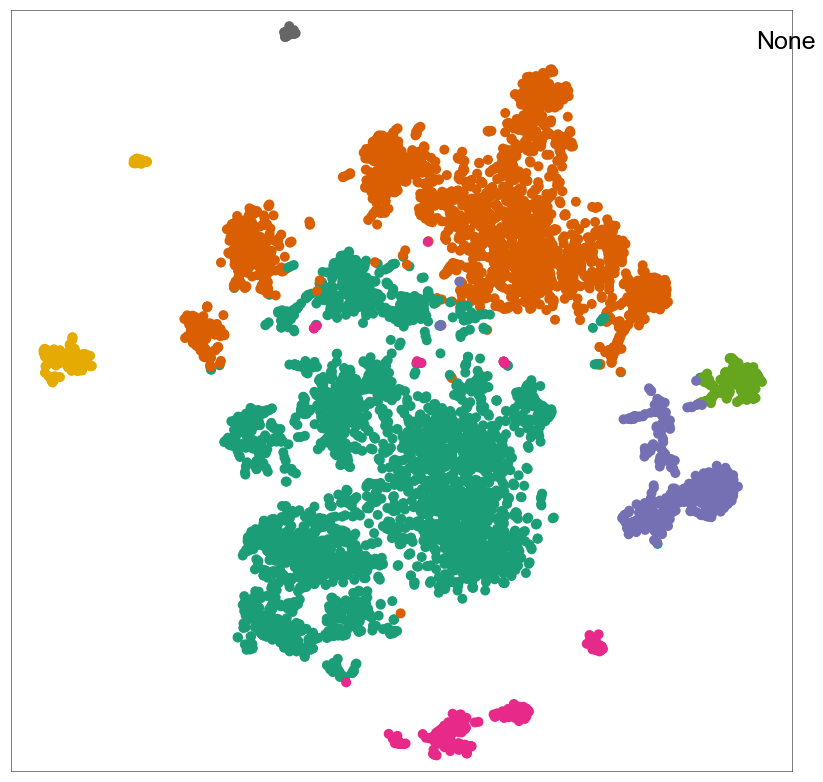

In [104]:
draw_tSNE(tsne_1st, cl_c_1st, number = None, cmap = cmap_1st, pad = 2)

In [105]:
cl_c_1st = AP_order_incluster(dist_c_1st.loc[cl_c_1st.index, cl_c_1st.index], cl_c_1st, method='ward', metric='euclidean')

In [106]:
cl_c_1st = AP_groups_reorder_v2(cl_c_1st, ['EPI','ANA','FIB','IMM','VASC','MEL','MISC'])

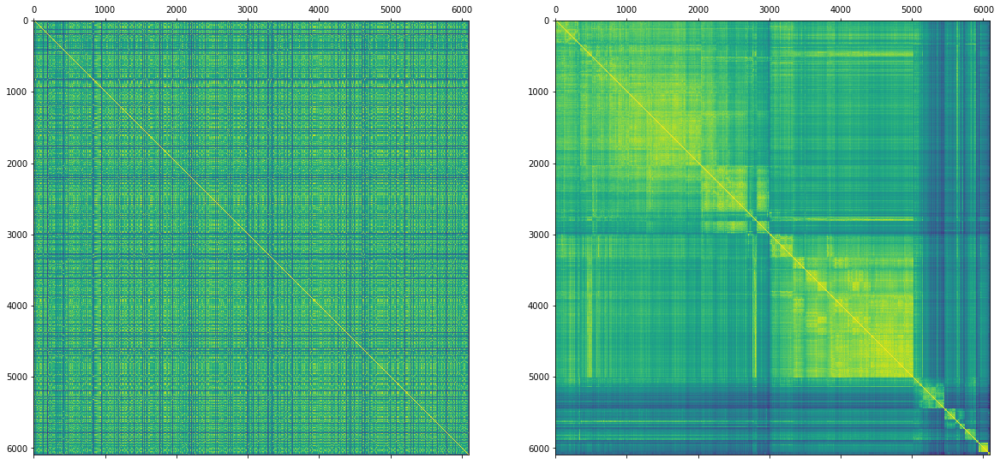

In [107]:
draw_AP_dist_mat(dist_c_1st.loc[cl_c_1st.index, cl_c_1st.index], cl_c_1st, cmap = plt.cm.viridis_r, vmin = 0, vmax = 50.0)

### Checkpoint

In [108]:
#saveData_v1(cl_c_1st, path_output, exp_id, 'cl_c_1st')
#saveData_v1(tsne_1st, path_output, exp_id, 'tsne_1st')

In [109]:
cl_c_1st = loadData_v1(path_output, exp_id, 'cl_c_1st', 'Series')
tsne_1st = loadData_v1(path_output, exp_id, 'tsne_1st', 'Series')

# Epidermis (permanent) subclustering with Affinity Propagation

## Remove doublets of keratinocytes and immune cells based on known immune markers (n=74)

In [110]:
c_sel_EPI = cl_c_1st[cl_c_1st=='EPI'].index

In [113]:
c_rem_EPI = remove_cells(seqN[c_sel_EPI], 
                         ['Cd207','Cd74','Cd3e','Cd52','Cd83'], 
                         [2,25,2,2,2])

In [114]:
len(c_rem_EPI)

74

In [115]:
c_sel_EPI = [c for c in c_sel_EPI if c not in c_rem_EPI]

In [116]:
len(c_sel_EPI)

2926

## Feature selection


Dropping unexpressed genes from dataset

After mean expression cutoff of 0.025, 8062 genes remain

After high variance feature selection, 2500 genes remain


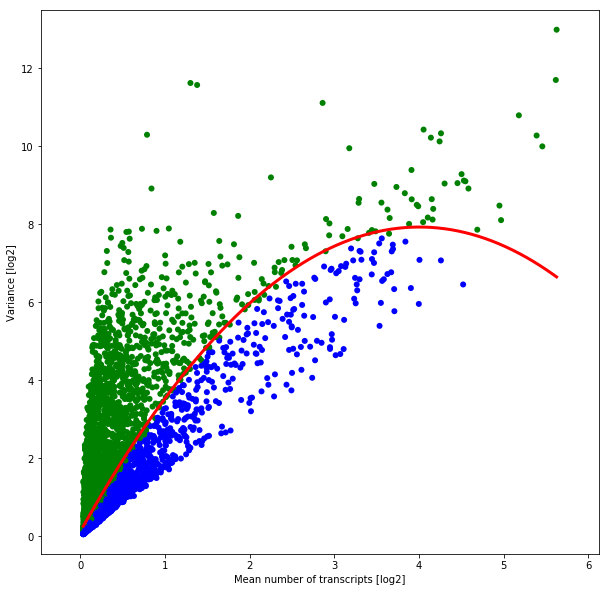

In [117]:
seq_sel_EPI = select_features_log2_var_polyfit_v2(seqN[c_sel_EPI], 0.025, 2500)

### Checkpoint

In [118]:
#saveData_v1(seq_sel_EPI, path_output, exp_id, 'seq_sel_EPI')

In [119]:
seq_sel_EPI = loadData_v1(path_output, exp_id, 'seq_sel_EPI', 'DataFrame')

## Dimensionality reduction with PCA

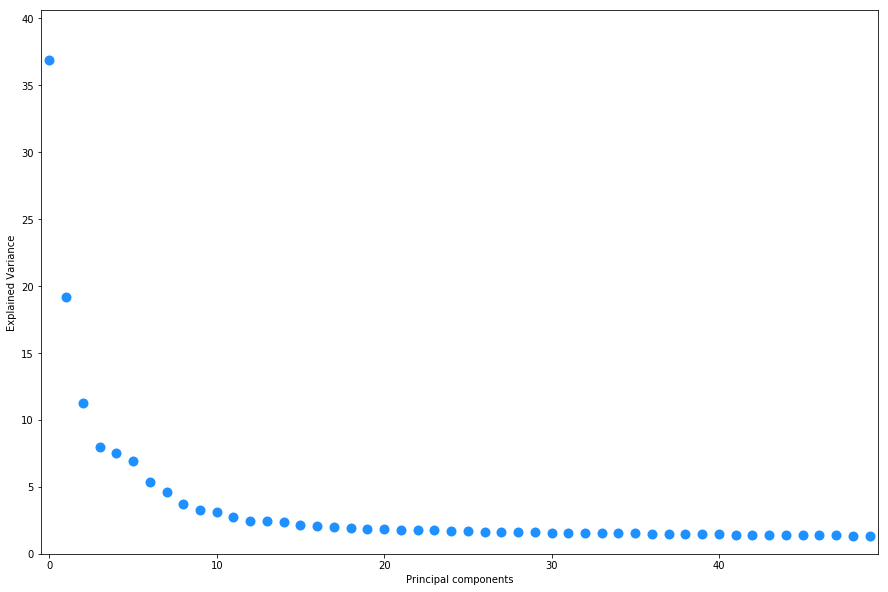

In [120]:
pca_explained_var(seq_sel_EPI)

In [121]:
seq_sel_EPI_pca, dist_c_EPI = dim_reduc_pca(seq_sel_EPI, 15, 'euclidean', inverse_transform = False)

In [122]:
aff_c_EPI = -dist_c_EPI

## Umap embedding of PCs

In [123]:
scdata_EPI = to_scanpy(seq_sel_EPI)

In [124]:
sc.pp.pca(scdata_EPI, n_comps = 15)

In [125]:
sc.pp.neighbors(scdata_EPI, n_neighbors=20, n_pcs=15, method = 'umap')

/Users/simjoo/anaconda/lib/python3.6/site-packages/scanpy/neighbors/__init__.py:123: RuntimeWarning: invalid value encountered in sqrt
  distances = np.sqrt(distances)


In [126]:
sc.tl.umap(scdata_EPI, min_dist= 1, spread = 5)

/Users/simjoo/anaconda/lib/python3.6/site-packages/scanpy/neighbors/umap/umap_.py:1173: RuntimeWarning: divide by zero encountered in power
  return 1.0 / (1.0 + a * x ** (2 * b))


In [127]:
umap_EPI = pd.DataFrame(scdata_EPI.obsm['X_umap'], index = scdata_EPI.obs['CellID'], columns = ['x','y'])

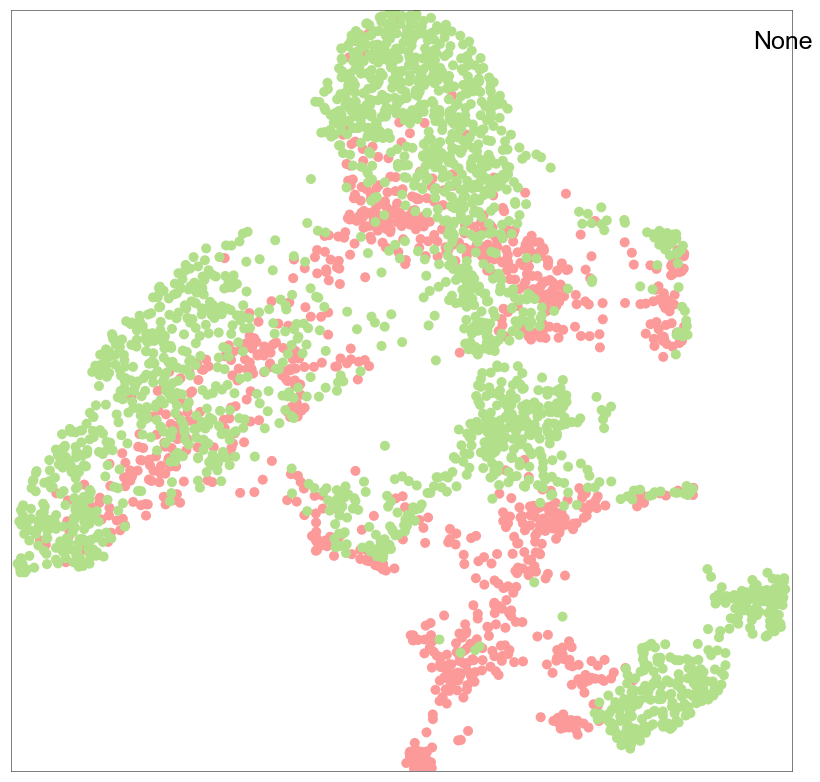

In [131]:
draw_tSNE(umap_EPI, cells_stage, number = None, cmap = {'5w':'#fb9a99','9w':'#b2df8a'})

## Cell clustering

In [132]:
cl_c_EPI_AP =  AP_clustering_v4P(aff_c_EPI, 0, -190, 0.75)

In [142]:
len(set(cl_c_EPI_AP))

16


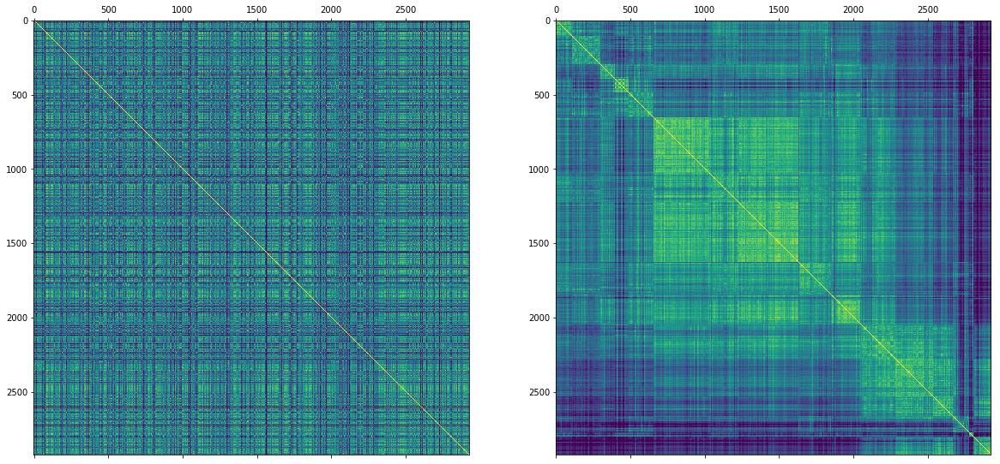

In [201]:
draw_AP_dist_mat(aff_c_EPI, cl_c_EPI_AP, cmap = plt.cm.viridis, vmin = -25.0, vmax = 0.0)

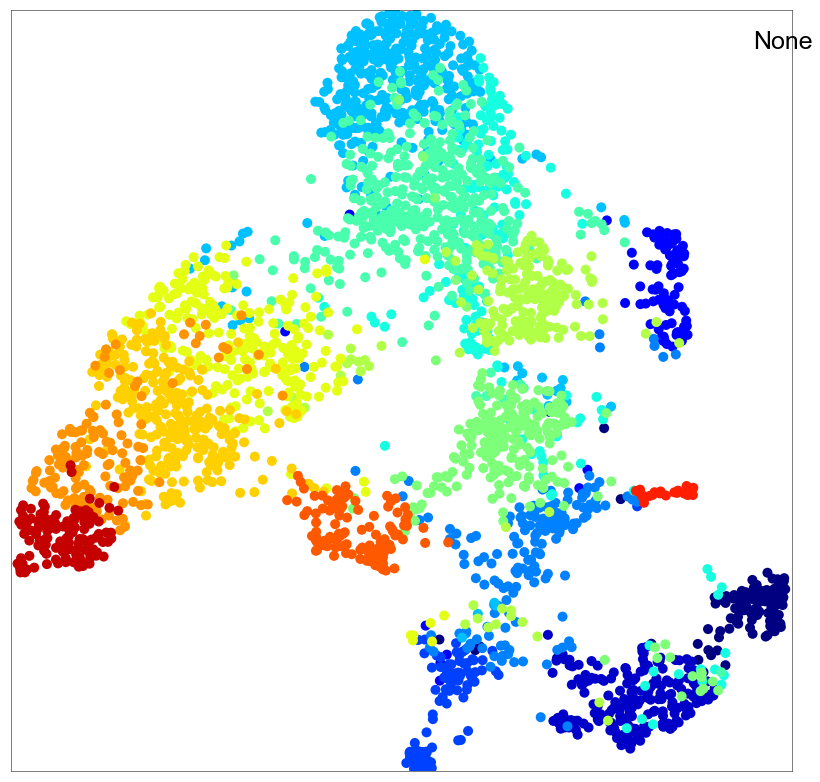

In [202]:
draw_tSNE(umap_EPI, cl_c_EPI_AP, number = None, cmap = plt.cm.jet)

## Consolidate clustering and tSNE by reassigning cluster outliers (less then 15 of 50 nearest neighbors in tSNE assigned to same cluster)

In [203]:
dist_EPI_ts = eucl_2d(umap_EPI.loc[cl_c_EPI_AP.index])

In [204]:
cl_c_EPI_AP = smooth_clustering(dist_EPI_ts, cl_c_EPI_AP, 50, 15)

402/2926 cells reassigned!


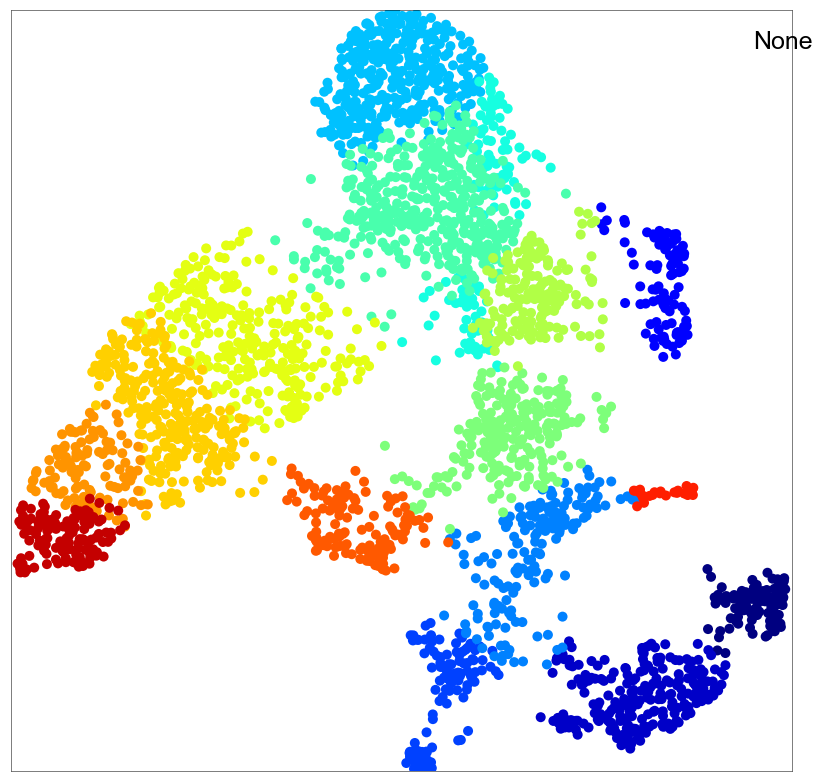

In [207]:
draw_tSNE(umap_EPI, cl_c_EPI_AP, number = None, cmap = plt.cm.jet)

## Cluster 3 shows clear anagen HF signatures and should be moved.

In [208]:
c_EPI_to_ANA = cl_c_EPI_AP[cl_c_EPI_AP==3].index

In [209]:
len(c_EPI_to_ANA)

115

In [210]:
cl_c_EPI_AP = cl_c_EPI_AP[~cl_c_EPI_AP.isin([3])]

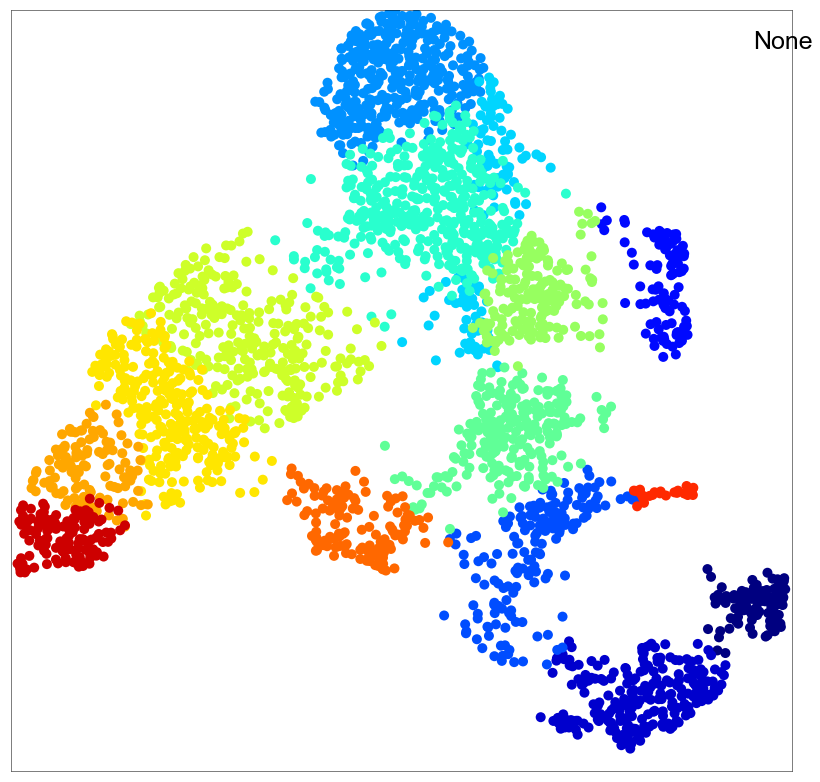

In [211]:
draw_tSNE(umap_EPI, cl_c_EPI_AP, number = None, cmap = plt.cm.jet)

### Checkpoint

In [143]:
#saveData_v1(umap_EPI, path_output, exp_id, 'umap_EPI')
#saveData_v1(cl_c_EPI_AP, path_output, exp_id, 'cl_c_EPI_AP')

In [144]:
umap_EPI = loadData_v1(path_output, exp_id, 'umap_EPI', 'DataFrame')
cl_c_EPI_AP = loadData_v1(path_output, exp_id, 'cl_c_EPI_AP', 'Series')

# Epidermis (permanent) subclustering with Seurat

## Import clustering data and tSNE

In [145]:
cl_c_EPI_S = pd.read_csv('%s/Seurat/TenX_2ndLevel_Epi_ClusterIdentity.txt' % path_output, sep = '\t', header = None, index_col = 0, 
                           low_memory = False, squeeze = True)

In [146]:
tsne_EPI_S = pd.read_csv('%s/Seurat/TenX_2ndLevel_EPI_TSNEcoordinates.txt' % path_output, sep = '\t', index_col = 0, header = 0)
tsne_EPI_S.columns = ['x','y']

In [147]:
c_sel = list(set(cl_c_EPI_S.index) & set(cl_c_EPI_AP.index))

In [148]:
cl_c_EPI_S = cl_c_EPI_S[c_sel]

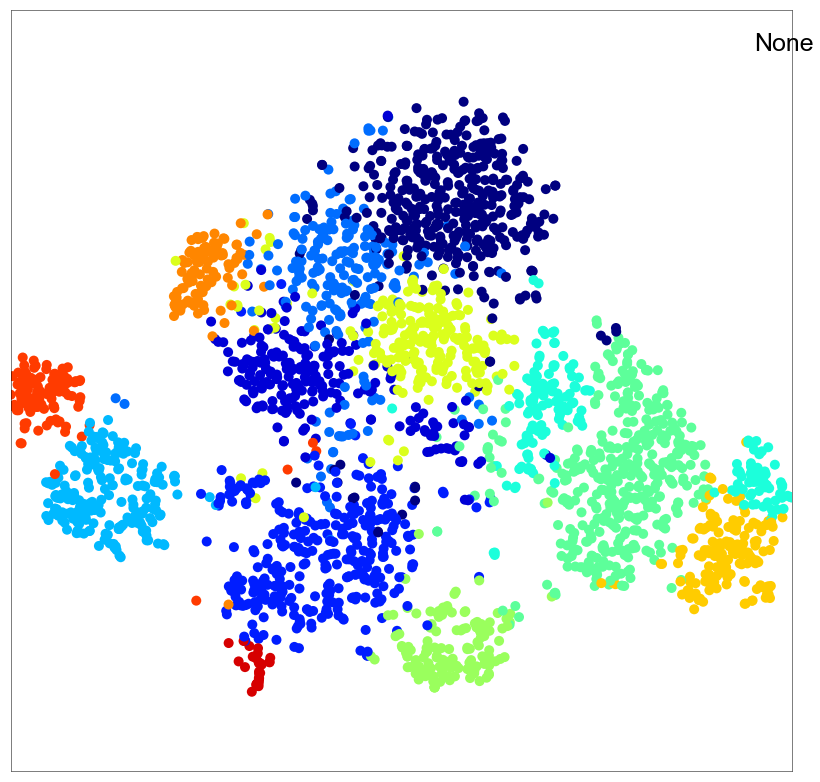

In [149]:
draw_tSNE(tsne_EPI_S, cl_c_EPI_S, number = None, cmap = plt.cm.jet)

## Compare AP and Seurat

In [150]:
seurat_vs_AP_EPI = seurat_vs_AP(cl_c_EPI_S[c_sel], cl_c_EPI_AP[c_sel])

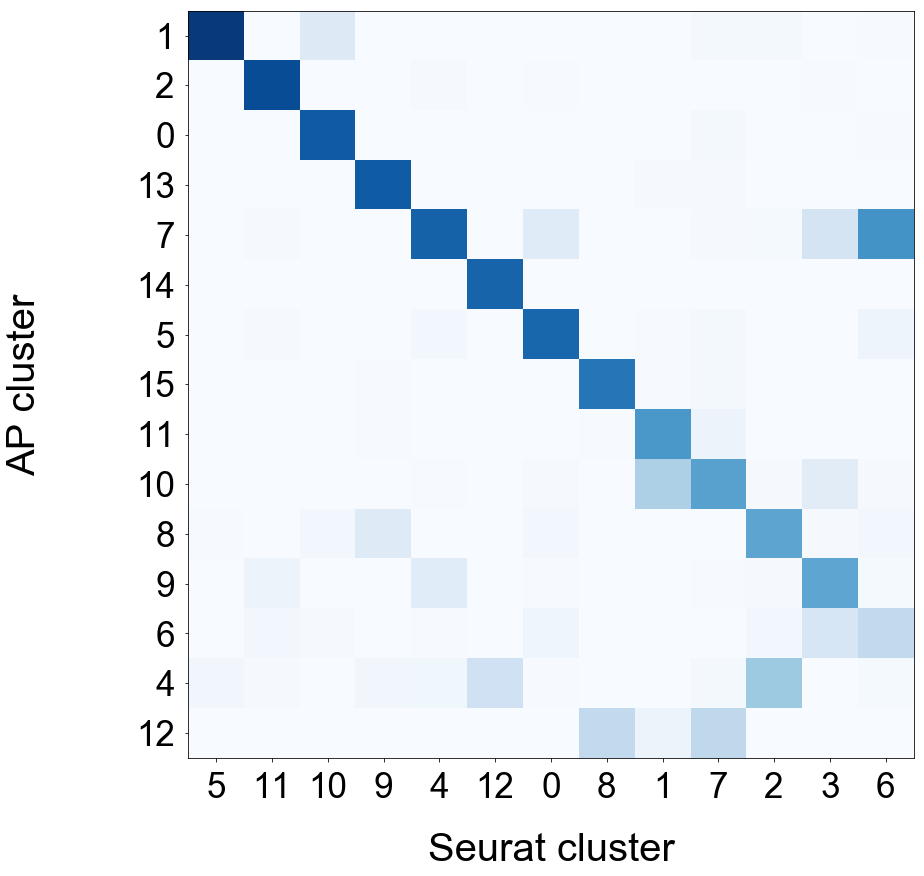

In [151]:
data = seurat_vs_AP_EPI

#generate figure

fig = plt.figure(facecolor = 'w', figsize = (len(data.columns), len(data.index)))
gs = plt.GridSpec(nrows = 2, ncols = 1, wspace=0.0, hspace=0.0, height_ratios=[1.0, 11.0])

#generate plot

ax = plt.subplot(gs[1])

#generate xaxis

ax.set_xlim(-0.5, len(data.columns) - 0.5)
ax.set_xticks(np.arange(0, len(data.columns)))
ax.set_xticklabels([c for c in data.columns], family = 'Arial', fontsize = 35)
ax.set_xlabel('Seurat cluster', family = 'Arial', fontsize = 40)
ax.xaxis.set_label_coords(0.5, -0.1)
ax.tick_params(axis='x', which='major', pad=10)

#generate yaxis

ax.set_ylim(len(data.index) -0.5, -0.5)
ax.set_yticks(np.arange(0, len(data.index)))
ax.set_yticklabels([ix for ix in data.index], family = 'Arial', fontsize = 35)
ax.set_ylabel('AP cluster', family = 'Arial', fontsize = 40)
ax.yaxis.set_label_coords(-0.2, 0.5)
ax.tick_params(axis='y', which='major', pad=10)

#plot data

ax.imshow(data.astype(float),
          cmap = plt.cm.Blues,
          aspect = 'auto',
          interpolation = 'nearest',
          vmin = 0, vmax = 1)

## Use AP EPI subclustering + Umap. To simply the clustering and facilitate downstream comparison of telogen and anagen cells in IFE basal, IFE suprabasal cells and uHF cells, fuse the IFE basal, IFE suprabasal and uHF basal subclusters

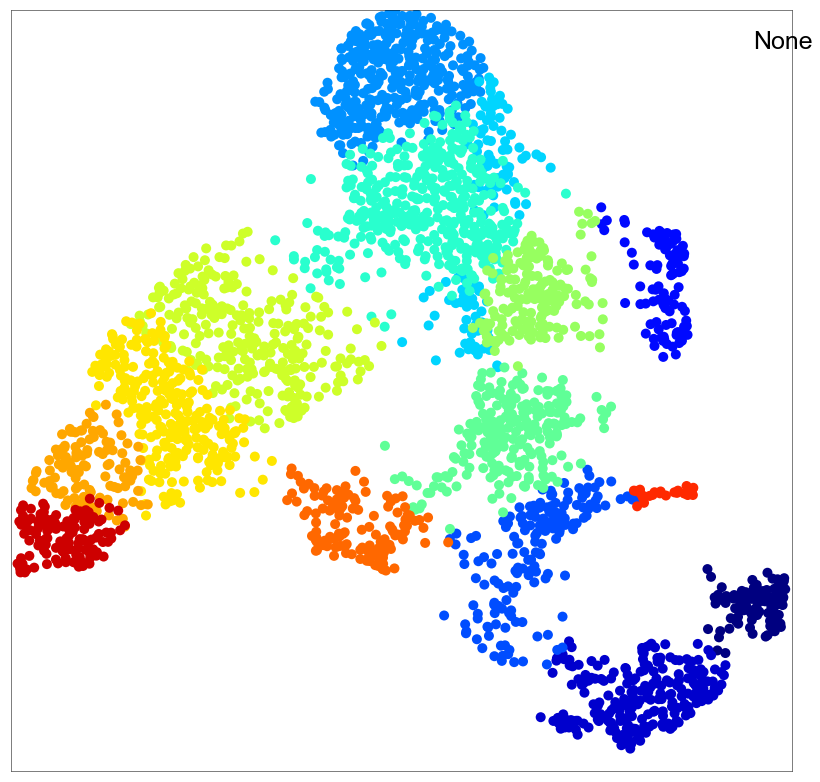

In [152]:
draw_tSNE(umap_EPI, cl_c_EPI_AP, number = None, cmap = plt.cm.jet)

In [153]:
cl_c_EPI = pd.Series('None', index = cl_c_EPI_AP.index)

cl_c_EPI[cl_c_EPI_AP.isin([2])] = 'EPI - 0'
cl_c_EPI[cl_c_EPI_AP.isin([5,6,7,9])] = 'EPI - 1'
cl_c_EPI[cl_c_EPI_AP.isin([10,11])] = 'EPI - 2'
cl_c_EPI[cl_c_EPI_AP.isin([12,15])] = 'EPI - 3'
cl_c_EPI[cl_c_EPI_AP.isin([4,8])] = 'EPI - 4'
cl_c_EPI[cl_c_EPI_AP.isin([13])] = 'EPI - 5'
cl_c_EPI[cl_c_EPI_AP.isin([14])] = 'EPI - 6'
cl_c_EPI[cl_c_EPI_AP.isin([1])] = 'EPI - 7'
cl_c_EPI[cl_c_EPI_AP.isin([0])] = 'EPI - 8'

In [154]:
Counter(cl_c_EPI)

Counter({'EPI - 8': 98,
         'EPI - 7': 234,
         'EPI - 0': 100,
         'EPI - 4': 397,
         'EPI - 1': 1054,
         'EPI - 2': 537,
         'EPI - 3': 236,
         'EPI - 5': 127,
         'EPI - 6': 28})

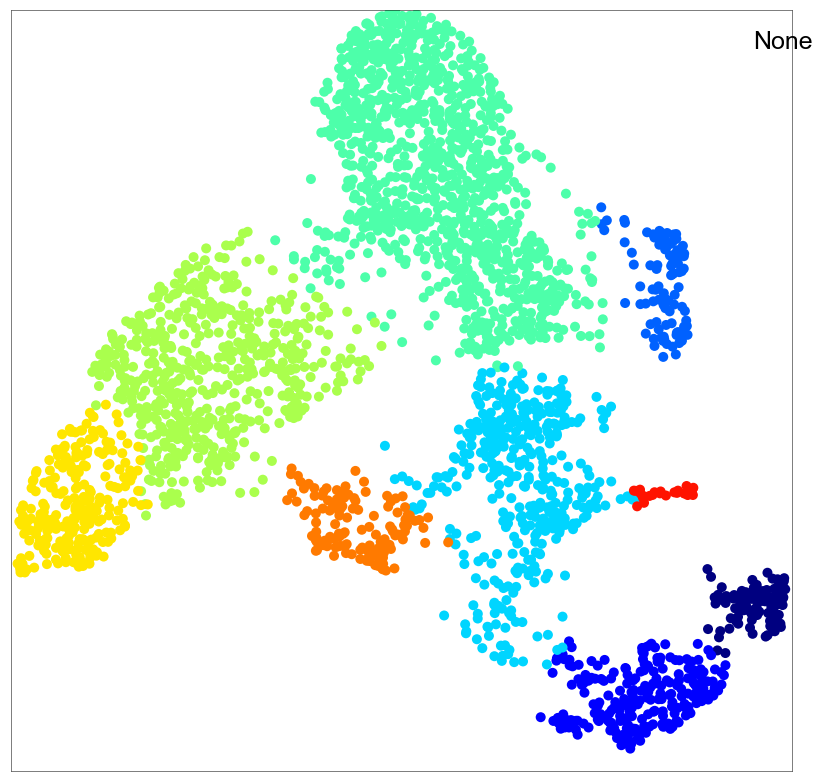

In [155]:
draw_tSNE(umap_EPI, cl_c_EPI, number = None, cmap = plt.cm.jet)

In [156]:
cmap_EPI = {'EPI - 0': '#276419',
            'EPI - 1': '#7fbc41',
            'EPI - 2': '#fdbf6f',
            'EPI - 3': '#ff7f00',
            'EPI - 4': '#cab2d6',
            'EPI - 5': '#6a3d9a',
            'EPI - 6': '#666666',
            'EPI - 7': '#1f78b4',
            'EPI - 8': '#a6cee3',
            'None':'silver'}

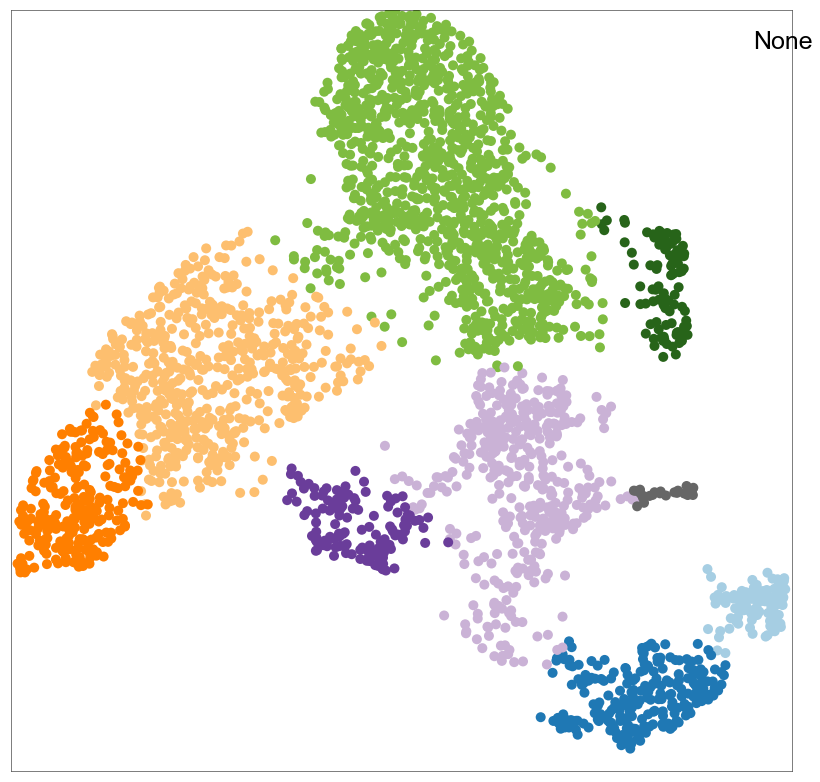

In [157]:
draw_tSNE(umap_EPI, cl_c_EPI, number = None, cmap = cmap_EPI)

In [158]:
cl_c_EPI = AP_order_incluster(dist_c_EPI.loc[cl_c_EPI.index, cl_c_EPI.index], cl_c_EPI, method='ward', metric='euclidean')

In [159]:
cl_c_EPI = AP_groups_reorder_v2(cl_c_EPI, ['EPI - 0','EPI - 1','EPI - 2','EPI - 3',
                                           'EPI - 4','EPI - 5','EPI - 6',
                                           'EPI - 7','EPI - 8'])

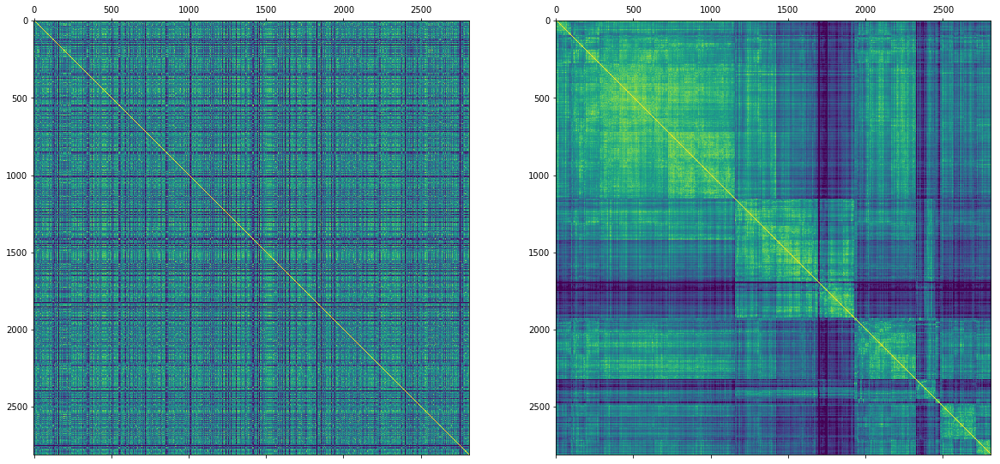

In [160]:
draw_AP_dist_mat(dist_c_EPI.loc[cl_c_EPI.index, cl_c_EPI.index], cl_c_EPI, cmap = plt.cm.viridis_r, vmin = 0, vmax = 25.0)

### Checkpoint

In [161]:
#saveData_v1(cl_c_EPI, path_output, exp_id, 'cl_c_EPI')

In [162]:
cl_c_EPI = loadData_v1(path_output, exp_id, 'cl_c_EPI', 'Series')

# Anagen HF subclustering with Affinity Propagation

## Remove doublets of keratinocytes and immune cells based on known immune markers (n=8)

In [928]:
c_sel_ANA = list(cl_c_1st[cl_c_1st=='ANA'].index) + list(c_EPI_to_ANA)

In [929]:
c_rem_ANA = remove_cells(seqN[c_sel_ANA], 
                         ['Cd207','Cd74','Cd3e','Cd52','Cd83'], 
                         [2,25,2,2,2])

In [930]:
len(c_rem_ANA)

8

In [931]:
c_sel_ANA = [c for c in c_sel_ANA if c not in c_rem_ANA]

In [932]:
len(c_sel_ANA)

2120

## Feature selection


Dropping unexpressed genes from dataset

After mean expression cutoff of 0.025, 7923 genes remain

After high variance feature selection, 2500 genes remain


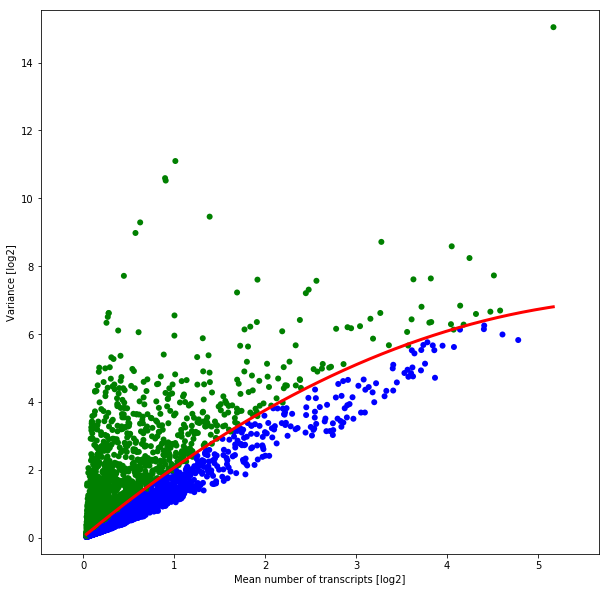

In [933]:
seq_sel_ANA = select_features_log2_var_polyfit_v2(seqN[c_sel_ANA], 0.025, 2500)

### Checkpoint

In [307]:
#saveData_v1(seq_sel_ANA, path_output, exp_id, 'seq_sel_ANA')

In [435]:
seq_sel_ANA = loadData_v1(path_output, exp_id, 'seq_sel_ANA', 'DataFrame')

## Dimensionality reduction with PCA

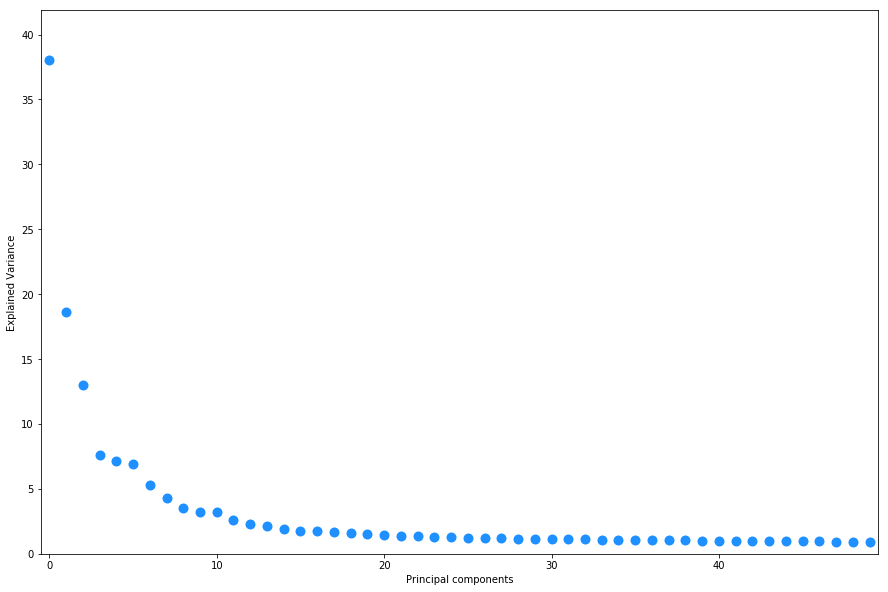

In [436]:
pca_explained_var(seq_sel_ANA)

In [437]:
seq_sel_ANA_pca, dist_c_ANA = dim_reduc_pca(seq_sel_ANA, 20, 'euclidean', inverse_transform = False)

In [438]:
aff_c_ANA = -dist_c_ANA

## Umap embedding of PCs

In [439]:
scdata_ANA = to_scanpy(seq_sel_ANA)

In [415]:
sc.pp.pca(scdata_ANA, n_comps = 20)

In [416]:
sc.pp.neighbors(scdata_ANA, n_neighbors=20, n_pcs=20, method = 'umap')

/Users/simjoo/anaconda/lib/python3.6/site-packages/scanpy/neighbors/__init__.py:123: RuntimeWarning: invalid value encountered in sqrt
  distances = np.sqrt(distances)


In [616]:
sc.tl.umap(scdata_ANA, min_dist= 0.5, spread = 6)

/Users/simjoo/anaconda/lib/python3.6/site-packages/scanpy/neighbors/umap/umap_.py:1173: RuntimeWarning: divide by zero encountered in power
  return 1.0 / (1.0 + a * x ** (2 * b))


In [617]:
umap_ANA = pd.DataFrame(scdata_ANA.obsm['X_umap'], index = scdata_ANA.obs['CellID'], columns = ['x','y'])

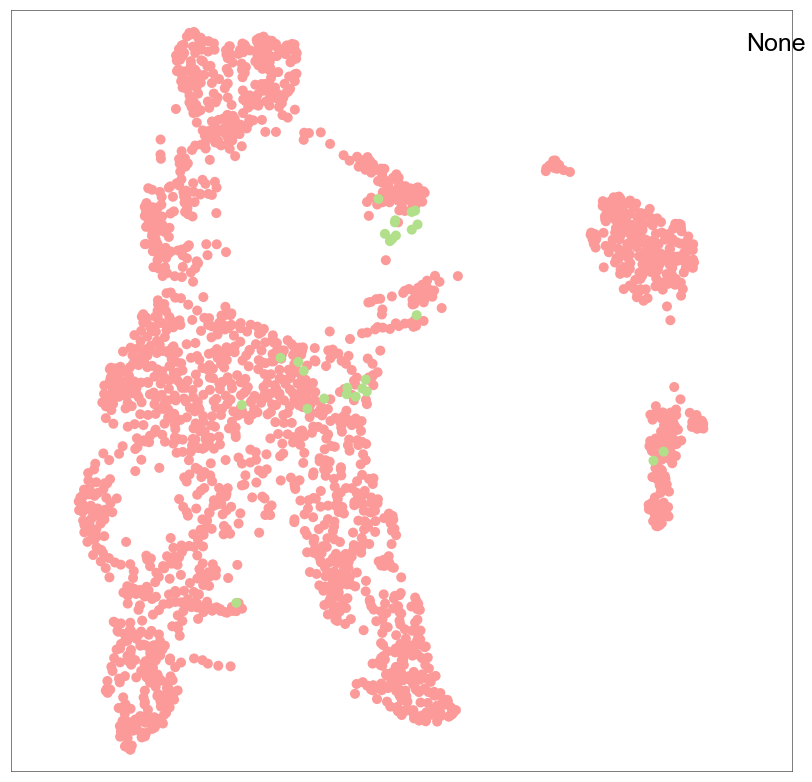

In [618]:
draw_tSNE(umap_ANA, cells_stage, number = None, cmap = {'5w':'#fb9a99','9w':'#b2df8a'}, pad = 2)

## Cell clustering

In [619]:
cl_c_ANA_AP =  AP_clustering_v4P(aff_c_ANA, 0, -100, 0.75)

In [620]:
len(set(cl_c_ANA_AP))

20

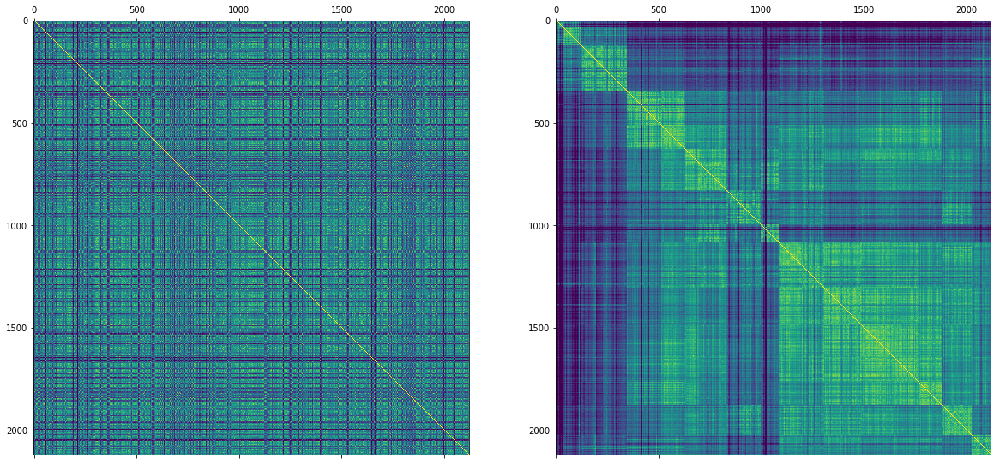

In [621]:
draw_AP_dist_mat(aff_c_ANA, cl_c_ANA_AP, cmap = plt.cm.viridis, vmin = -25.0, vmax = 0.0)

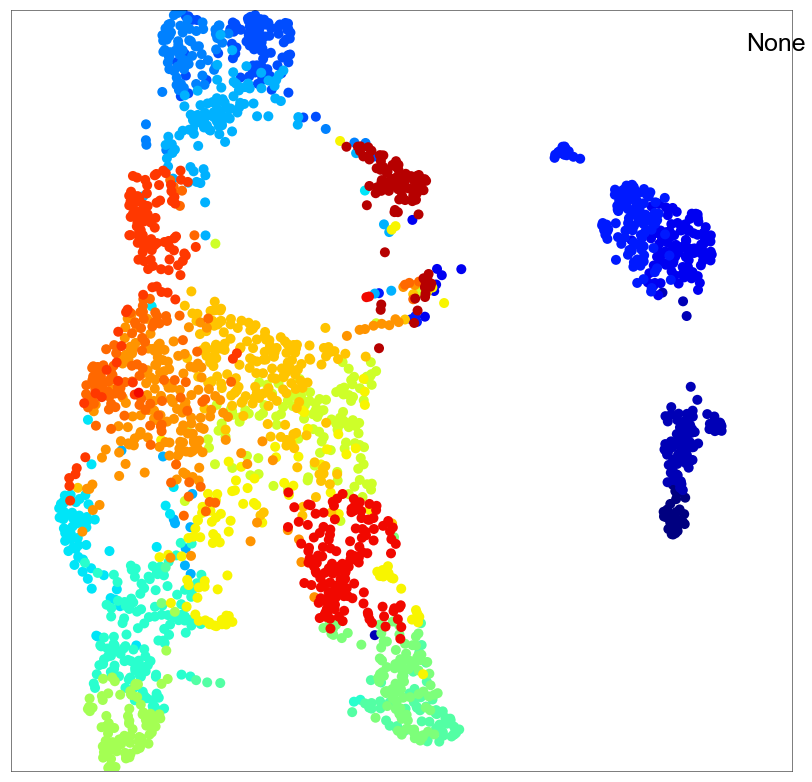

In [622]:
draw_tSNE(umap_ANA, cl_c_ANA_AP, number = None, cmap = plt.cm.jet)

## Consolidate clustering and tSNE by reassigning cluster outliers (less then 10 of 50 nearest neighbors in tSNE assigned to same cluster)

In [623]:
dist_ANA_ts = eucl_2d(umap_ANA)

In [624]:
cl_c_ANA_AP = smooth_clustering(dist_ANA_ts, cl_c_ANA_AP, 50, 10)

253/2120 cells reassigned!


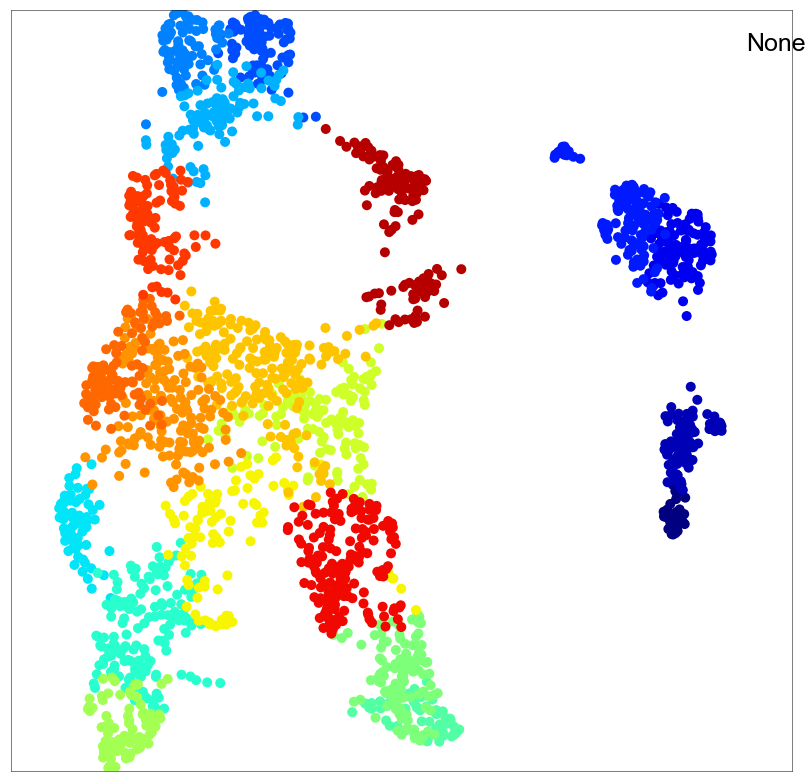

In [625]:
draw_tSNE(umap_ANA, cl_c_ANA_AP, number = None, cmap = plt.cm.jet)

## Manually reassign subcloud of cluster 3

In [626]:
c_sel = cl_c_ANA_AP[cl_c_ANA_AP==3].index
c_sel = [i for i in c_sel if umap_ANA.loc[i,'y'] > 20]

In [627]:
len(c_sel)

17

In [628]:
cl_c_ANA_AP[c_sel] = 20

In [629]:
cl_c_ANA_AP = AP_groups_reorder_v2(cl_c_ANA_AP, range(21))

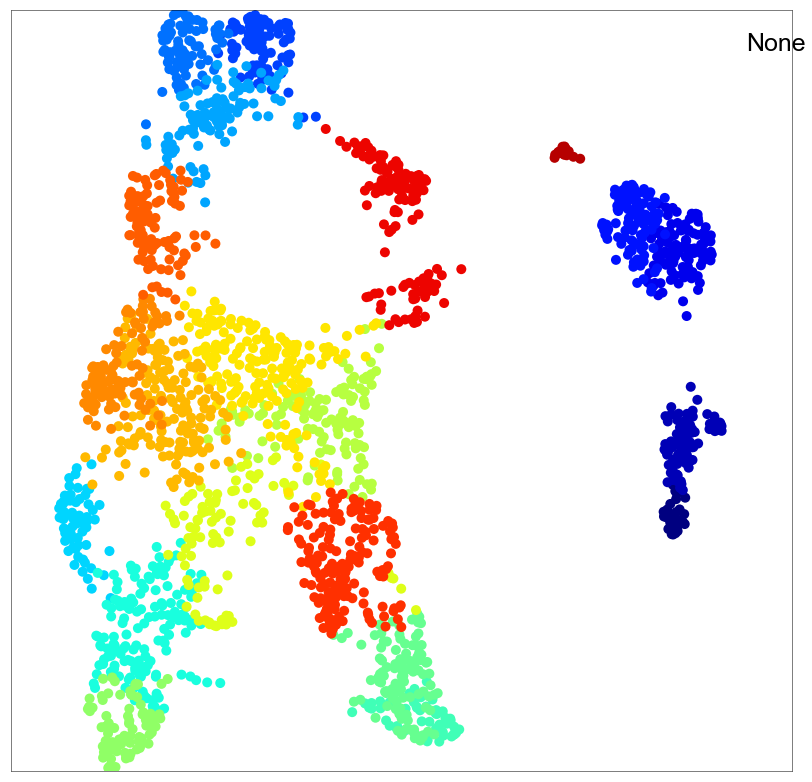

In [630]:
draw_tSNE(umap_ANA, cl_c_ANA_AP, number = None, cmap = plt.cm.jet)

## Remove cluster 19 from dataset as these cells very likely represent doublets (given the co-expression of both the anagen HF matrix marker Msx2 the and IFE marker Ly6a/d [Sca1])

In [631]:
cl_c_ANA_AP = cl_c_ANA_AP[cl_c_ANA_AP!=19]

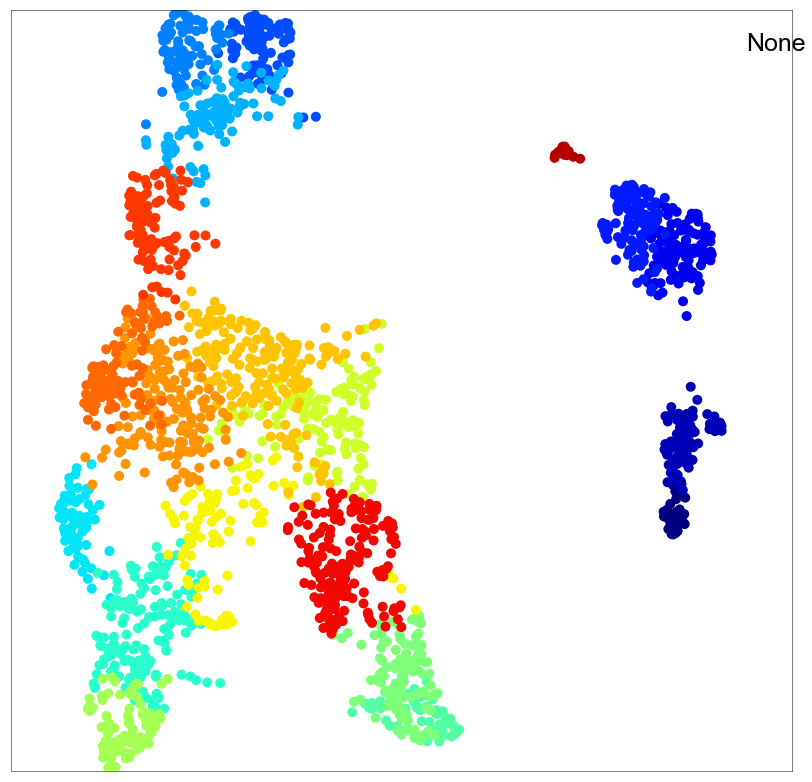

In [632]:
draw_tSNE(umap_ANA, cl_c_ANA_AP, number = None, cmap = plt.cm.jet)

### Checkpoint

In [440]:
#umap_ANA_old = loadData_v1(path_output, exp_id, 'umap_ANA_old', 'DataFrame')

In [441]:
saveData_v1(umap_ANA, path_output, exp_id, 'umap_ANA_old')

## Repeat Umap embedding of PCs

In [650]:
scdata_ANA = to_scanpy(seq_sel_ANA[cl_c_ANA_AP.index])

In [651]:
sc.pp.pca(scdata_ANA, n_comps = 20)

In [652]:
sc.pp.neighbors(scdata_ANA, n_neighbors=20, n_pcs=20, method = 'umap')

/Users/simjoo/anaconda/lib/python3.6/site-packages/scanpy/neighbors/__init__.py:121: RuntimeWarning: invalid value encountered in sqrt
  distances = np.sqrt(distances)


In [653]:
sc.tl.umap(scdata_ANA, min_dist=1, spread = 6)

/Users/simjoo/anaconda/lib/python3.6/site-packages/scanpy/neighbors/umap/umap_.py:1173: RuntimeWarning: divide by zero encountered in power
  return 1.0 / (1.0 + a * x ** (2 * b))


In [654]:
umap_ANA = pd.DataFrame(scdata_ANA.obsm['X_umap'], index = scdata_ANA.obs['CellID'], columns = ['x','y'])

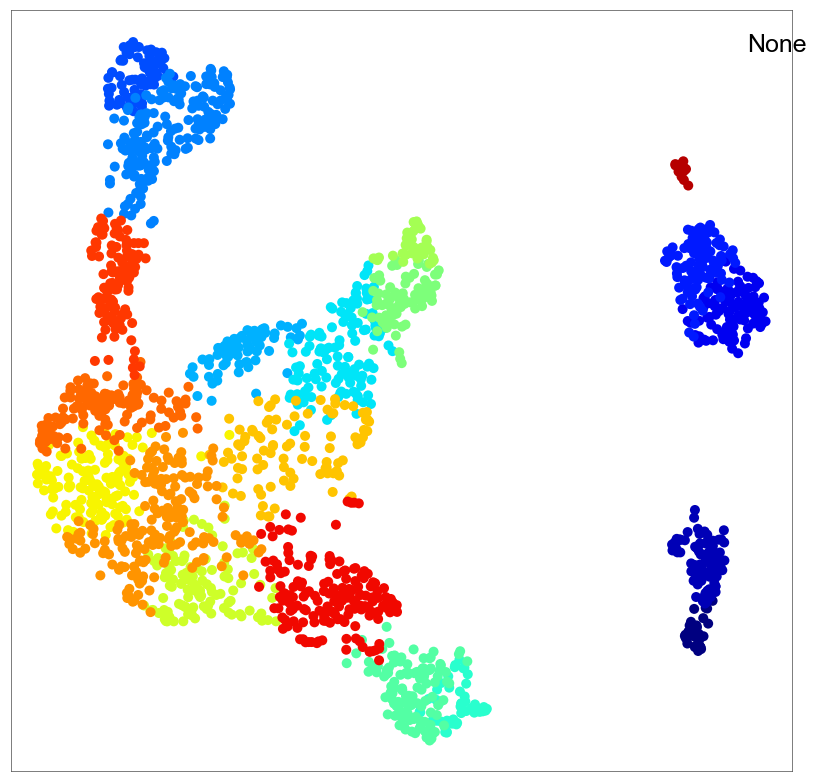

In [655]:
draw_tSNE(umap_ANA, cl_c_ANA_AP, number = None, cmap = plt.cm.jet, pad = 2)

## Combine IRS differentiated clusters #8, 9 as they will be subclustered separately

In [133]:
for c in cl_c_ANA_AP[cl_c_ANA_AP==9].index: cl_c_ANA_AP[c] = 8

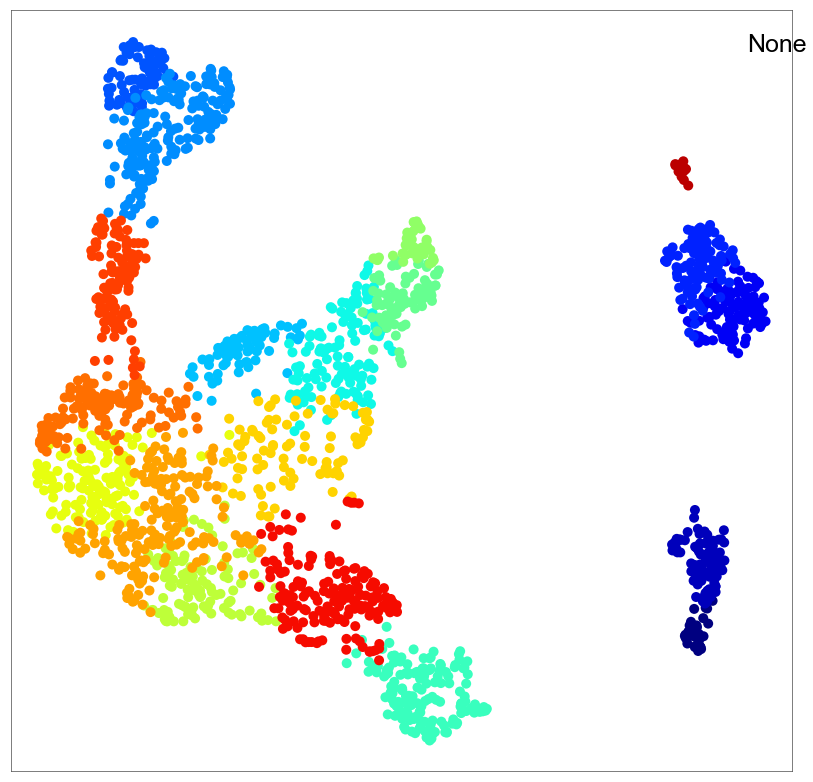

In [135]:
draw_tSNE(umap_ANA, cl_c_ANA_AP, number = None, cmap = plt.cm.jet, pad = 2)

## Further subcluster upper ORS cells (#0,#1)

In [487]:
c_sel_ORS = cl_c_ANA_AP[cl_c_ANA_AP.isin([0,1])].index

In [510]:
cl_c_ANA_ORS_AP =  AP_clustering_v4P(aff_c_ANA.loc[c_sel_ORS, c_sel_ORS], 0, -50, 0.6)

In [511]:
len(set(cl_c_ANA_ORS_AP))

3

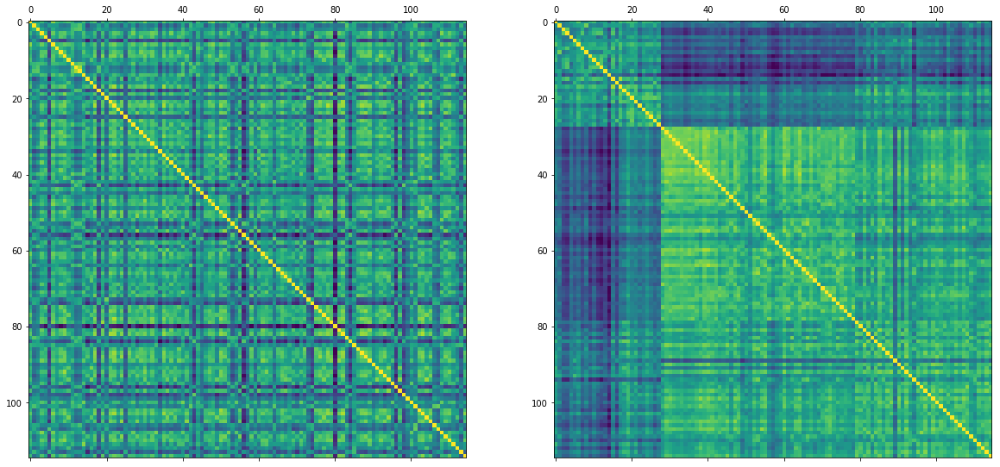

In [512]:
draw_AP_dist_mat(aff_c_ANA.loc[c_sel_ORS, c_sel_ORS], cl_c_ANA_ORS_AP, cmap = plt.cm.viridis, vmin = -25.0, vmax = 0.0)

In [546]:
for c in cl_c_ANA_ORS_AP[cl_c_ANA_ORS_AP==0].index: cl_c_ANA_AP[c] = 0
for c in cl_c_ANA_ORS_AP[cl_c_ANA_ORS_AP==1].index: cl_c_ANA_AP[c] = 1
for c in cl_c_ANA_ORS_AP[cl_c_ANA_ORS_AP==2].index: cl_c_ANA_AP[c] = 21

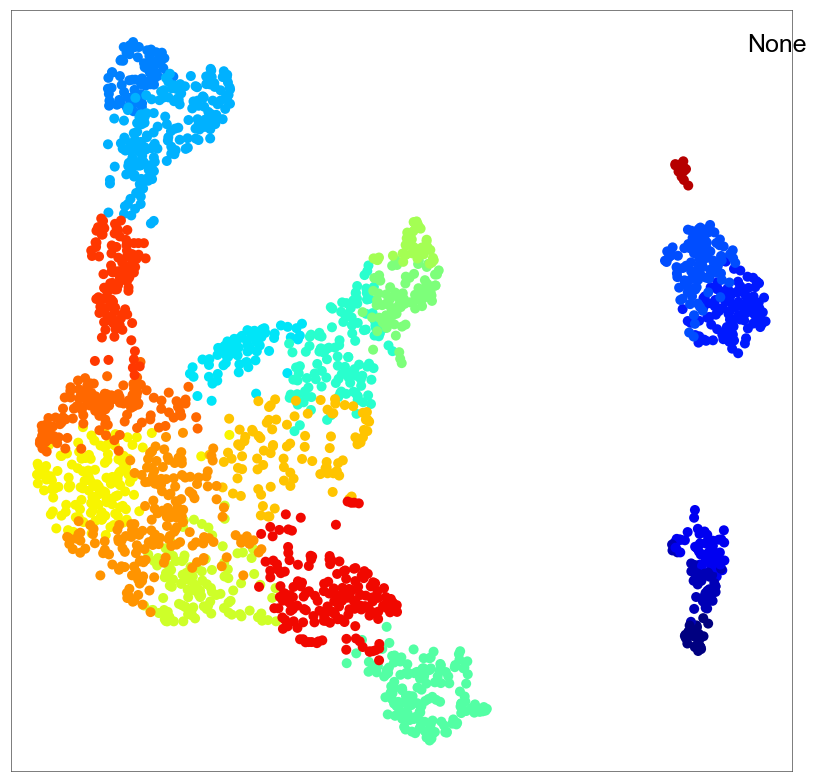

In [547]:
draw_tSNE(umap_ANA, cl_c_ANA_AP, number = None, cmap = plt.cm.jet, pad = 2)

### Checkpoint

In [548]:
saveData_v1(umap_ANA, path_output, exp_id, 'umap_ANA')
saveData_v1(cl_c_ANA_AP, path_output, exp_id, 'cl_c_ANA_AP')

In [549]:
cl_c_ANA_AP = loadData_v1(path_output, exp_id, 'cl_c_ANA_AP', 'Series')
umap_ANA = loadData_v1(path_output, exp_id, 'umap_ANA', 'DataFrame')

# Further subcluster differentiated IRS cells

## Feature selection

In [531]:
c_sel_ANA_IRS = cl_c_ANA_AP[cl_c_ANA_AP.isin([8])].index


Dropping unexpressed genes from dataset

After mean expression cutoff of 0.025, 7306 genes remain

After high variance feature selection, 500 genes remain


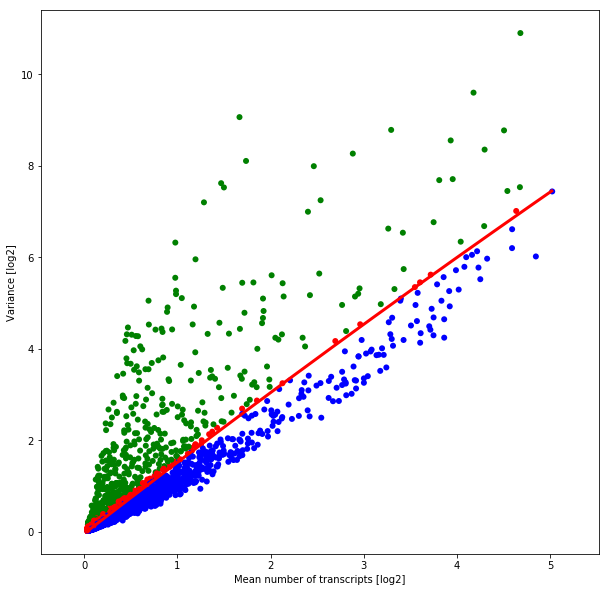

In [803]:
seq_sel_ANA_IRS = select_features_log2_var_polyfit_v2(seqN[c_sel_ANA_IRS], 0.025, 500)

## Dimensionality reduction with PCA

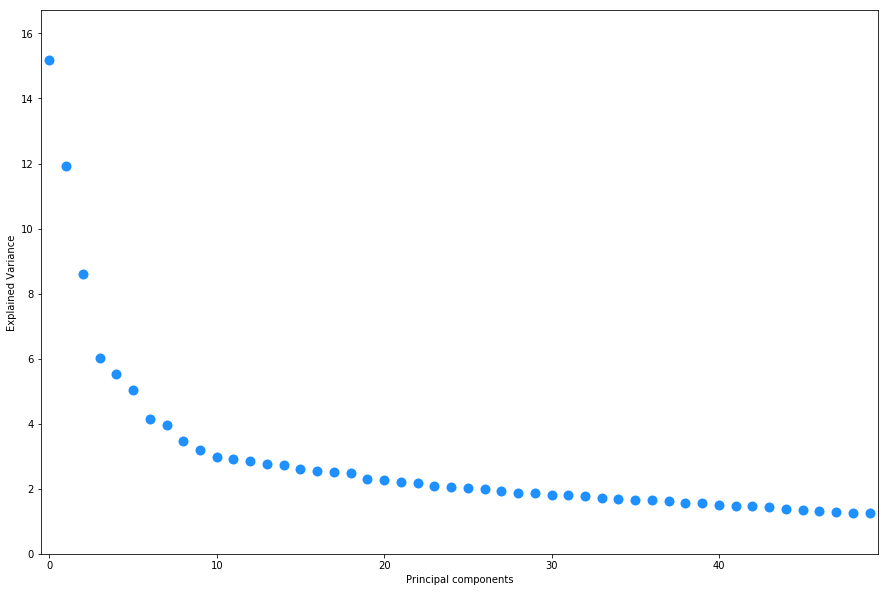

In [804]:
pca_explained_var(seq_sel_ANA_IRS)

In [805]:
seq_sel_ANA_IRS_pca, dist_c_ANA_IRS = dim_reduc_pca(seq_sel_ANA_IRS, 2, 'euclidean', inverse_transform = False)

In [806]:
aff_c_ANA_IRS = -dist_c_ANA_IRS

## Umap embedding of PCs

In [807]:
scdata_ANA_IRS = to_scanpy(seq_sel_ANA_IRS)

In [808]:
sc.pp.pca(scdata_ANA_IRS, n_comps = 2)

In [809]:
sc.pp.neighbors(scdata_ANA_IRS, n_neighbors=20, n_pcs=2, method = 'umap')

/Users/simjoo/anaconda/lib/python3.6/site-packages/scanpy/neighbors/__init__.py:121: RuntimeWarning: invalid value encountered in sqrt
  distances = np.sqrt(distances)


In [810]:
sc.tl.umap(scdata_ANA_IRS, min_dist=1, spread=2)

In [811]:
umap_ANA_IRS = pd.DataFrame(scdata_ANA_IRS.obsm['X_umap'], index = scdata_ANA_IRS.obs['CellID'], columns = ['x','y'])

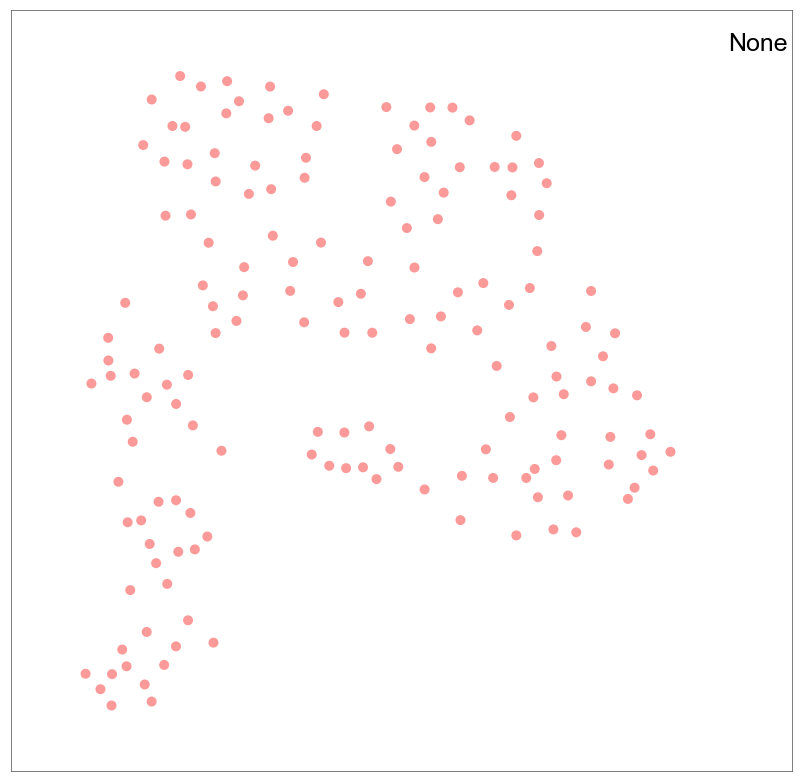

In [812]:
draw_tSNE(umap_ANA_IRS, cells_stage, number = None, cmap = {'5w':'#fb9a99','9w':'#b2df8a'}, pad = 2)

## Cell clustering

In [820]:
cl_c_ANA_IRS_AP =  AP_clustering_v4P(aff_c_ANA_IRS, 0, -50, 0.75)

In [821]:
len(set(cl_c_ANA_IRS_AP))

5

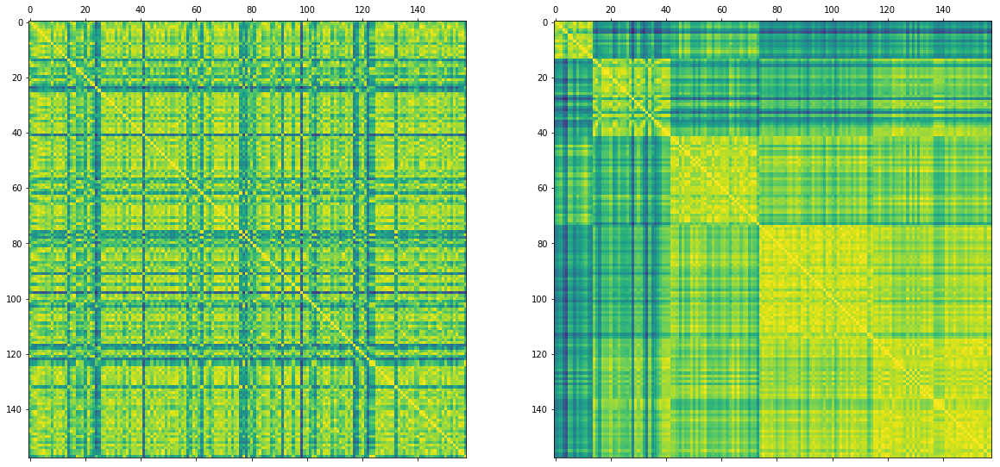

In [822]:
draw_AP_dist_mat(aff_c_ANA_IRS, cl_c_ANA_IRS_AP, cmap = plt.cm.viridis, vmin = -25.0, vmax = 0.0)

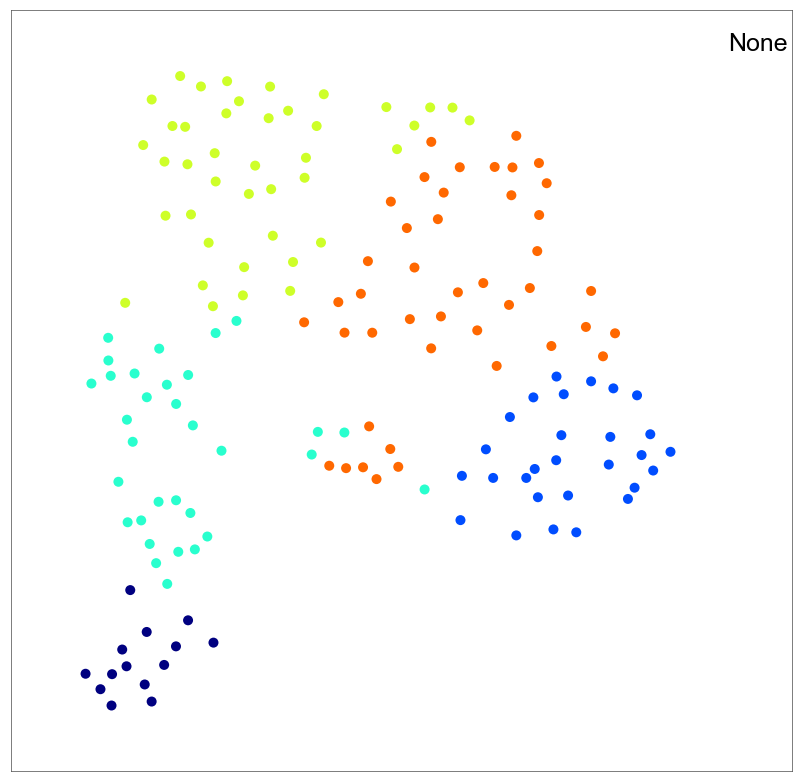

In [823]:
draw_tSNE(umap_ANA_IRS, cl_c_ANA_IRS_AP, number = None, cmap = plt.cm.jet, pad = 2)

## Manually separate the cloud of cells made mainly up of cluster 1 cells

In [824]:
c_sel = cl_c_ANA_IRS_AP[cl_c_ANA_IRS_AP==2].index
c_sel = [i for i in c_sel if umap_ANA_IRS.loc[i,'x'] > 4]

In [825]:
len(c_sel)

4

In [826]:
cl_c_ANA_IRS_AP[c_sel] = 5

In [827]:
c_sel = cl_c_ANA_IRS_AP[cl_c_ANA_IRS_AP==4].index
c_sel = [i for i in c_sel if umap_ANA_IRS.loc[i,'y'] < 0]

In [828]:
len(c_sel)

7

In [829]:
cl_c_ANA_IRS_AP[c_sel] = 5

In [830]:
cl_c_ANA_IRS_AP = AP_groups_reorder_v2(cl_c_ANA_IRS_AP, range(6))

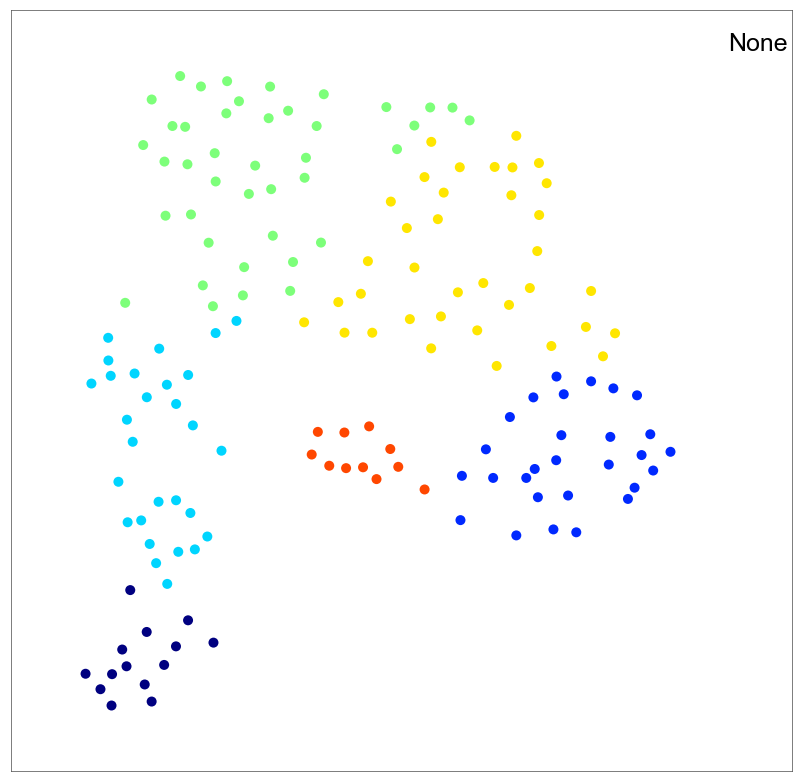

In [831]:
draw_tSNE(umap_ANA_IRS, cl_c_ANA_IRS_AP, number = None, cmap = plt.cm.jet, pad = 2)

## Further analysis revealed that cluster 5 is mainly made up of low quality cells which neither share much with their assign clusters, nor with each other. Remove!

In [834]:
c_rem_IRS = cl_c_ANA_IRS_AP[cl_c_ANA_IRS_AP==5].index

In [839]:
cl_c_ANA_AP = cl_c_ANA_AP.drop(c_rem_IRS)

In [835]:
len(c_rem_IRS)

11

In [836]:
cl_c_ANA_IRS_AP = cl_c_ANA_IRS_AP[cl_c_ANA_IRS_AP!=5]

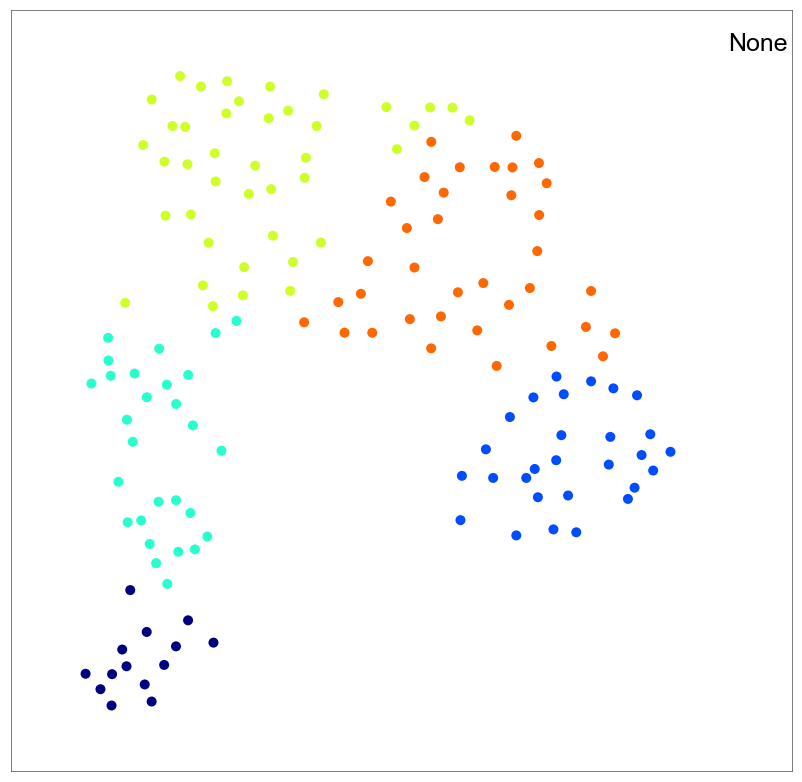

In [837]:
draw_tSNE(umap_ANA_IRS, cl_c_ANA_IRS_AP, number = None, cmap = plt.cm.jet, pad = 2)

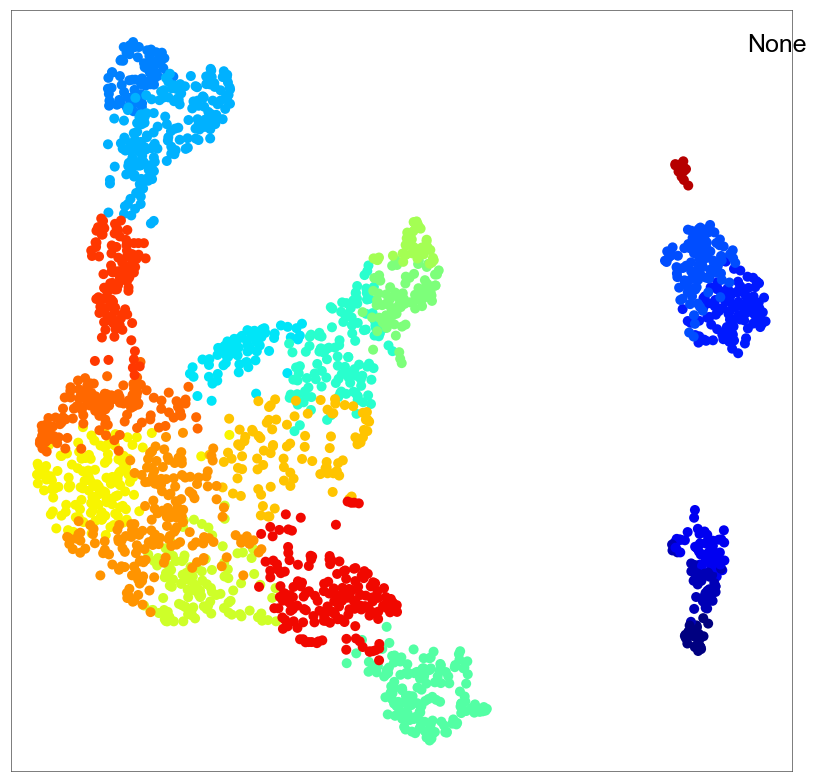

In [533]:
draw_tSNE(umap_ANA, cl_c_ANA_AP, number = None, cmap = plt.cm.jet, pad = 2)

### Checkpoint

In [535]:
#saveData_v1(umap_ANA_IRS, path_output, exp_id, 'umap_ANA_IRS')
#saveData_v1(cl_c_ANA_IRS_AP, path_output, exp_id, 'cl_c_ANA_IRS_AP')
#saveData_v1(cl_c_ANA_AP, path_output, exp_id, 'cl_c_ANA_AP')

In [534]:
cl_c_ANA_AP = loadData_v1(path_output, exp_id, 'cl_c_ANA_AP', 'Series')
cl_c_ANA_IRS_AP = loadData_v1(path_output, exp_id, 'cl_c_ANA_IRS_AP', 'Series')
umap_ANA_IRS = loadData_v1(path_output, exp_id, 'umap_ANA_IRS', 'DataFrame')

# Anagen HF subclustering with Seurat


## Import clustering and tSNE data

In [536]:
cl_c_ANA_S = pd.read_csv('%s/Seurat/TenX_2ndLevel_ANA_ClusterIdentity.txt' % path_output, sep = '\t', header = None, index_col = 0, 
                           low_memory = False, squeeze = True)

In [537]:
tsne_ANA_S = pd.read_csv('%s/Seurat/TenX_2ndLevel_ANA_TSNEcoordinates.txt' % path_output, sep = '\t', index_col = 0, header = 0)
tsne_ANA_S.columns = ['x','y']

In [538]:
c_sel = [c for c in cl_c_ANA_AP.index if c in cl_c_ANA_S.index]

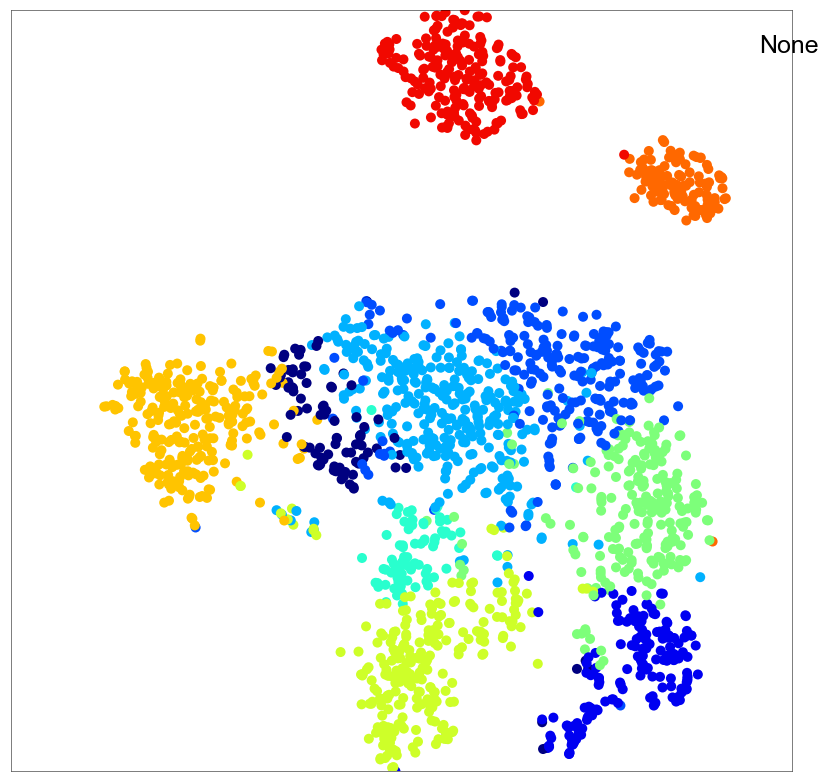

In [539]:
draw_tSNE(tsne_ANA_S, cl_c_ANA_S, number = None, cmap = plt.cm.jet)

## Compare AP and Seurat (NB: Seurat clustering was done using Seurat cell selection; see above)

In [540]:
seurat_vs_AP_ANA = seurat_vs_AP(cl_c_ANA_S[c_sel], cl_c_ANA_AP[c_sel])

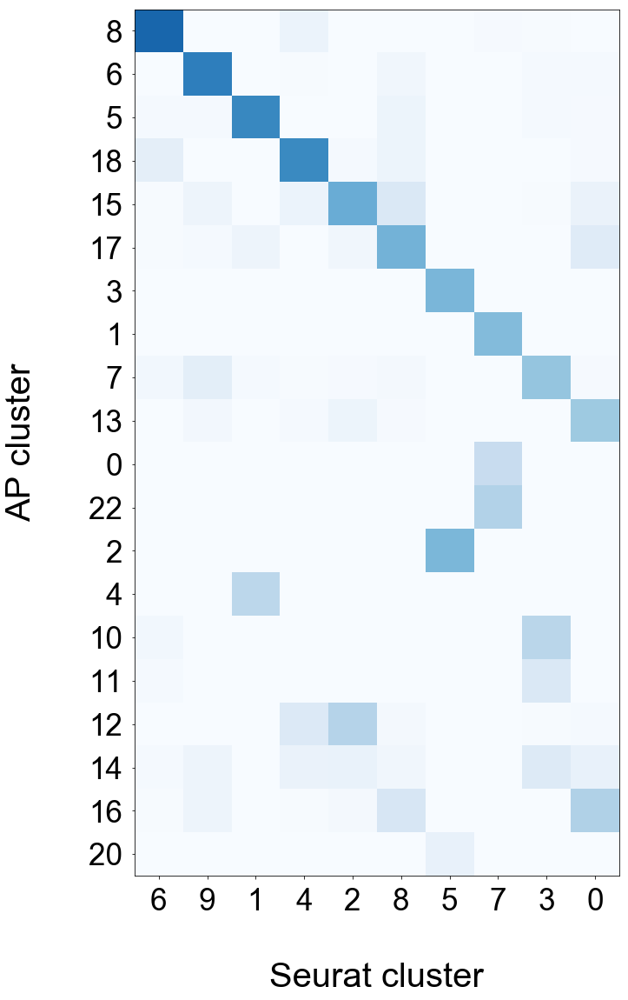

In [541]:
data = seurat_vs_AP_ANA

#generate figure

fig = plt.figure(facecolor = 'w', figsize = (len(data.columns), len(data.index)))
gs = plt.GridSpec(nrows = 2, ncols = 1, wspace=0.0, hspace=0.0, height_ratios=[1.0, 11.0])

#generate plot

ax = plt.subplot(gs[1])

#generate xaxis

ax.set_xlim(-0.5, len(data.columns) - 0.5)
ax.set_xticks(np.arange(0, len(data.columns)))
ax.set_xticklabels([c for c in data.columns], family = 'Arial', fontsize = 35)
ax.set_xlabel('Seurat cluster', family = 'Arial', fontsize = 40)
ax.xaxis.set_label_coords(0.5, -0.1)
ax.tick_params(axis='x', which='major', pad=10)

#generate yaxis

ax.set_ylim(len(data.index) -0.5, -0.5)
ax.set_yticks(np.arange(0, len(data.index)))
ax.set_yticklabels([ix for ix in data.index], family = 'Arial', fontsize = 35)
ax.set_ylabel('AP cluster', family = 'Arial', fontsize = 40)
ax.yaxis.set_label_coords(-0.2, 0.5)
ax.tick_params(axis='y', which='major', pad=10)

#plot data

ax.imshow(data.astype(float),
          cmap = plt.cm.Blues,
          aspect = 'auto',
          interpolation = 'nearest',
          vmin = 0, vmax = 1)

## Use AP clustering since it divided subpopulations in a finer manner. Remove cluster #12 since we cannot exclude that these are doublets.

In [550]:
cl_c_ANA = pd.Series(['ANA - %s' % cl for cl in cl_c_ANA_AP], 
                     index = cl_c_ANA_AP.index)

In [561]:
cmap_ANA = {'ANA - 0': '#01665e',
            'ANA - 1': '#80cdc1',
            'ANA - 2': '#92c5de',
            'ANA - 3': '#2166ac',
            'ANA - 4': '#7f3b08',
            'ANA - 5': '#e08214',
            'ANA - 6': '#74c476',
            'ANA - 7': '#238b45',
            'ANA - 8': '#e31a1c',
            'ANA - 9': '#e31a1c',
            'ANA - 10': '#006d2c',
            'ANA - 11': '#00441b',
            'ANA - 12': '#d8daeb',
            'ANA - 13': '#8073ac',
            'ANA - 14': '#a1d99b',
            'ANA - 15': '#b2abd2',
            'ANA - 16': '#542788',
            'ANA - 17': '#fec44f',
            'ANA - 18': '#fcbba1',
            'ANA - 20': '#053061',
            'ANA - 21':'#35978f'}

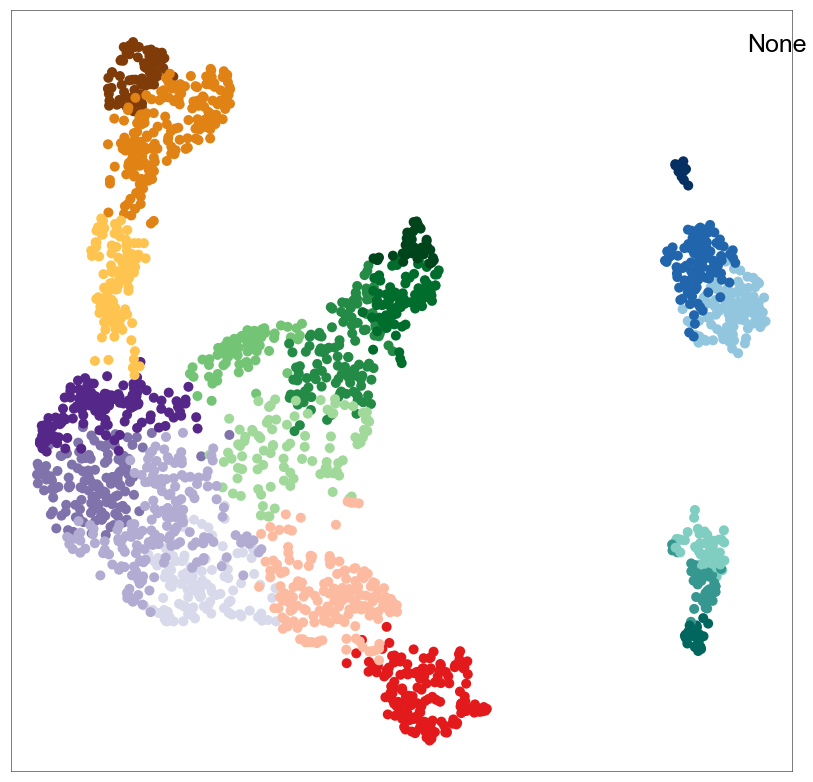

In [567]:
draw_tSNE(umap_ANA, cl_c_ANA, number = None, cmap = cmap_ANA, pad = 2)

In [568]:
cl_c_ANA = AP_groups_reorder_v2(cl_c_ANA, ['ANA - 1','ANA - 21','ANA - 0',
                                           'ANA - 2', 'ANA - 3', 'ANA - 20',
                                           'ANA - 16','ANA - 13', 'ANA - 15', 'ANA - 12',
                                           'ANA - 17','ANA - 5', 'ANA - 4',
                                           'ANA - 14','ANA - 6', 'ANA - 7', 'ANA - 10', 'ANA - 11',
                                           'ANA - 18','ANA - 8'])

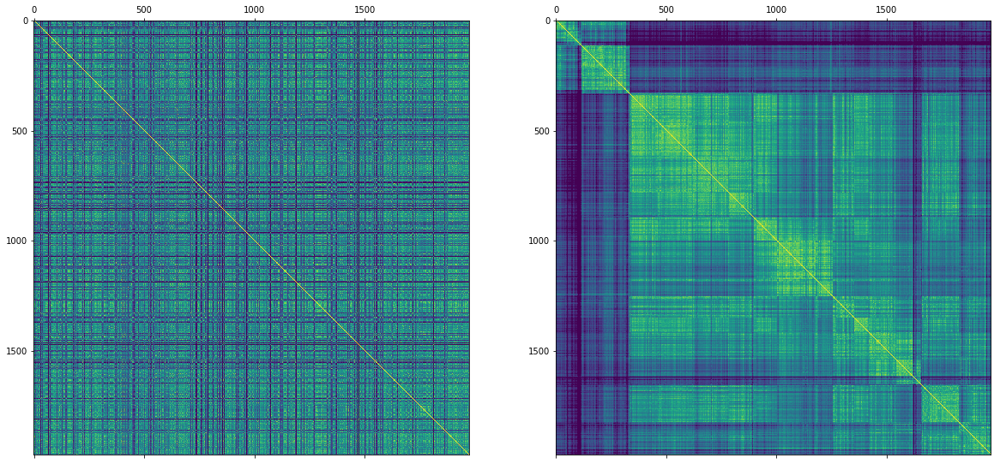

In [569]:
draw_AP_dist_mat(dist_c_ANA.loc[cl_c_ANA.index, cl_c_ANA.index], cl_c_ANA, cmap = plt.cm.viridis_r, vmin = 0, vmax = 25.0)

In [570]:
cl_c_ANA_IRS = pd.Series(['ANA - IRS - %s' % cl for cl in cl_c_ANA_IRS_AP],
                         index = cl_c_ANA_IRS_AP.index)

In [571]:
cmap_ANA_IRS = {'ANA - IRS - 0': '#7a0177',
                'ANA - IRS - 1': '#a50f15',
                'ANA - IRS - 2': '#c51b8a',
                'ANA - IRS - 3': '#fb6a4a',
                'ANA - IRS - 4': '#de2d26'}

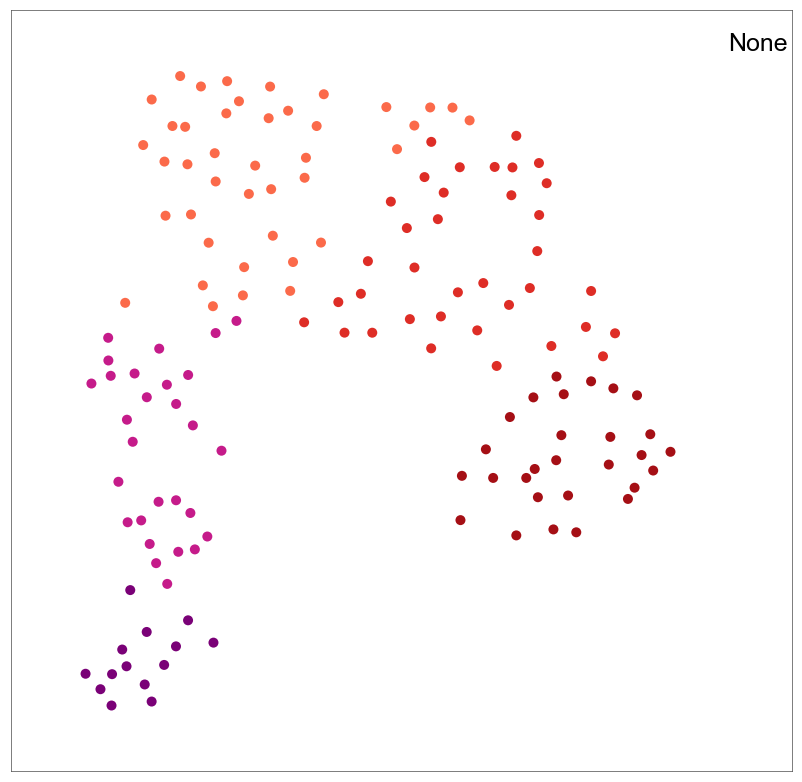

In [572]:
draw_tSNE(umap_ANA_IRS, cl_c_ANA_IRS, number = None, cmap = cmap_ANA_IRS, pad = 2)

### Checkpoint

In [573]:
#saveData_v1(cl_c_ANA, path_output, exp_id, 'cl_c_ANA')
#saveData_v1(cl_c_ANA_IRS, path_output, exp_id, 'cl_c_ANA_IRS')

In [33]:
cl_c_ANA = loadData_v1(path_output, exp_id, 'cl_c_ANA', 'Series')
cl_c_ANA_IRS = loadData_v1(path_output, exp_id, 'cl_c_ANA_IRS', 'Series')
umap_ANA = loadData_v1(path_output, exp_id, 'umap_ANA', 'DataFrame')
umap_ANA_IRS = loadData_v1(path_output, exp_id, 'umap_ANA_IRS', 'DataFrame')

# Fibroblast subclustering with Affinity Propagation

## Feature selection

In [163]:
c_sel_FIB = cl_c_1st[cl_c_1st=='FIB'].index

In [164]:
len(c_sel_FIB)

435


Dropping unexpressed genes from dataset

After mean expression cutoff of 0.025, 9049 genes remain

After high variance feature selection, 2500 genes remain


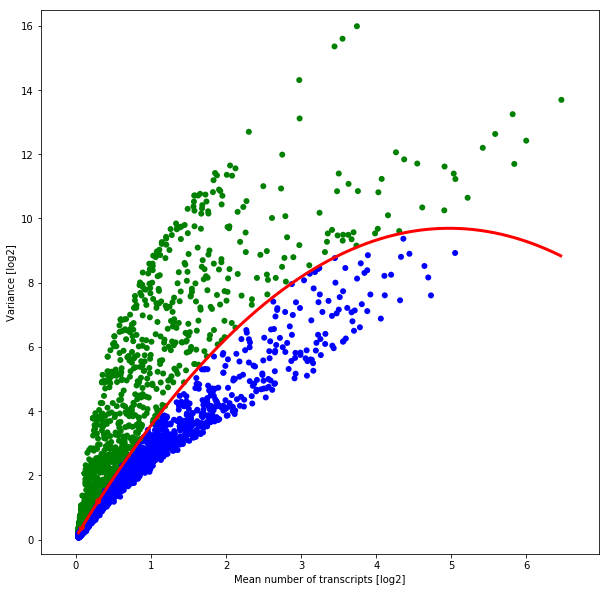

In [165]:
seq_sel_FIB = select_features_log2_var_polyfit_v2(seqN[c_sel_FIB], 0.025, 2500)

### Checkpoint

In [166]:
#saveData_v1(seq_sel_FIB, path_output, exp_id, 'seq_sel_FIB')

In [167]:
seq_sel_FIB = loadData_v1(path_output, exp_id, 'seq_sel_FIB', 'DataFrame')

## Dimensionality reduction with PCA

In [1]:
#pca_explained_var(seq_sel_FIB)

In [169]:
seq_sel_FIB_pca, dist_c_FIB = dim_reduc_pca(seq_sel_FIB, 15, 'euclidean', inverse_transform = False)

In [170]:
aff_c_FIB = -dist_c_FIB

## Umap embedding of PCs

In [872]:
scdata_FIB = to_scanpy(seq_sel_FIB)

In [873]:
sc.pp.pca(scdata_FIB, n_comps = 15)

In [874]:
sc.pp.neighbors(scdata_FIB, n_neighbors=20, n_pcs=15, method = 'umap')

/Users/simjoo/anaconda/lib/python3.6/site-packages/scanpy/neighbors/__init__.py:121: RuntimeWarning: invalid value encountered in sqrt
  distances = np.sqrt(distances)


In [878]:
sc.tl.umap(scdata_FIB, min_dist = 0.5, spread = 5)

/Users/simjoo/anaconda/lib/python3.6/site-packages/scanpy/neighbors/umap/umap_.py:1173: RuntimeWarning: divide by zero encountered in power
  return 1.0 / (1.0 + a * x ** (2 * b))


In [879]:
umap_FIB = pd.DataFrame(scdata_FIB.obsm['X_umap'], index = scdata_FIB.obs['CellID'], columns = ['x','y'])

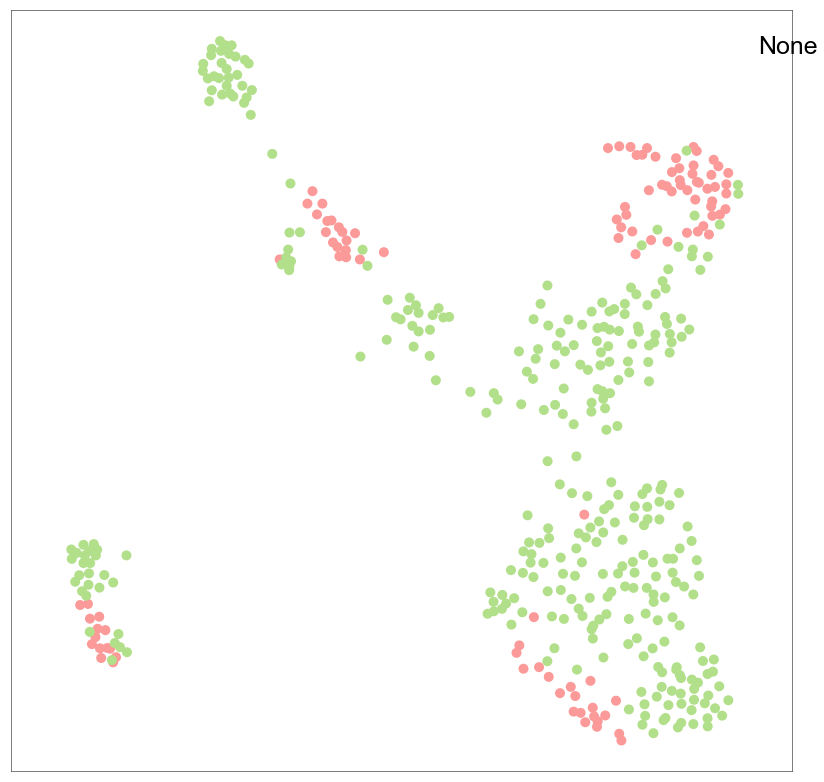

In [880]:
draw_tSNE(umap_FIB, cells_stage, number = None, cmap = {'5w':'#fb9a99','9w':'#b2df8a'}, pad = 2)

## Cell clustering

In [881]:
cl_c_FIB_AP =  AP_clustering_v4P(aff_c_FIB, 0, -100, 0.75)

In [882]:
len(set(cl_c_FIB_AP))

7

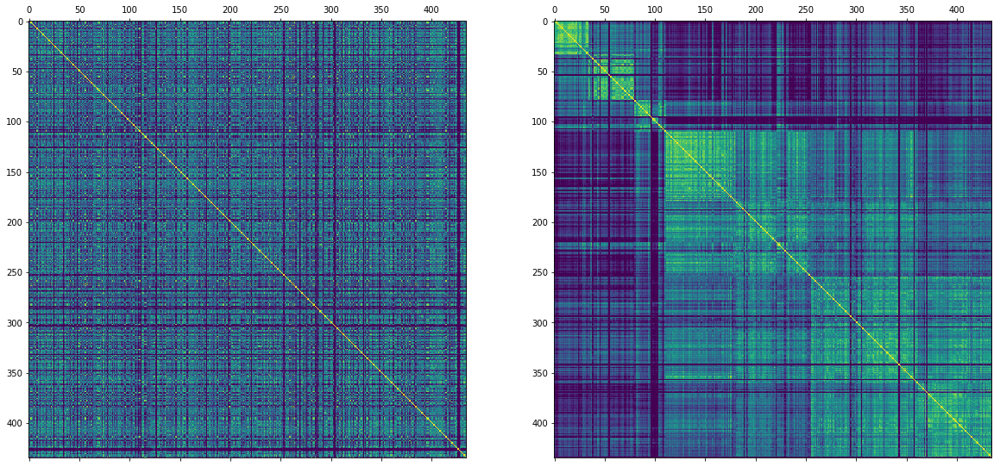

In [883]:
draw_AP_dist_mat(aff_c_FIB, cl_c_FIB_AP, cmap = plt.cm.viridis, vmin = -25.0, vmax = 0.0)

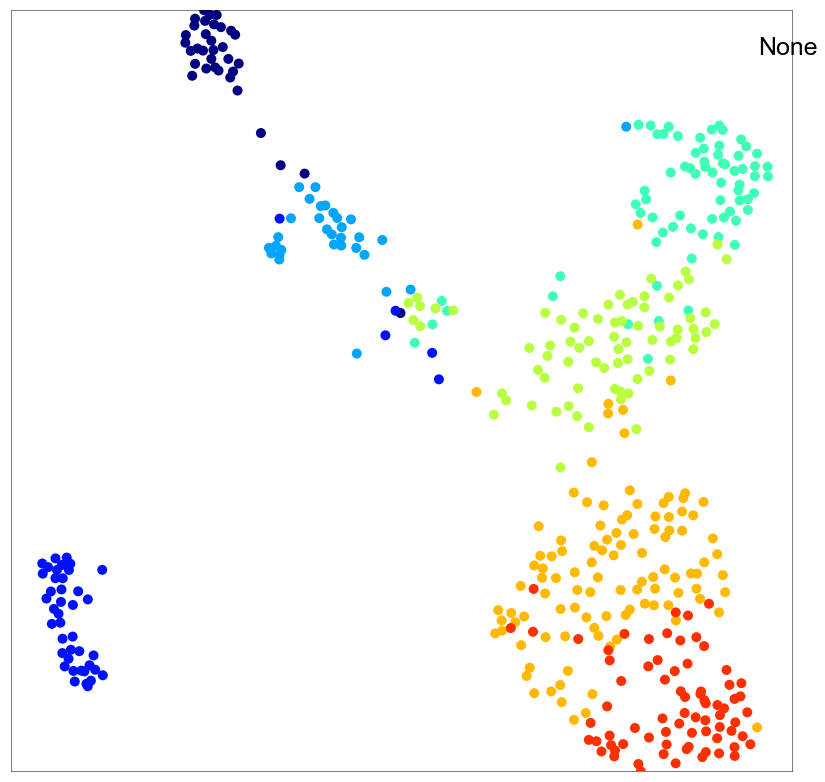

In [884]:
draw_tSNE(umap_FIB, cl_c_FIB_AP, number = None, cmap = plt.cm.jet)

## Consolidate clustering and tSNE by reassigning cluster outliers (less then 5 of 25 nearest neighbors in tSNE assigned to same cluster)

In [885]:
dist_FIB_ts = eucl_2d(umap_FIB)

In [886]:
cl_c_FIB_AP = smooth_clustering(dist_FIB_ts, cl_c_FIB_AP, 25, 5)

31/435 cells reassigned!


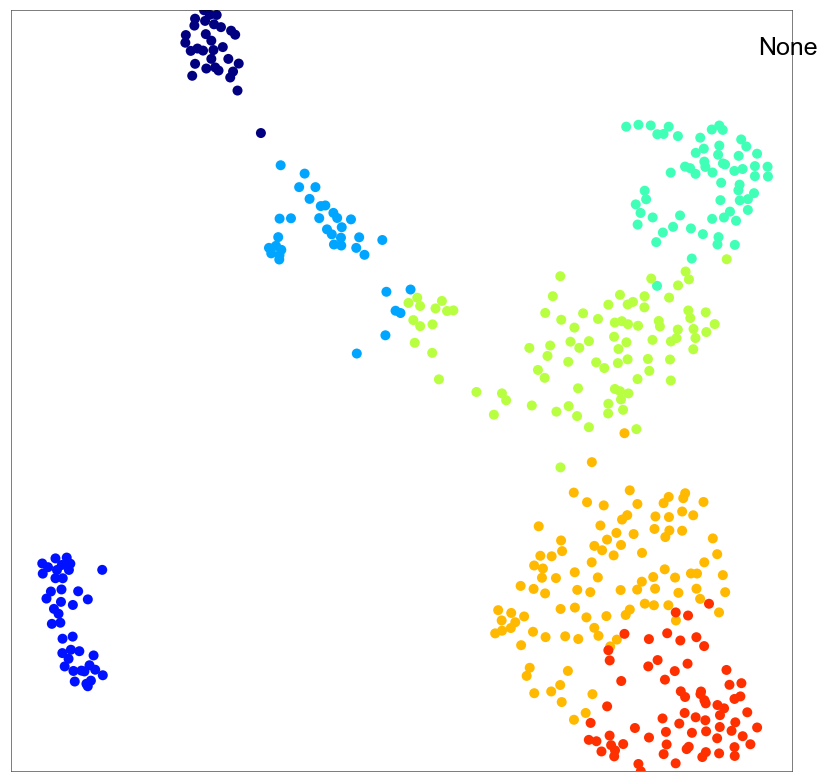

In [887]:
draw_tSNE(umap_FIB, cl_c_FIB_AP, number = None, cmap = plt.cm.jet)

## Move cluster 1 (skeletal muscle cells)

In [888]:
c_FIB_to_MISC = cl_c_FIB_AP[cl_c_FIB_AP==1].index

In [889]:
len(c_FIB_to_MISC)

41

In [890]:
cl_c_FIB_AP = cl_c_FIB_AP[cl_c_FIB_AP!=1]

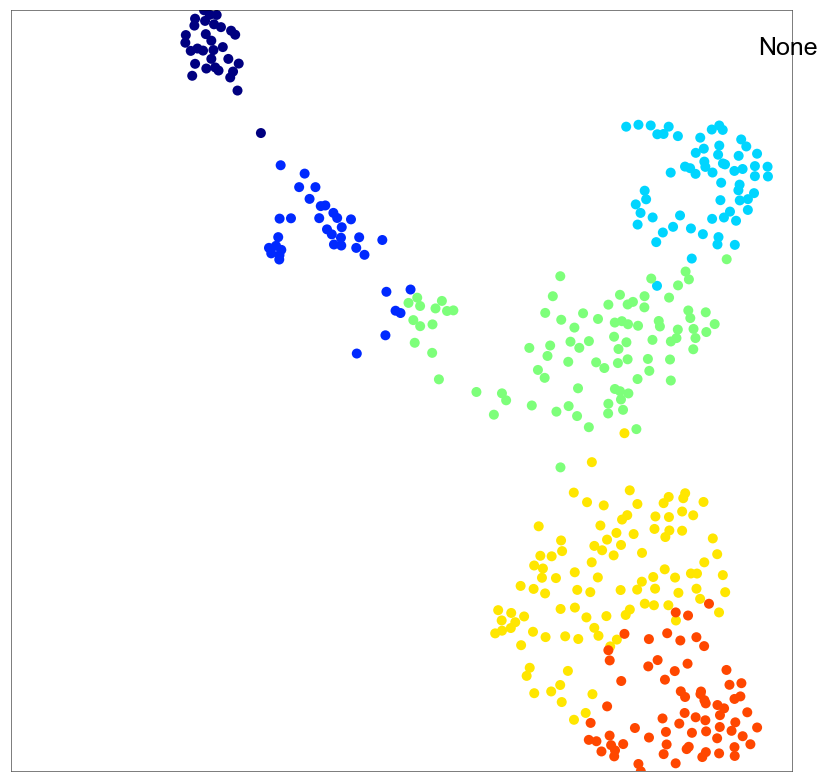

In [891]:
draw_tSNE(umap_FIB, cl_c_FIB_AP, number = None, cmap = plt.cm.jet)

## Manually separate Umap cloud containing cells from clusters 2 and 4 (DSP cluster?)

In [897]:
c_sel = cl_c_FIB_AP[cl_c_FIB_AP==2].index
c_sel = [i for i in c_sel if umap_FIB.loc[i,'y'] < 10]

In [898]:
len(c_sel)

6

In [899]:
cl_c_FIB_AP[c_sel] = 1

In [902]:
c_sel = cl_c_FIB_AP[cl_c_FIB_AP==4].index
c_sel = [i for i in c_sel if umap_FIB.loc[i,'x'] < 1]

In [903]:
len(c_sel)

13

In [904]:
cl_c_FIB_AP[c_sel] = 1

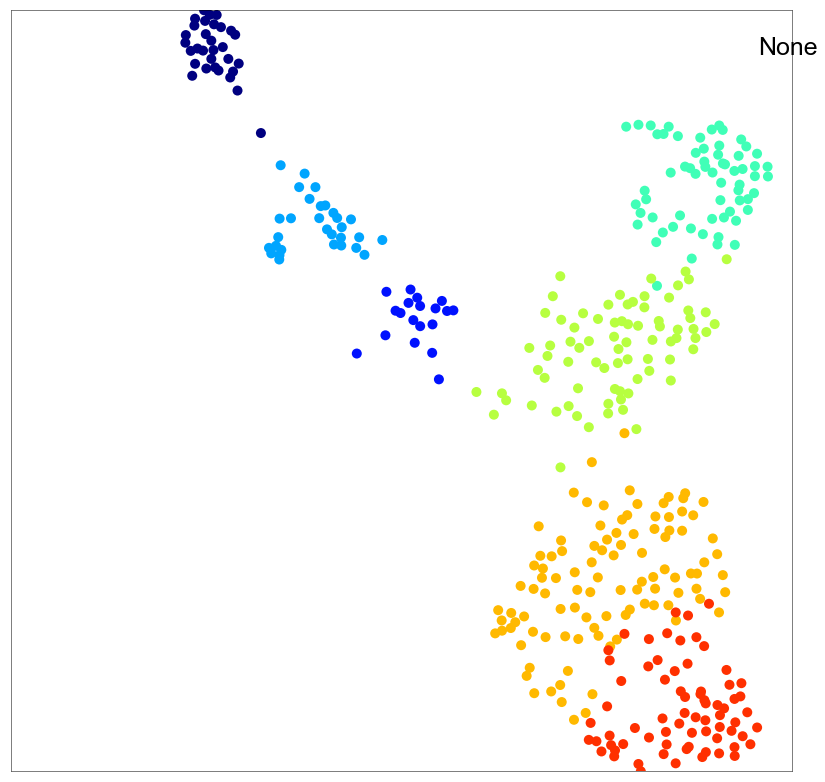

In [905]:
draw_tSNE(umap_FIB, cl_c_FIB_AP, number = None, cmap = plt.cm.jet)

## Downstream analysis revealed that a subset of cluster #2 has an identity indistinguishable from vascular smooth muscle cells

In [191]:
c_FIB_to_VASC = ['TTGTAGCTGGAGGT-9w', 'TAAGTCCTACGCAT-9w', 'GTTGATCTGGGATG-9w','TGGTAGACTCTCAT-9w', 
                 'CTCTAAACTCGCTC-5w', 'AAGCGACTCCTGAA-9w','GTCATACTCTGCAA-9w', 'GATTCGGACCCTAC-9w', 
                 'CAAGACTGATCAGC-9w']

In [192]:
c_sel = [c for c in cl_c_FIB_AP.index if c not in c_FIB_to_VASC]

In [193]:
cl_c_FIB_AP = cl_c_FIB_AP[c_sel]

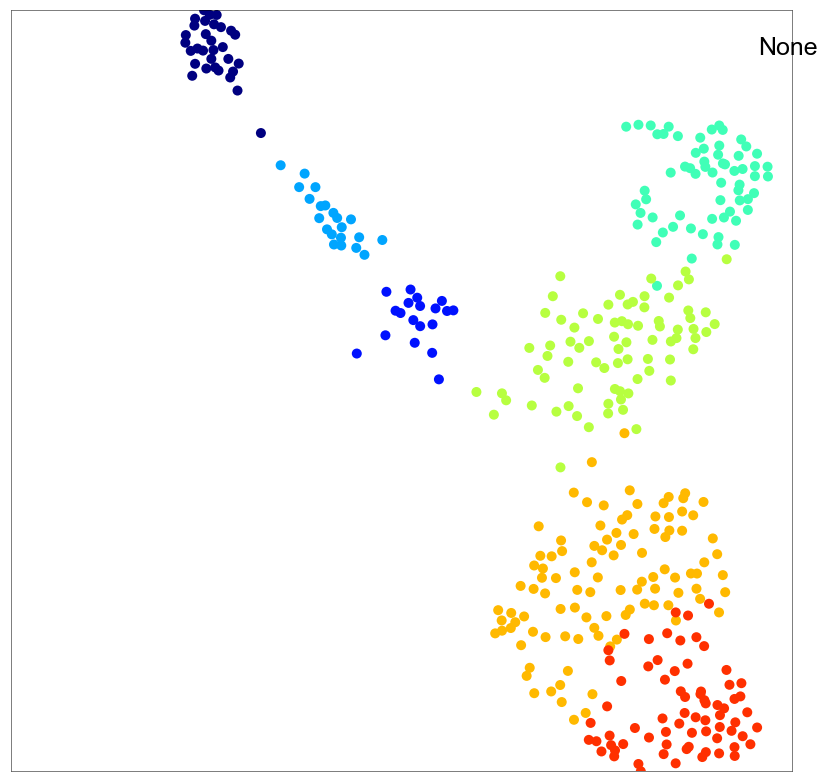

In [78]:
draw_tSNE(umap_FIB, cl_c_FIB_AP, number = None, cmap = plt.cm.jet)

### Checkpoint

In [174]:
#saveData_v1(umap_FIB, path_output, exp_id, 'umap_FIB')
#saveData_v1(cl_c_FIB_AP, path_output, exp_id, 'cl_c_FIB_AP')

In [15]:
cl_c_FIB_AP = loadData_v1(path_output, exp_id, 'cl_c_FIB_AP', 'Series')
umap_FIB = loadData_v1(path_output, exp_id, 'umap_FIB', 'DataFrame')

# Fibroblast subclustering with Seurat

## Import clustering and tSNE data

In [176]:
cl_c_FIB_S = pd.read_csv('%s/Seurat/TenX_2ndLevel_FIB_ClusterIdentity.txt' % path_output, sep = '\t', header = None, index_col = 0, 
                           low_memory = False, squeeze = True)

In [177]:
tsne_FIB_S = pd.read_csv('%s/Seurat/TenX_2ndLevel_FIB_TSNEcoordinates.txt' % path_output, sep = '\t', index_col = 0, header = 0)
tsne_FIB_S.columns = ['x','y']

In [178]:
c_sel = list(set(cl_c_FIB_S.index) & set(cl_c_FIB_AP.index))

In [179]:
cl_c_FIB_S = cl_c_FIB_S[c_sel]

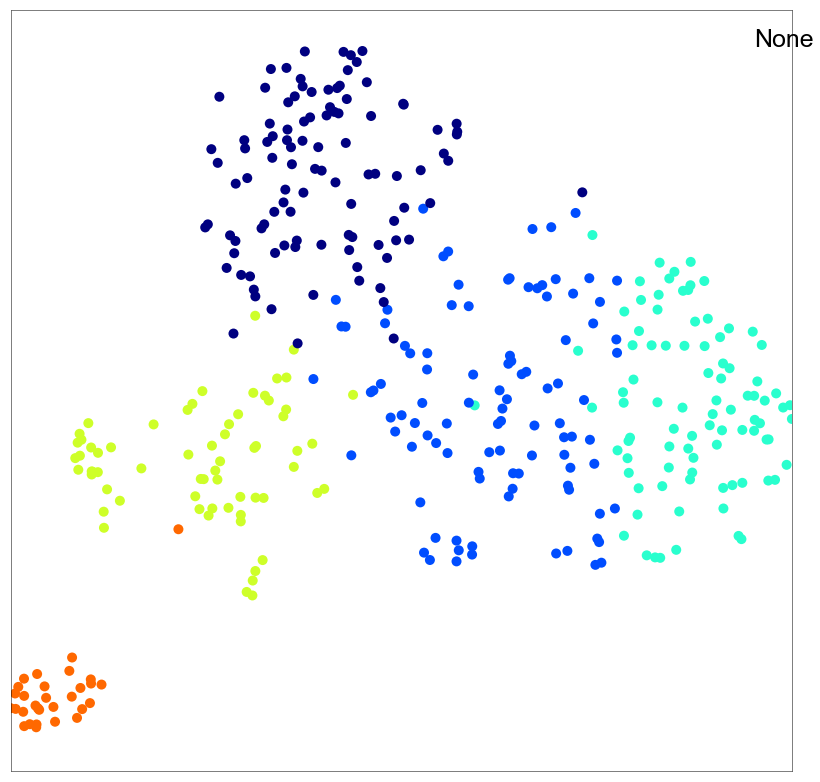

In [180]:
draw_tSNE(tsne_FIB_S, cl_c_FIB_S, number = None, cmap = plt.cm.jet)

## Compare AP and Seurat

In [181]:
c_sel = [c for c in cl_c_FIB_AP.index if c in cl_c_FIB_S.index]

In [182]:
seurat_vs_AP_FIB = seurat_vs_AP(cl_c_FIB_S[c_sel], cl_c_FIB_AP[c_sel])

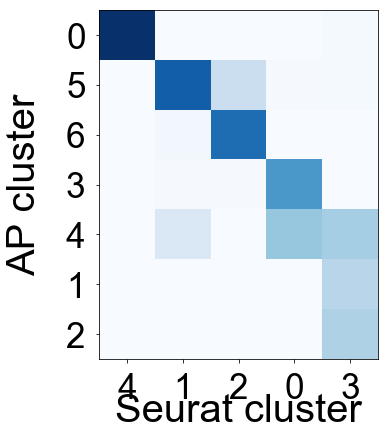

In [183]:
data = seurat_vs_AP_FIB

#generate figure

fig = plt.figure(facecolor = 'w', figsize = (len(data.columns), len(data.index)))
gs = plt.GridSpec(nrows = 2, ncols = 1, wspace=0.0, hspace=0.0, height_ratios=[1.0, 11.0])

#generate plot

ax = plt.subplot(gs[1])

#generate xaxis

ax.set_xlim(-0.5, len(data.columns) - 0.5)
ax.set_xticks(np.arange(0, len(data.columns)))
ax.set_xticklabels([c for c in data.columns], family = 'Arial', fontsize = 35)
ax.set_xlabel('Seurat cluster', family = 'Arial', fontsize = 40)
ax.xaxis.set_label_coords(0.5, -0.1)
ax.tick_params(axis='x', which='major', pad=10)

#generate yaxis

ax.set_ylim(len(data.index) -0.5, -0.5)
ax.set_yticks(np.arange(0, len(data.index)))
ax.set_yticklabels([ix for ix in data.index], family = 'Arial', fontsize = 35)
ax.set_ylabel('AP cluster', family = 'Arial', fontsize = 40)
ax.yaxis.set_label_coords(-0.2, 0.5)
ax.tick_params(axis='y', which='major', pad=10)

#plot data

ax.imshow(data.astype(float),
          cmap = plt.cm.Blues,
          aspect = 'auto',
          interpolation = 'nearest',
          vmin = 0, vmax = 1)

## Use AP clustering since it divided subpopulations in a finer manner (see e.g. difference between DP and DS in AP clustering)

In [184]:
cl_c_FIB = pd.Series(['FIB - %s' % cl for cl in cl_c_FIB_AP], index = cl_c_FIB_AP.index)

In [185]:
Counter(cl_c_FIB)

Counter({'FIB - 0': 31,
         'FIB - 1': 19,
         'FIB - 2': 21,
         'FIB - 3': 63,
         'FIB - 4': 77,
         'FIB - 5': 103,
         'FIB - 6': 71})

In [186]:
cmap_FIB = {'FIB - 0': '#7570b3',
            'FIB - 1': '#e78ac3',
            'FIB - 2': '#e7298a',
            'FIB - 3': '#d7191c',
            'FIB - 4': '#fdae61',
            'FIB - 5': '#abdda4',
            'FIB - 6': '#2b83ba'}

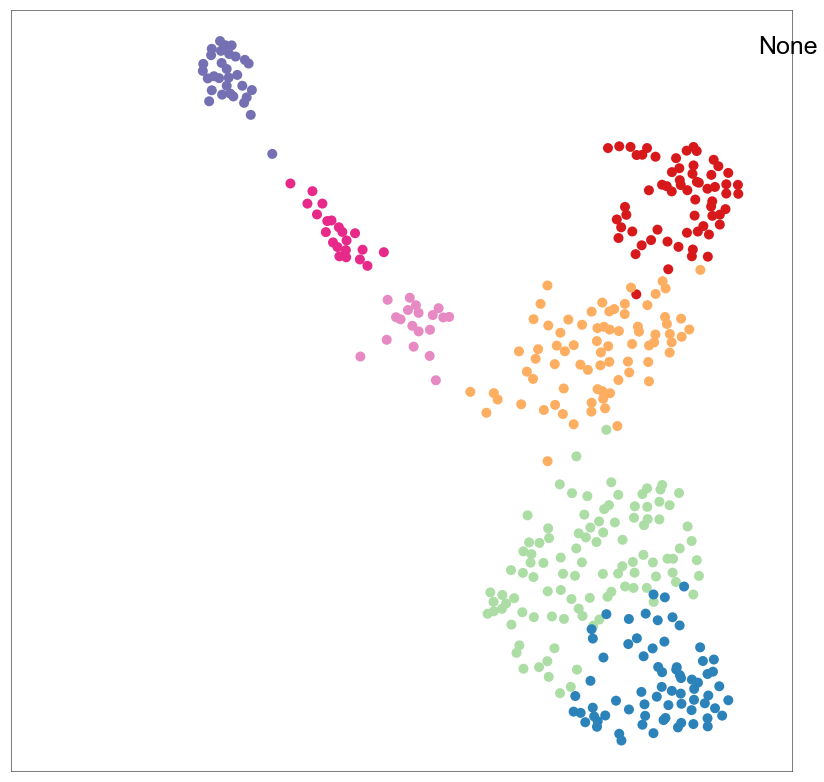

In [187]:
draw_tSNE(umap_FIB, cl_c_FIB, number = None, cmap = cmap_FIB, pad = 2)

In [188]:
cl_c_FIB = AP_order_incluster(dist_c_FIB.loc[cl_c_FIB.index, cl_c_FIB.index], cl_c_FIB, method='ward', metric='euclidean')

In [189]:
cl_c_FIB = AP_groups_reorder_v2(cl_c_FIB, ['FIB - 6','FIB - 5','FIB - 4','FIB - 3','FIB - 1','FIB - 2','FIB - 0',])

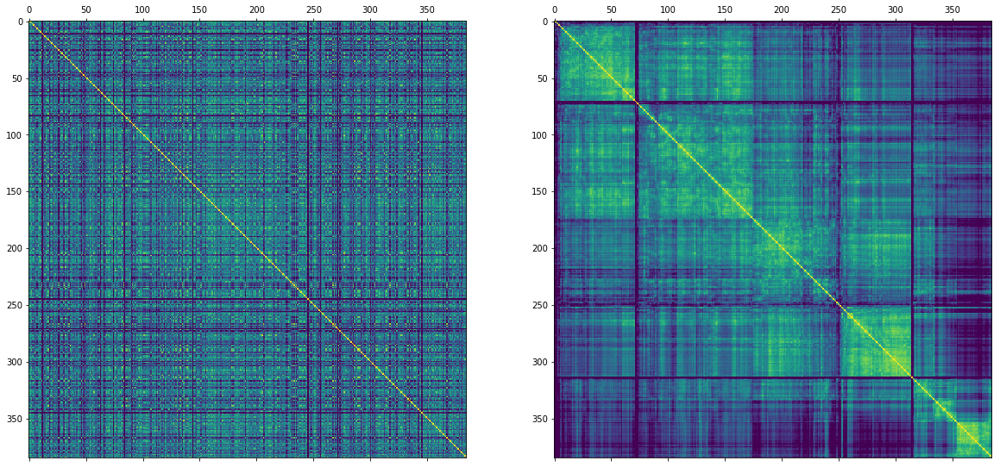

In [190]:
draw_AP_dist_mat(dist_c_FIB.loc[cl_c_FIB.index, cl_c_FIB.index], cl_c_FIB, cmap = plt.cm.viridis_r, vmin = 0, vmax = 25.0)

### Checkpoint

In [191]:
#saveData_v1(cl_c_FIB, path_output, exp_id, 'cl_c_FIB')

In [192]:
cl_c_FIB = loadData_v1(path_output, exp_id, 'cl_c_FIB', 'Series')
umap_FIB = loadData_v1(path_output, exp_id, 'umap_FIB', 'DataFrame')

# Immune cell subclustering with Affinity Propagation

## Include the cells with immune characteristics removed from the epidermis subclustering. Remove cells which have both keratinocyte and immune markers (doublets).

In [256]:
c_sel_EPI_IMM = cl_c_1st[cl_c_1st=='EPI'].index

In [257]:
c_rem_EPI_IMM = remove_cells(seqN[c_sel_EPI_IMM], 
                         ['Cd207','Cd74','Cd3e','Cd52','Cd83'], 
                         [2,25,2,2,2])

In [258]:
len(c_rem_EPI_IMM)

74

In [259]:
c_sel_IMM = list(cl_c_1st[cl_c_1st=='IMM'].index) + c_rem_EPI_IMM

In [260]:
len(c_sel_IMM)

360

In [261]:
c_rem_IMM = remove_cells(seqN[c_sel_IMM], 
                         ['Krt14','Krt5','Krt1','Krt10'], 
                         [10,5,5,5,5])

In [262]:
len(c_rem_IMM)

143

In [263]:
c_sel_IMM = [c for c in c_sel_IMM if c not in c_rem_IMM]

In [264]:
len(c_sel_IMM)

217

## Feature selection


Dropping unexpressed genes from dataset

After mean expression cutoff of 0.025, 7404 genes remain

After high variance feature selection, 2500 genes remain


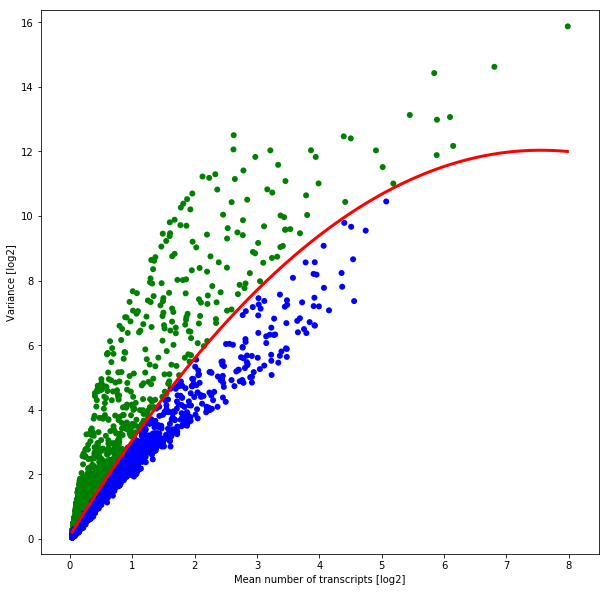

In [265]:
seq_sel_IMM = select_features_log2_var_polyfit_v2(seqN[c_sel_IMM], 0.025, 2500)

### Checkpoint

In [196]:
#saveData_v1(seq_sel_IMM, path_output, exp_id, 'seq_sel_IMM')

In [197]:
seq_sel_IMM = loadData_v1(path_output, exp_id, 'seq_sel_IMM', 'DataFrame')

## Dimensionality reduction with PCA

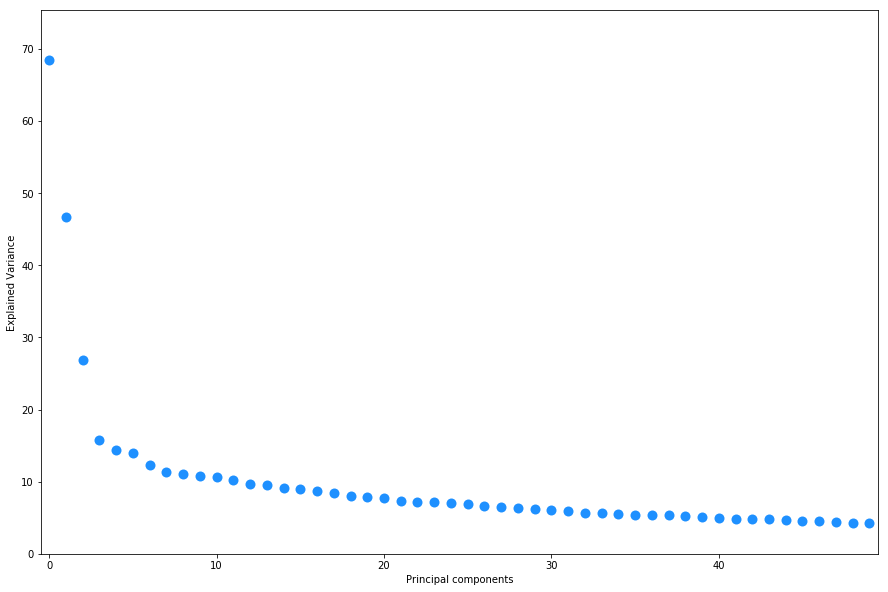

In [217]:
pca_explained_var(seq_sel_IMM)

In [218]:
seq_sel_IMM_pca, dist_c_IMM = dim_reduc_pca(seq_sel_IMM, 15, 'euclidean', inverse_transform = False)

In [219]:
aff_c_IMM = -dist_c_IMM

## Umap embedding of PCs

In [271]:
scdata_IMM = to_scanpy(seq_sel_IMM)

In [272]:
sc.pp.pca(scdata_IMM, n_comps = 15)

In [273]:
sc.pp.neighbors(scdata_IMM, n_neighbors=20, n_pcs=15, method = 'umap')

/Users/simjoo/anaconda/lib/python3.6/site-packages/scanpy/neighbors/__init__.py:121: RuntimeWarning: invalid value encountered in sqrt
  distances = np.sqrt(distances)


In [274]:
sc.tl.umap(scdata_IMM, min_dist = 0.5, spread = 10)

/Users/simjoo/anaconda/lib/python3.6/site-packages/scanpy/neighbors/umap/umap_.py:1173: RuntimeWarning: divide by zero encountered in power
  return 1.0 / (1.0 + a * x ** (2 * b))


In [275]:
umap_IMM = pd.DataFrame(scdata_IMM.obsm['X_umap'], index = scdata_IMM.obs['CellID'], columns = ['x','y'])

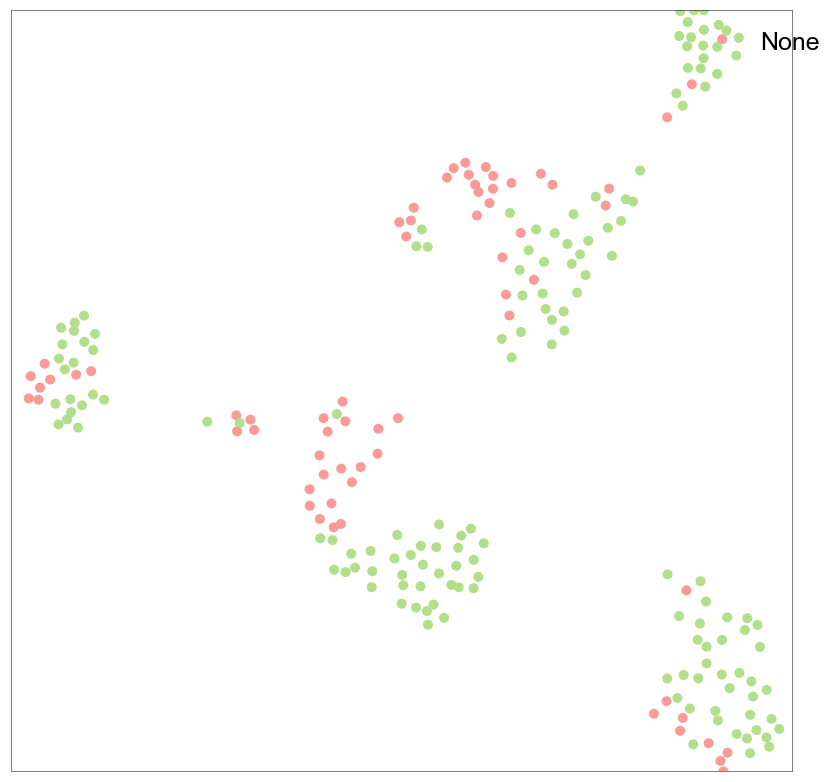

In [276]:
draw_tSNE(umap_IMM, cells_stage, number = None, cmap = {'5w':'#fb9a99','9w':'#b2df8a'})

## Cell clustering

In [305]:
cl_c_IMM_AP =  AP_clustering_v4P(aff_c_IMM, 0, -75, 0.75)

In [306]:
len(set(cl_c_IMM_AP))

5

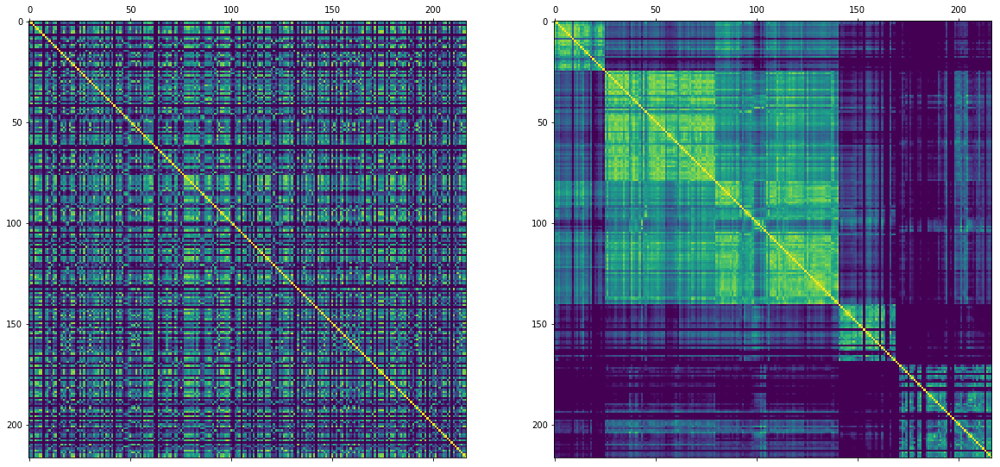

In [307]:
draw_AP_dist_mat(aff_c_IMM, cl_c_IMM_AP, cmap = plt.cm.viridis, vmin = -25.0, vmax = 0.0)

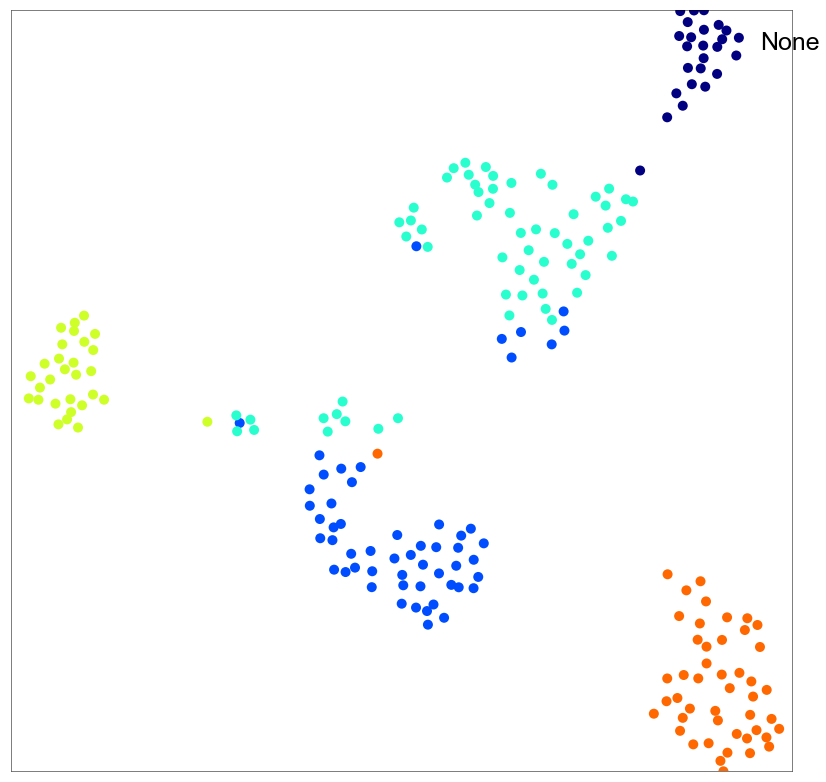

In [308]:
draw_tSNE(umap_IMM, cl_c_IMM_AP, number = None, cmap = plt.cm.jet)

## Consolidate clustering and tSNE by reassigning cluster outliers (less then 10 of 25 nearest neighbors in tSNE assigned to same cluster)

In [309]:
dist_IMM_ts = eucl_2d(umap_IMM)

In [310]:
cl_c_IMM_AP = smooth_clustering(dist_IMM_ts, cl_c_IMM_AP, 25, 10)

21/217 cells reassigned!


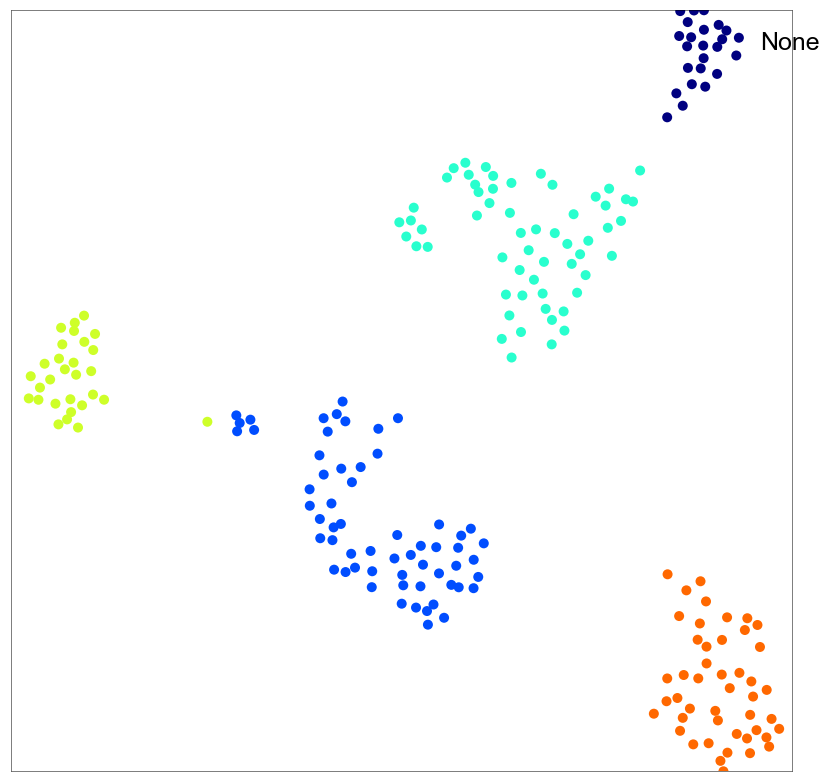

In [311]:
draw_tSNE(umap_IMM, cl_c_IMM_AP, number = None, cmap = plt.cm.jet)

## Manually divide spatial subclouds of clusters 1 and 2

In [312]:
c_sel = cl_c_IMM_AP[cl_c_IMM_AP==1].index
c_sel = [i for i in c_sel if umap_IMM.loc[i,'x'] < -20]

In [313]:
len(c_sel)

5

In [314]:
cl_c_IMM_AP[c_sel] = 5

In [315]:
c_sel = cl_c_IMM_AP[cl_c_IMM_AP==3].index
c_sel = [i for i in c_sel if umap_IMM.loc[i,'x'] > -30]

In [316]:
len(c_sel)

1

In [317]:
cl_c_IMM_AP[c_sel] = 5

In [318]:
c_sel = cl_c_IMM_AP[cl_c_IMM_AP==2].index
c_sel = [i for i in c_sel if umap_IMM.loc[i,'x'] < -4]

In [319]:
len(c_sel)

7

In [320]:
cl_c_IMM_AP[c_sel] = 6

In [321]:
cl_c_IMM_AP = AP_groups_reorder_v2(cl_c_IMM_AP, range(7))

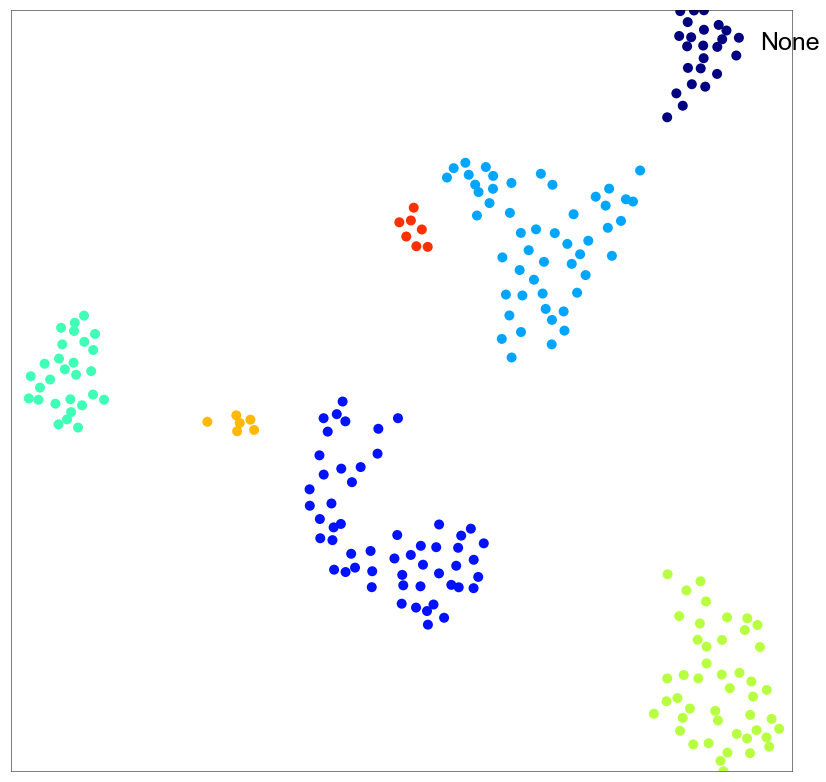

In [124]:
draw_tSNE(umap_IMM, cl_c_IMM_AP, number = None, cmap = plt.cm.jet)

## Consultation with an immunologist revealed that cluster #6 is very likely made up of doublets (T-cell, dendritic cell)

In [162]:
cl_c_IMM_AP = cl_c_IMM_AP[cl_c_IMM_AP!=6]

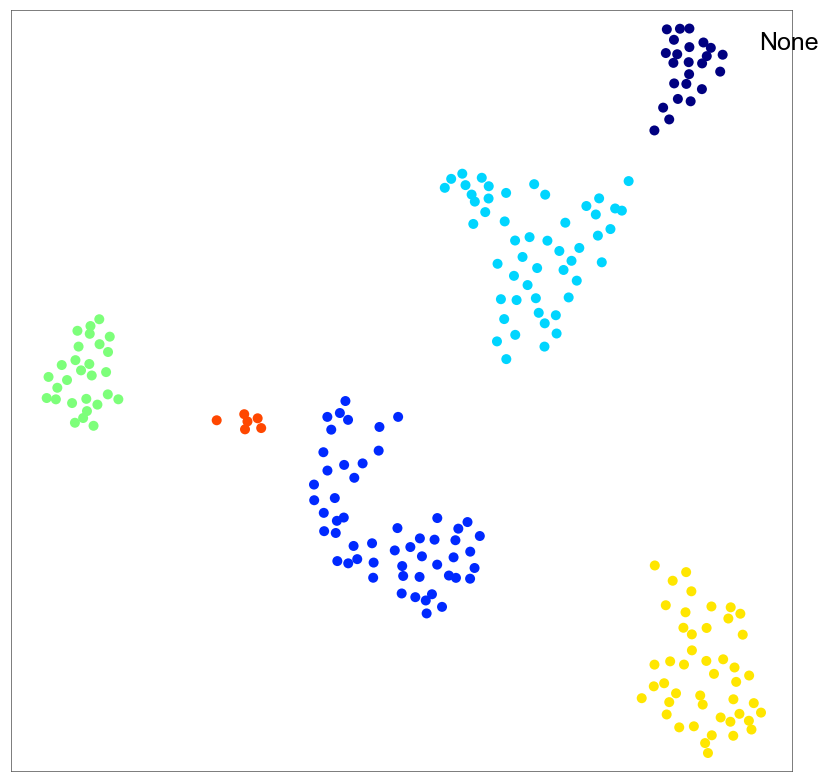

In [201]:
draw_tSNE(umap_IMM, cl_c_IMM_AP, number = None, cmap = plt.cm.jet, pad = 2)

## Checkpoint

In [202]:
#saveData_v1(umap_IMM, path_output, exp_id, 'umap_IMM')
#saveData_v1(cl_c_IMM_AP, path_output, exp_id, 'cl_c_IMM_AP')

In [203]:
umap_IMM = loadData_v1(path_output, exp_id, 'umap_IMM', 'DataFrame')
cl_c_IMM_AP = loadData_v1(path_output, exp_id, 'cl_c_IMM_AP', 'Series')

# Immune cell subclustering with Seurat

## Import clustering and tSNE data

In [204]:
cl_c_IMM_S = pd.read_csv('%s/Seurat/TenX_2ndLevel_IMM_ClusterIdentity.txt' % path_output, sep = '\t', header = None, index_col = 0, 
                           low_memory = False, squeeze = True)

In [205]:
tsne_IMM_S = pd.read_csv('%s/Seurat/TenX_2ndLevel_IMM_TSNEcoordinates.txt' % path_output, sep = '\t', index_col = 0, header = 0)
tsne_IMM_S.columns = ['x','y']

In [206]:
c_sel = list(set(cl_c_IMM_S.index) & set(cl_c_IMM_AP.index))

In [207]:
cl_c_IMM_S = cl_c_IMM_S[c_sel]

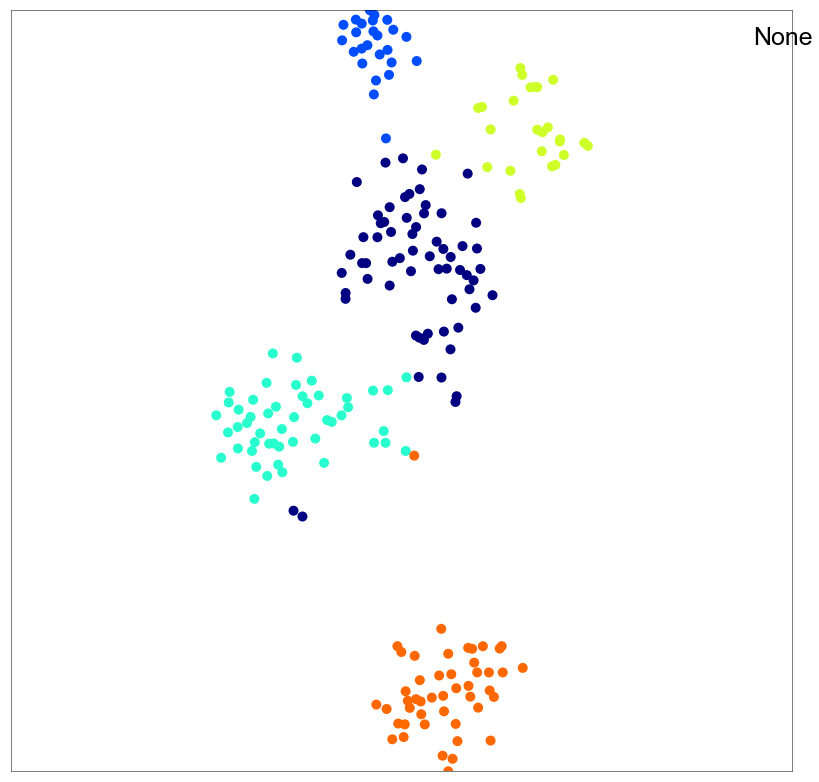

In [208]:
draw_tSNE(tsne_IMM_S, cl_c_IMM_S, number = None, cmap = plt.cm.jet)

## Compare AP and Seurat

In [209]:
seurat_vs_AP_IMM = seurat_vs_AP(cl_c_IMM_S[c_sel], cl_c_IMM_AP[c_sel])

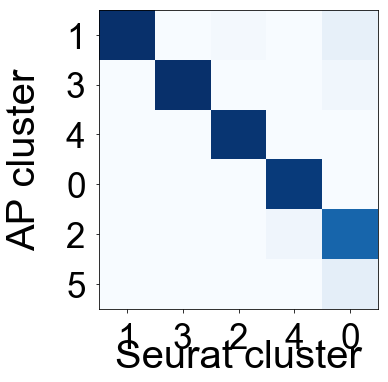

In [210]:
data = seurat_vs_AP_IMM

#generate figure

fig = plt.figure(facecolor = 'w', figsize = (len(data.columns), len(data.index)))
gs = plt.GridSpec(nrows = 2, ncols = 1, wspace=0.0, hspace=0.0, height_ratios=[1.0, 11.0])

#generate plot

ax = plt.subplot(gs[1])

#generate xaxis

ax.set_xlim(-0.5, len(data.columns) - 0.5)
ax.set_xticks(np.arange(0, len(data.columns)))
ax.set_xticklabels([c for c in data.columns], family = 'Arial', fontsize = 35)
ax.set_xlabel('Seurat cluster', family = 'Arial', fontsize = 40)
ax.xaxis.set_label_coords(0.5, -0.1)
ax.tick_params(axis='x', which='major', pad=10)

#generate yaxis

ax.set_ylim(len(data.index) -0.5, -0.5)
ax.set_yticks(np.arange(0, len(data.index)))
ax.set_yticklabels([ix for ix in data.index], family = 'Arial', fontsize = 35)
ax.set_ylabel('AP cluster', family = 'Arial', fontsize = 40)
ax.yaxis.set_label_coords(-0.2, 0.5)
ax.tick_params(axis='y', which='major', pad=10)

#plot data

ax.imshow(data.astype(float),
          cmap = plt.cm.Blues,
          aspect = 'auto',
          interpolation = 'nearest',
          vmin = 0, vmax = 1)

## Use AP clustering even though both approaches yield very similar results

In [211]:
cl_c_IMM = pd.Series(['IMM - %s' % cl for cl in cl_c_IMM_AP], index = cl_c_IMM_AP.index)

In [212]:
Counter(cl_c_IMM)

Counter({'IMM - 0': 24,
         'IMM - 1': 55,
         'IMM - 2': 51,
         'IMM - 3': 28,
         'IMM - 4': 46,
         'IMM - 5': 6})

In [213]:
cmap_IMM = {'IMM - 0': '#e7298a',
            'IMM - 1': '#33a02c',
            'IMM - 2': '#6a3d9a',
            'IMM - 3': '#1f78b4',
            'IMM - 4': '#d95f02',
            'IMM - 5': '#b2df8a',
            'IMM - 6': '#cab2d6',}

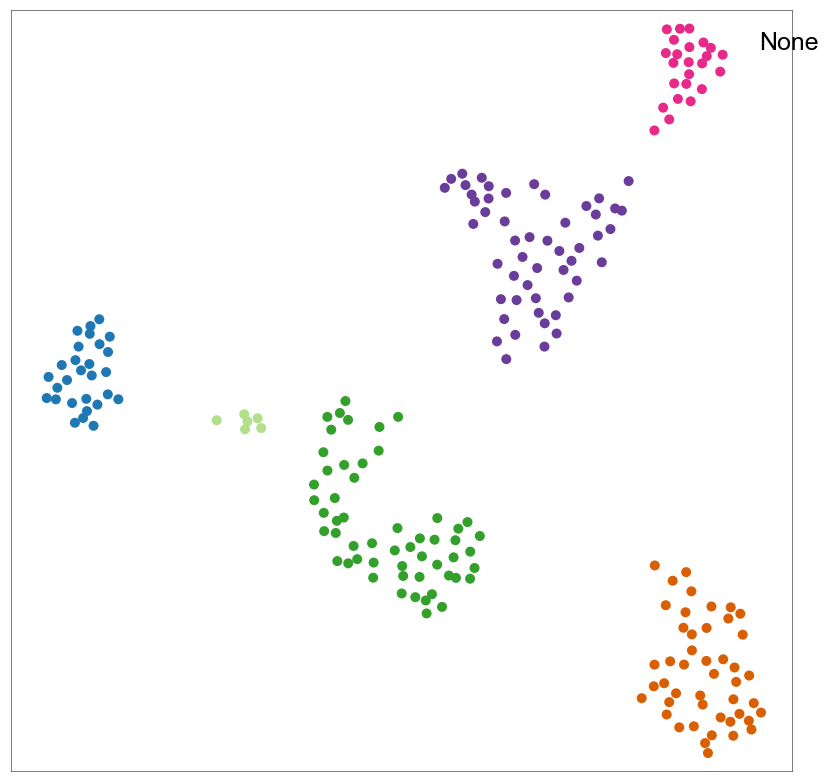

In [214]:
draw_tSNE(umap_IMM, cl_c_IMM, number = None, cmap = cmap_IMM, pad = 2)

In [220]:
cl_c_IMM = AP_order_incluster(dist_c_IMM.loc[cl_c_IMM.index, cl_c_IMM.index], cl_c_IMM, method='ward', metric='euclidean')

In [221]:
cl_c_IMM = AP_groups_reorder_v2(cl_c_IMM, ['IMM - 3','IMM - 4','IMM - 1','IMM - 5','IMM - 2','IMM - 0'])

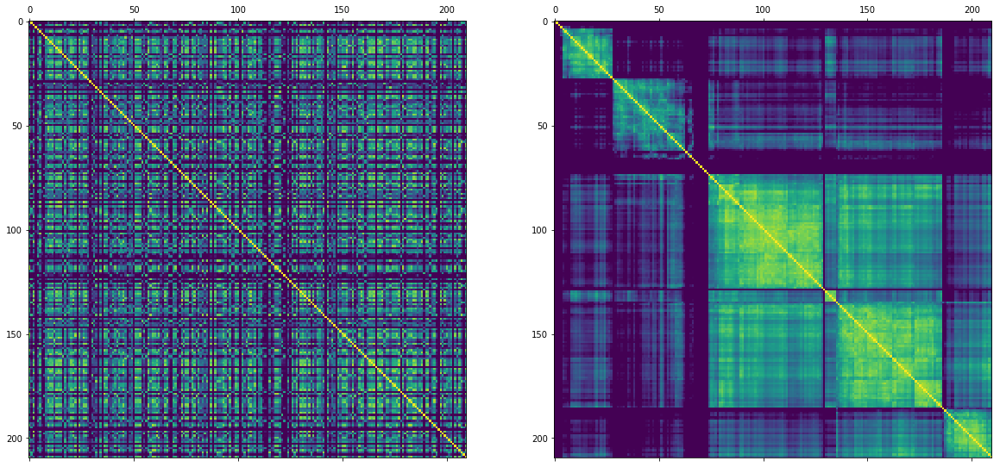

In [222]:
draw_AP_dist_mat(dist_c_IMM.loc[cl_c_IMM.index, cl_c_IMM.index], cl_c_IMM, cmap = plt.cm.viridis_r, vmin = 0, vmax = 25.0)

### Checkpoint

In [223]:
#saveData_v1(cl_c_IMM, path_output, exp_id, 'cl_c_IMM')

In [224]:
cl_c_IMM = loadData_v1(path_output, exp_id, 'cl_c_IMM', 'Series')

# Vascular cell subclustering with Affinity Propagation

## Remove cells which have immune markers (doublets or misclustered).

In [221]:
c_sel_VASC = list(cl_c_1st[cl_c_1st=='VASC'].index) + c_FIB_to_VASC

In [222]:
len(c_sel_VASC)

170

In [225]:
c_rem_VASC = remove_cells(seqN[c_sel_VASC], 
                         ['Cd207','Cd74','Cd3e','Cd52','Cd83'], 
                         [2,25,2,2,2])

In [226]:
len(c_rem_VASC)

5

In [227]:
c_sel_VASC = [c for c in c_sel_VASC if c not in c_rem_VASC]

In [228]:
len(c_sel_VASC)

165

## Feature selection


Dropping unexpressed genes from dataset

After mean expression cutoff of 0.025, 9059 genes remain

After high variance feature selection, 2500 genes remain


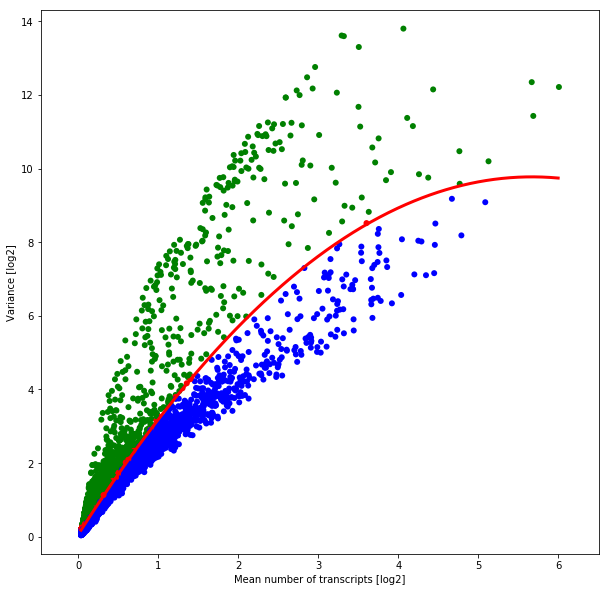

In [229]:
seq_sel_VASC = select_features_log2_var_polyfit_v2(seqN[c_sel_VASC], 0.025, 2500)

### Checkpoint

In [226]:
#saveData_v1(seq_sel_VASC, path_output, exp_id, 'seq_sel_VASC')

In [227]:
seq_sel_VASC = loadData_v1(path_output, exp_id, 'seq_sel_VASC', 'DataFrame')

## Dimensionality reduction with PCA

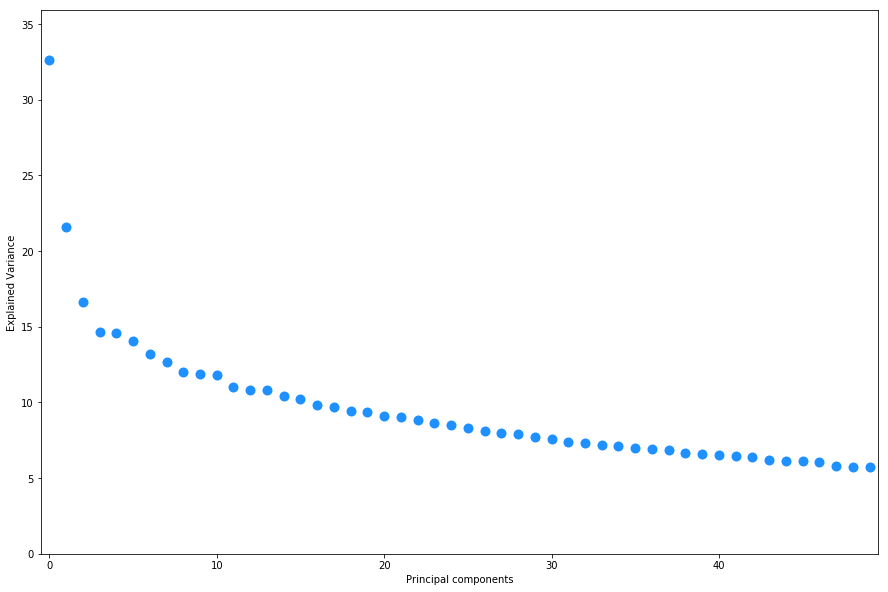

In [228]:
pca_explained_var(seq_sel_VASC)

In [229]:
seq_sel_VASC_pca, dist_c_VASC = dim_reduc_pca(seq_sel_VASC, 8, 'euclidean', inverse_transform = False)

In [230]:
aff_c_VASC = -dist_c_VASC

## Umap embedding of PCs

In [238]:
scdata_VASC = to_scanpy(seq_sel_VASC)

In [239]:
sc.pp.pca(scdata_VASC, n_comps = 8)

In [240]:
sc.pp.neighbors(scdata_VASC, n_neighbors=20, n_pcs=8, method = 'umap')

/Users/simjoo/anaconda/lib/python3.6/site-packages/scanpy/neighbors/__init__.py:123: RuntimeWarning: invalid value encountered in sqrt
  distances = np.sqrt(distances)


In [241]:
sc.tl.umap(scdata_VASC, min_dist = 0.5, spread = 5)

/Users/simjoo/anaconda/lib/python3.6/site-packages/scanpy/neighbors/umap/umap_.py:1173: RuntimeWarning: divide by zero encountered in power
  return 1.0 / (1.0 + a * x ** (2 * b))


In [242]:
umap_VASC = pd.DataFrame(scdata_VASC.obsm['X_umap'], index = scdata_VASC.obs['CellID'], columns = ['x','y'])

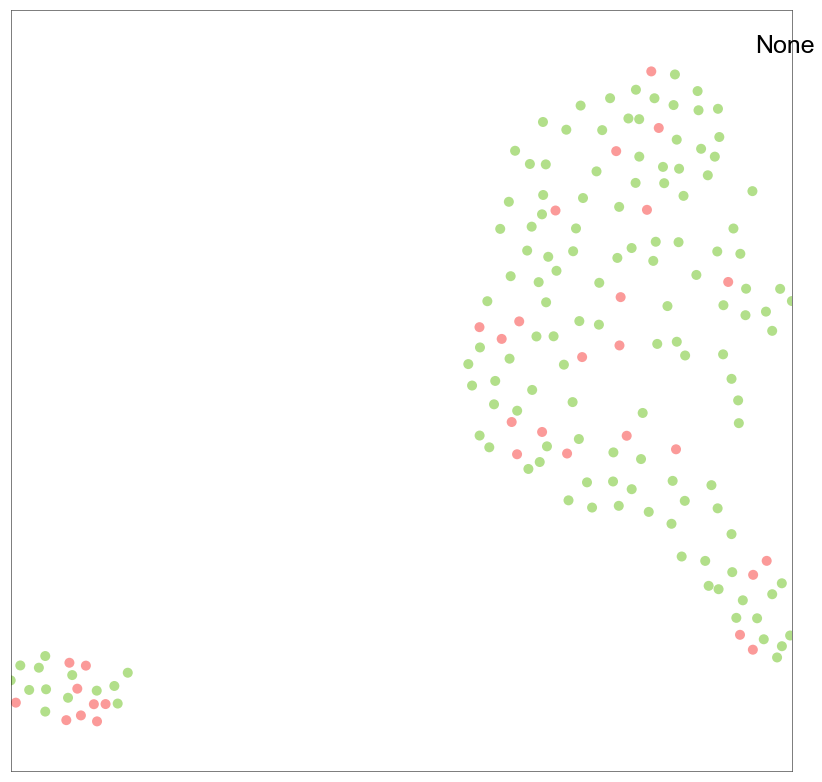

In [247]:
draw_tSNE(umap_VASC, cells_stage, number = None, cmap = {'5w':'#fb9a99','9w':'#b2df8a'})

## Cell clustering

In [248]:
cl_c_VASC_AP =  AP_clustering_v4P(aff_c_VASC, 0, -75, 0.75)

In [249]:
len(set(cl_c_VASC_AP))

4

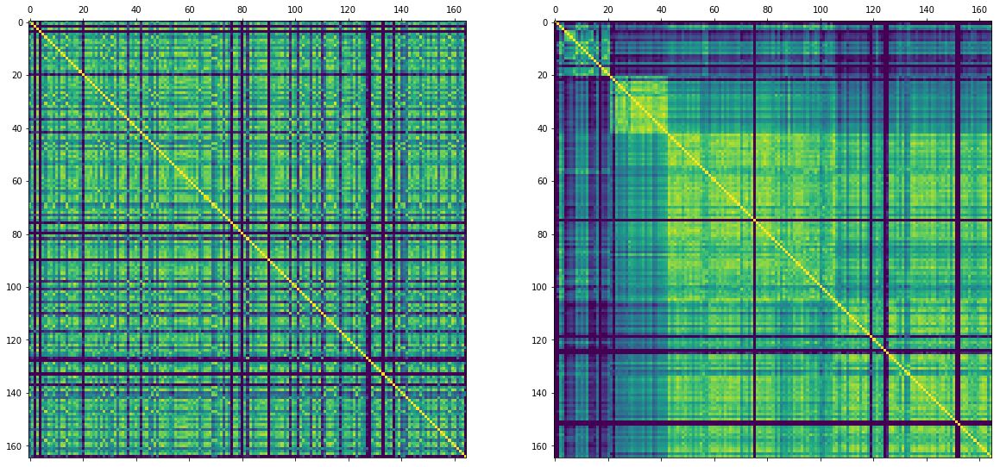

In [250]:
draw_AP_dist_mat(aff_c_VASC, cl_c_VASC_AP, cmap = plt.cm.viridis, vmin = -25.0, vmax = 0.0)

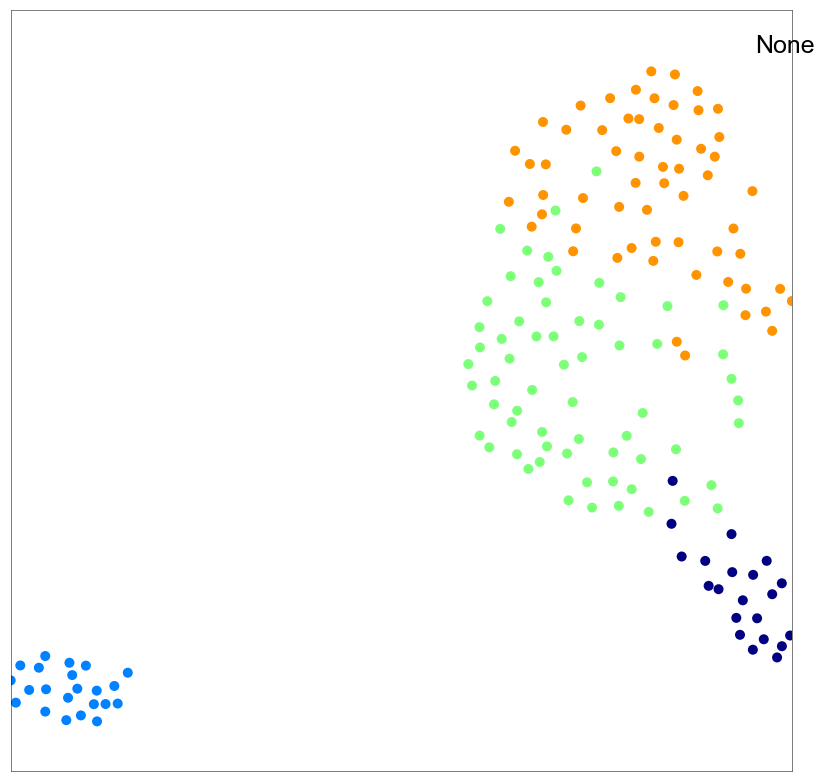

In [251]:
draw_tSNE(umap_VASC, cl_c_VASC_AP, number = None, cmap = plt.cm.jet)

## Consolidate clustering and tSNE by reassigning cluster outliers (less then 10 of 25 nearest neighbors in tSNE assigned to same cluster)

In [255]:
dist_VASC_ts = eucl_2d(umap_VASC)

In [256]:
cl_c_VASC_AP = smooth_clustering(dist_VASC_ts, cl_c_VASC_AP, 25, 10)

6/165 cells reassigned!


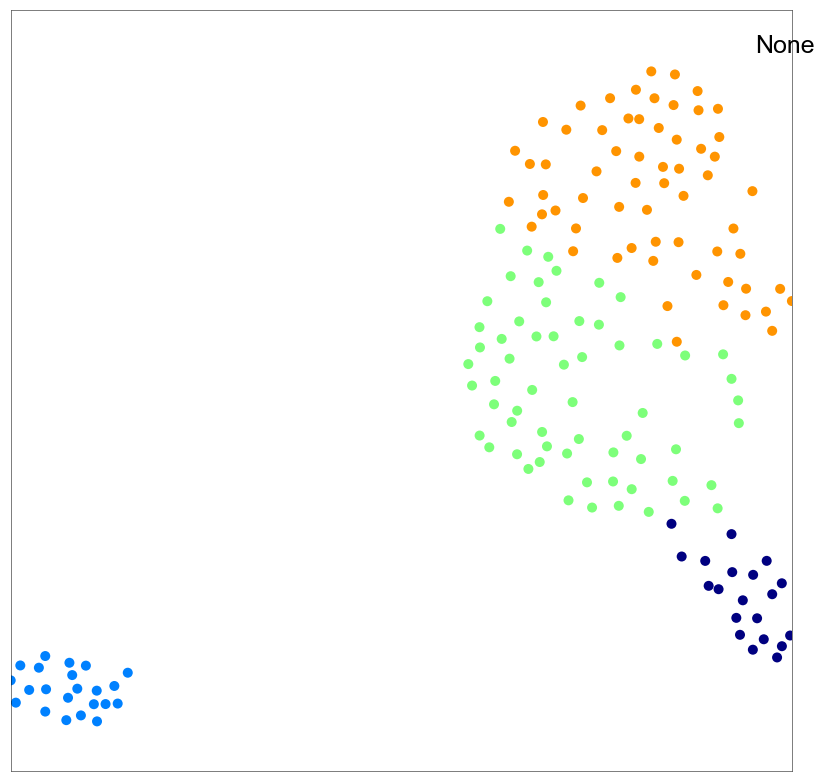

In [232]:
draw_tSNE(umap_VASC, cl_c_VASC_AP, number = None, cmap = plt.cm.jet)

### Checkpoint

In [233]:
#saveData_v1(umap_VASC, path_output, exp_id, 'umap_VASC')
#saveData_v1(cl_c_VASC_AP, path_output, exp_id, 'cl_c_VASC_AP')

In [231]:
umap_VASC = loadData_v1(path_output, exp_id, 'umap_VASC', 'DataFrame')
cl_c_VASC_AP = loadData_v1(path_output, exp_id, 'cl_c_VASC_AP', 'Series')

# Vascular cell subclustering with Seurat

## Import clustering and tSNE data

In [234]:
cl_c_VASC_S = pd.read_csv('%s/Seurat/TenX_2ndLevel_VASC_ClusterIdentity.txt' % path_output, sep = '\t', header = None, index_col = 0, 
                           low_memory = False, squeeze = True)

In [235]:
tsne_VASC_S = pd.read_csv('%s/Seurat/TenX_2ndLevel_VASC_TSNEcoordinates.txt' % path_output, sep = '\t', index_col = 0, header = 0)
tsne_VASC_S.columns = ['x','y']

In [236]:
c_sel = list(set(cl_c_VASC_S.index) & set(cl_c_VASC_AP.index))

In [237]:
cl_c_VASC_S = cl_c_VASC_S[c_sel]

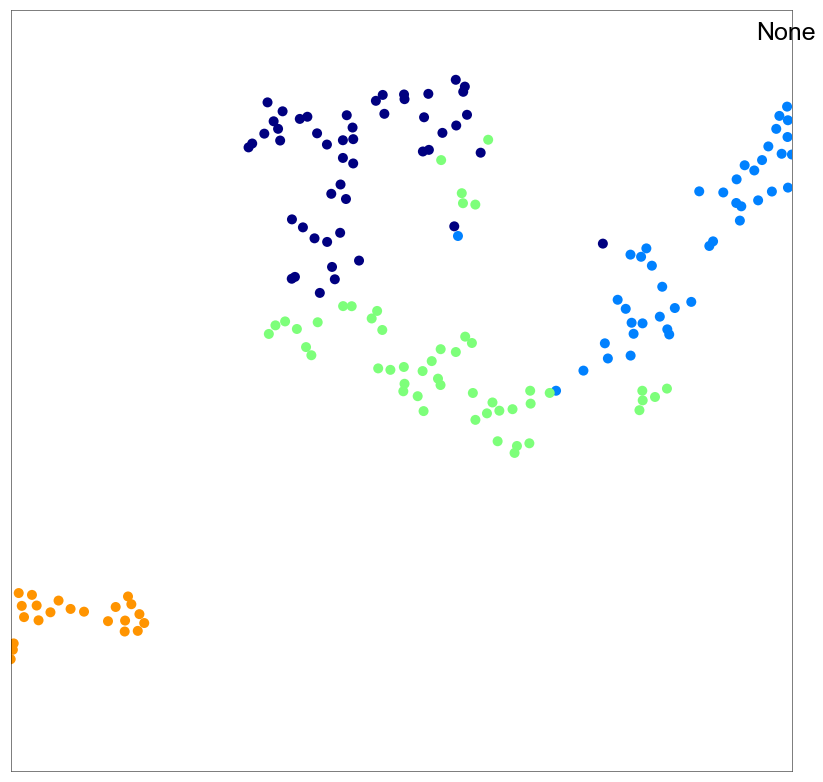

In [238]:
draw_tSNE(tsne_VASC_S, cl_c_VASC_S, number = None, cmap = plt.cm.jet)

## Compare AP and Seurat

In [239]:
seurat_vs_AP_VASC = seurat_vs_AP(cl_c_VASC_S[c_sel], cl_c_VASC_AP[c_sel])

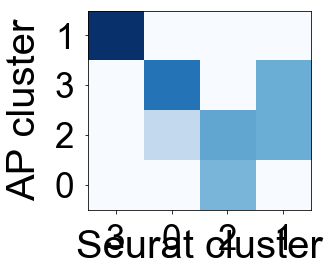

In [240]:
data = seurat_vs_AP_VASC

#generate figure

fig = plt.figure(facecolor = 'w', figsize = (len(data.columns), len(data.index)))
gs = plt.GridSpec(nrows = 2, ncols = 1, wspace=0.0, hspace=0.0, height_ratios=[1.0, 11.0])

#generate plot

ax = plt.subplot(gs[1])

#generate xaxis

ax.set_xlim(-0.5, len(data.columns) - 0.5)
ax.set_xticks(np.arange(0, len(data.columns)))
ax.set_xticklabels([c for c in data.columns], family = 'Arial', fontsize = 35)
ax.set_xlabel('Seurat cluster', family = 'Arial', fontsize = 40)
ax.xaxis.set_label_coords(0.5, -0.1)
ax.tick_params(axis='x', which='major', pad=10)

#generate yaxis

ax.set_ylim(len(data.index) -0.5, -0.5)
ax.set_yticks(np.arange(0, len(data.index)))
ax.set_yticklabels([ix for ix in data.index], family = 'Arial', fontsize = 35)
ax.set_ylabel('AP cluster', family = 'Arial', fontsize = 40)
ax.yaxis.set_label_coords(-0.2, 0.5)
ax.tick_params(axis='y', which='major', pad=10)

#plot data

ax.imshow(data.astype(float),
          cmap = plt.cm.Blues,
          aspect = 'auto',
          interpolation = 'nearest',
          vmin = 0, vmax = 1)

## Use AP clustering 

In [241]:
cl_c_VASC = pd.Series(['VASC - %s' % cl for cl in cl_c_VASC_AP], index = cl_c_VASC_AP.index)

In [242]:
Counter(cl_c_VASC)

Counter({'VASC - 0': 20, 'VASC - 1': 22, 'VASC - 2': 61, 'VASC - 3': 62})

In [243]:
cmap_VASC = {'VASC - 0': '#1f78b4',
             'VASC - 1': '#e31a1c',
             'VASC - 2': '#b2df8a',
             'VASC - 3': '#33a02c'}

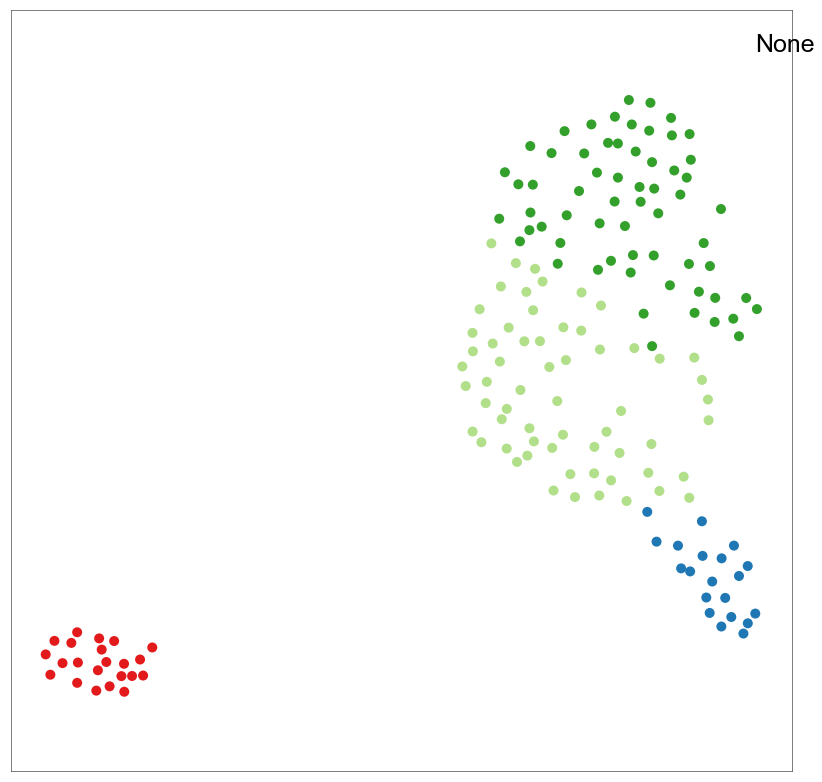

In [244]:
draw_tSNE(umap_VASC, cl_c_VASC, number = None, cmap = cmap_VASC, pad = 2)

In [245]:
cl_c_VASC = AP_order_incluster(dist_c_VASC.loc[cl_c_VASC.index, cl_c_VASC.index], cl_c_VASC, method='ward', metric='euclidean')

In [246]:
cl_c_VASC = AP_groups_reorder_v2(cl_c_VASC, ['VASC - 3','VASC - 2','VASC - 0', 'VASC - 1'])

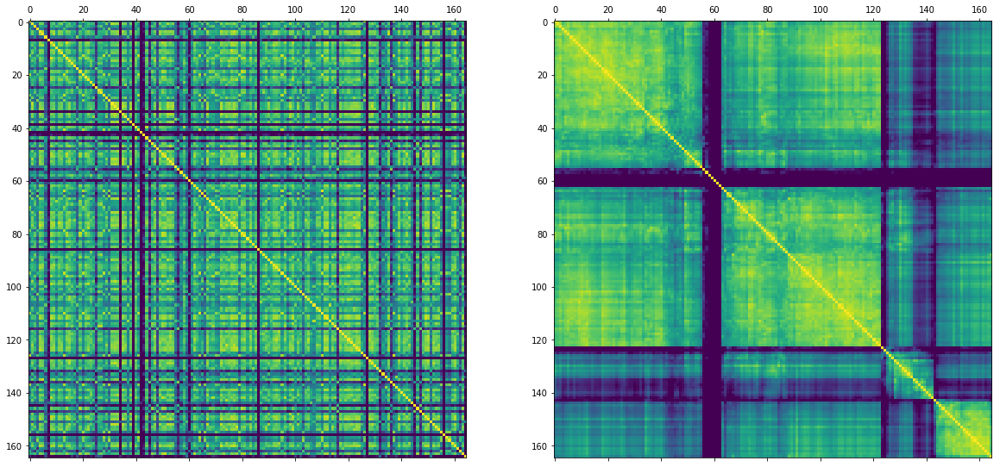

In [247]:
draw_AP_dist_mat(dist_c_VASC.loc[cl_c_VASC.index, cl_c_VASC.index], cl_c_VASC, cmap = plt.cm.viridis_r, vmin = 0, vmax = 25.0)

### Checkpoint

In [248]:
#saveData_v1(cl_c_VASC, path_output, exp_id, 'cl_c_VASC')

In [249]:
cl_c_VASC = loadData_v1(path_output, exp_id, 'cl_c_VASC', 'Series')

# Neural crest derived cell subclustering with Affinity Propagation

## Remove cells which have immune or keratinocyte markers (doublets or misclustered).

In [401]:
c_sel_MEL = cl_c_1st[cl_c_1st=='MEL'].index

In [402]:
len(c_sel_MEL)

163

In [403]:
c_rem_MEL = remove_cells(seqN[c_sel_MEL], 
                         ['Cd207','Cd74','Cd3e','Cd52','Cd83','Krt14','Krt5','Krt10'], 
                         [2,2,2,2,2,10,5,5])

In [404]:
len(c_rem_MEL)

19

In [405]:
c_sel_MEL = [c for c in c_sel_MEL if c not in c_rem_MEL]

In [406]:
len(c_sel_MEL)

144

## Feature selection


Dropping unexpressed genes from dataset

After mean expression cutoff of 0.025, 8058 genes remain

After high variance feature selection, 2500 genes remain


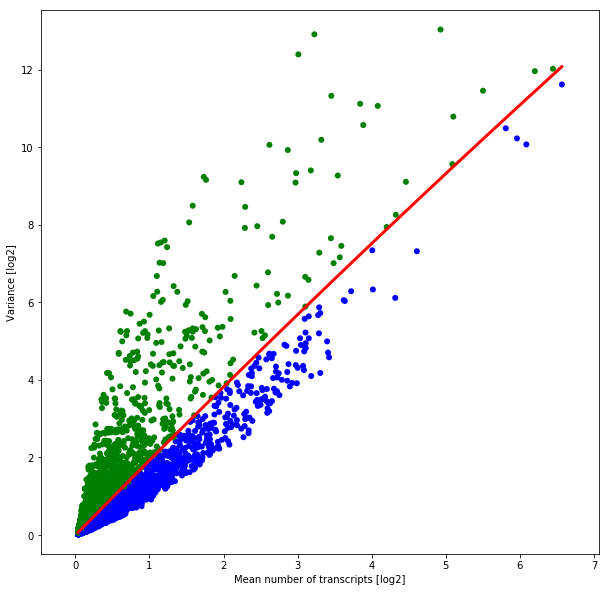

In [407]:
seq_sel_MEL = select_features_log2_var_polyfit_v2(seqN[c_sel_MEL], 0.025, 2500)

### Checkpoint

In [251]:
#saveData_v1(seq_sel_MEL, path_output, exp_id, 'seq_sel_MEL')

In [252]:
seq_sel_MEL = loadData_v1(path_output, exp_id, 'seq_sel_MEL', 'DataFrame')

## Dimensionality reduction with PCA

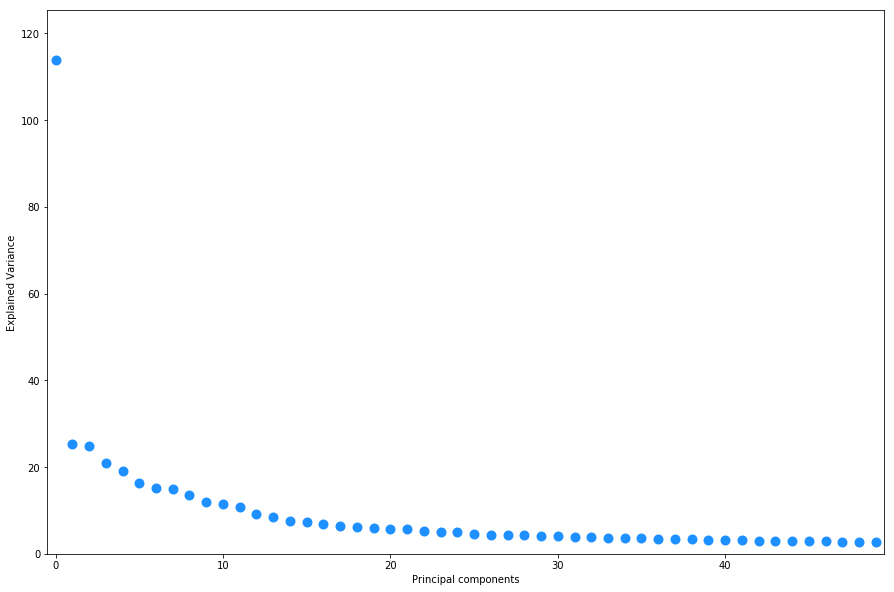

In [253]:
pca_explained_var(seq_sel_MEL)

In [254]:
seq_sel_MEL_pca, dist_c_MEL = dim_reduc_pca(seq_sel_MEL, 15, 'euclidean', inverse_transform = False)

In [255]:
aff_c_MEL = -dist_c_MEL

## Umap embedding of PCs

In [413]:
scdata_MEL = to_scanpy(seq_sel_MEL)

In [414]:
sc.pp.pca(scdata_MEL, n_comps = 15)

In [415]:
sc.pp.neighbors(scdata_MEL, n_neighbors=20, n_pcs=15, method = 'umap')

/Users/simjoo/anaconda/lib/python3.6/site-packages/scanpy/neighbors/__init__.py:121: RuntimeWarning: invalid value encountered in sqrt
  distances = np.sqrt(distances)


In [416]:
sc.tl.umap(scdata_MEL, min_dist = 0.5, spread = 5)

/Users/simjoo/anaconda/lib/python3.6/site-packages/scanpy/neighbors/umap/umap_.py:1173: RuntimeWarning: divide by zero encountered in power
  return 1.0 / (1.0 + a * x ** (2 * b))


In [417]:
umap_MEL = pd.DataFrame(scdata_MEL.obsm['X_umap'], index = scdata_MEL.obs['CellID'], columns = ['x','y'])

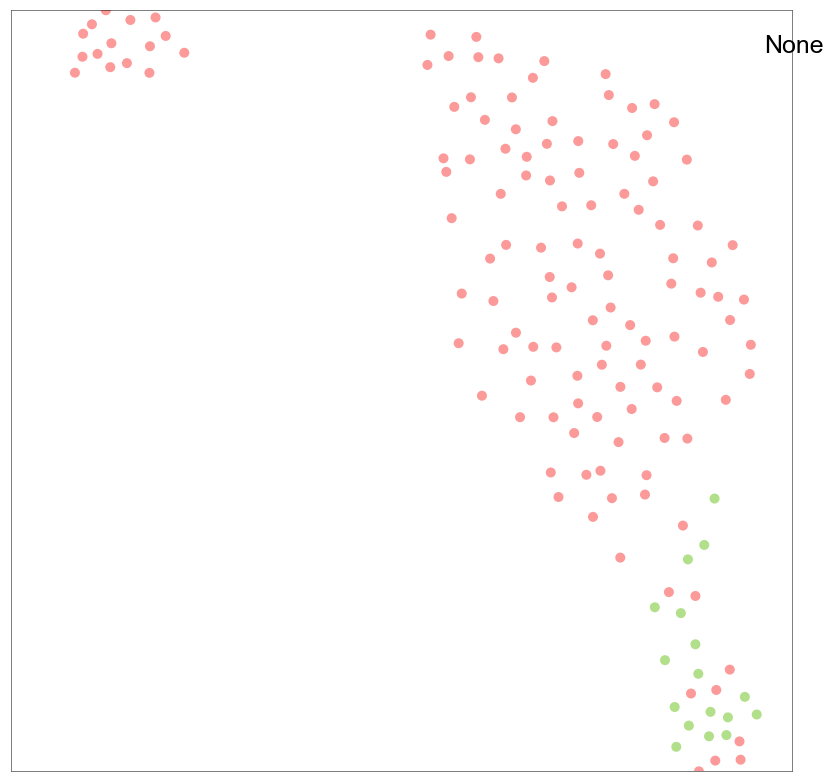

In [418]:
draw_tSNE(umap_MEL, cells_stage, number = None, cmap = {'5w':'#fb9a99','9w':'#b2df8a'})

## Cell clustering

In [419]:
cl_c_MEL_AP =  AP_clustering_v4P(aff_c_MEL, 0, -75, 0.85)

In [420]:
len(set(cl_c_MEL_AP))

3

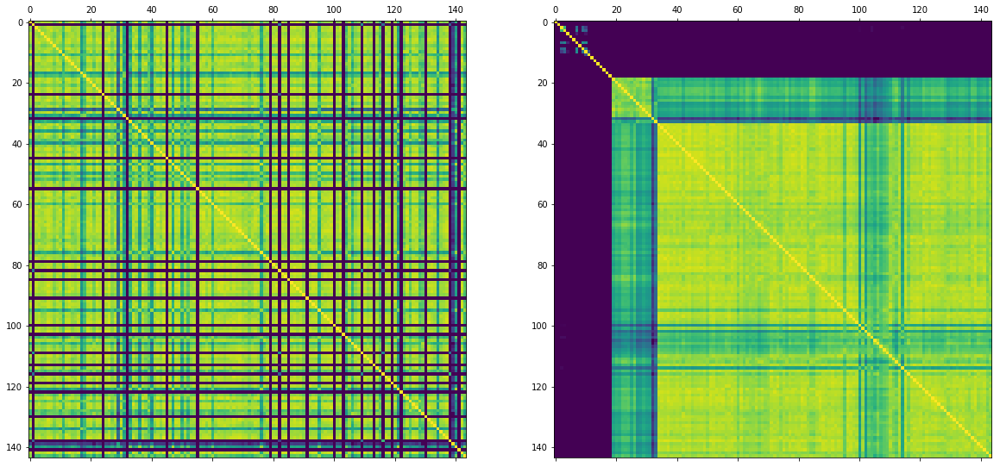

In [421]:
draw_AP_dist_mat(aff_c_MEL, cl_c_MEL_AP, cmap = plt.cm.viridis, vmin = -25.0, vmax = 0.0)

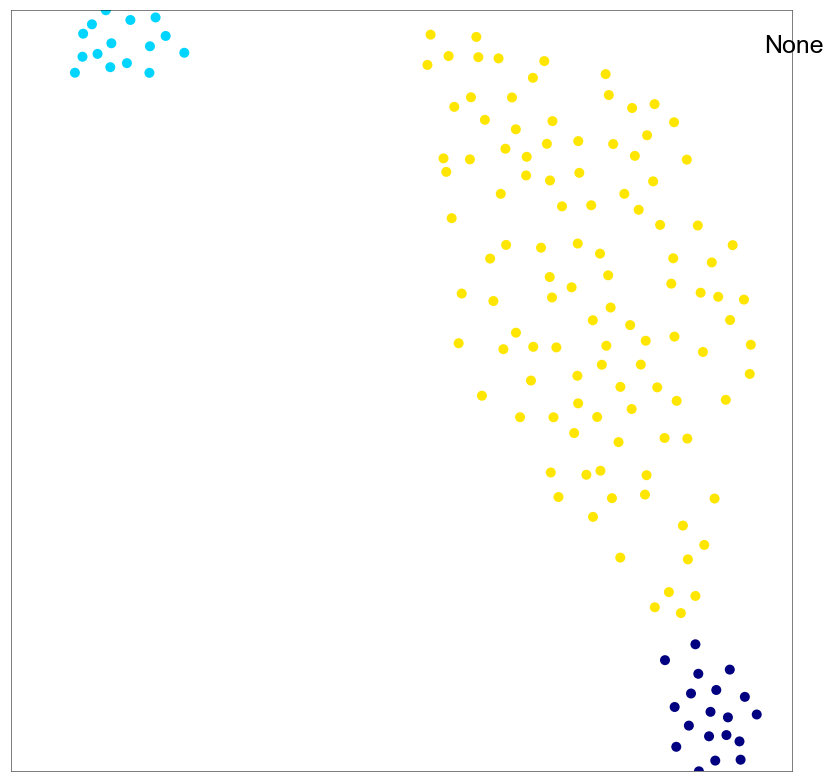

In [257]:
draw_tSNE(umap_MEL, cl_c_MEL_AP, number = None, cmap = plt.cm.jet)

## Checkpoint

In [258]:
#saveData_v1(umap_MEL, path_output, exp_id, 'umap_MEL')
#saveData_v1(cl_c_MEL_AP, path_output, exp_id, 'cl_c_MEL_AP')

In [256]:
umap_MEL = loadData_v1(path_output, exp_id, 'umap_MEL', 'DataFrame')
cl_c_MEL_AP = loadData_v1(path_output, exp_id, 'cl_c_MEL_AP', 'Series')

# Neural crest derived subclustering with Seurat

## Import clustering data and tSNE

In [259]:
cl_c_MEL_S = pd.read_csv('%s/Seurat/TenX_2ndLevel_MEL_ClusterIdentity.txt' % path_output, sep = '\t', header = None, index_col = 0, 
                           low_memory = False, squeeze = True)

In [260]:
tsne_MEL_S = pd.read_csv('%s/Seurat/TenX_2ndLevel_MEL_TSNEcoordinates.txt' % path_output, sep = '\t', index_col = 0, header = 0)
tsne_MEL_S.columns = ['x','y']

In [261]:
c_sel = list(set(cl_c_MEL_S.index) & set(cl_c_MEL_AP.index))

In [262]:
cl_c_MEL_S = cl_c_MEL_S[c_sel]

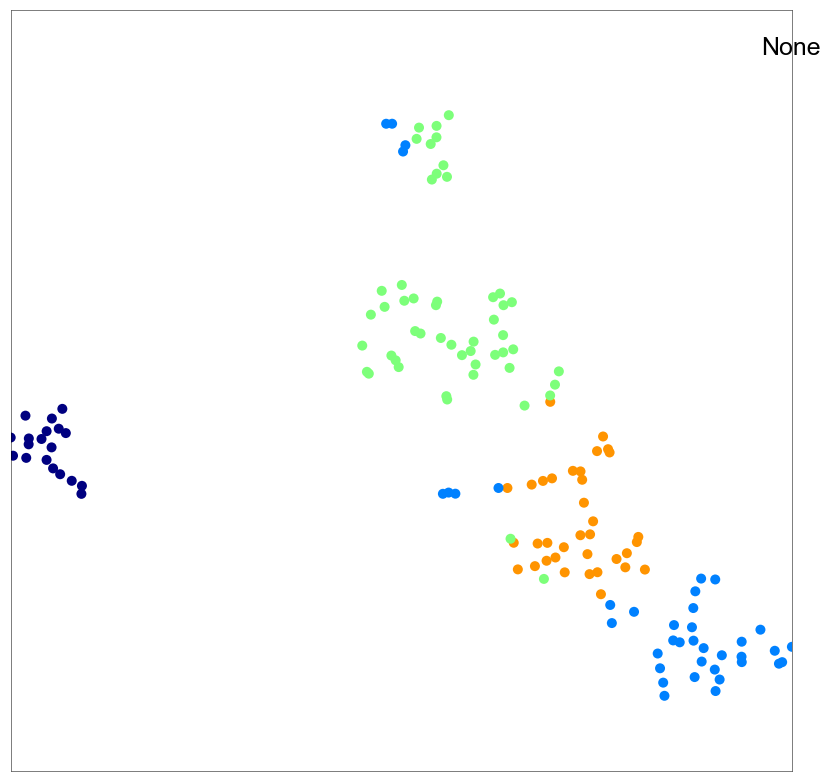

In [263]:
draw_tSNE(tsne_MEL_S, cl_c_MEL_S, number = None, cmap = plt.cm.jet)

## Compare AP and Seurat

In [264]:
seurat_vs_AP_MEL = seurat_vs_AP(cl_c_MEL_S[c_sel], cl_c_MEL_AP[c_sel])

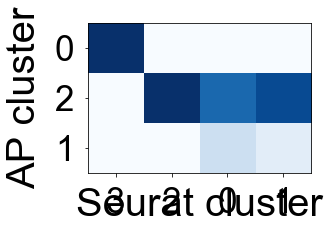

In [265]:
data = seurat_vs_AP_MEL

#generate figure

fig = plt.figure(facecolor = 'w', figsize = (len(data.columns), len(data.index)))
gs = plt.GridSpec(nrows = 2, ncols = 1, wspace=0.0, hspace=0.0, height_ratios=[1.0, 11.0])

#generate plot

ax = plt.subplot(gs[1])

#generate xaxis

ax.set_xlim(-0.5, len(data.columns) - 0.5)
ax.set_xticks(np.arange(0, len(data.columns)))
ax.set_xticklabels([c for c in data.columns], family = 'Arial', fontsize = 35)
ax.set_xlabel('Seurat cluster', family = 'Arial', fontsize = 40)
ax.xaxis.set_label_coords(0.5, -0.1)
ax.tick_params(axis='x', which='major', pad=10)

#generate yaxis

ax.set_ylim(len(data.index) -0.5, -0.5)
ax.set_yticks(np.arange(0, len(data.index)))
ax.set_yticklabels([ix for ix in data.index], family = 'Arial', fontsize = 35)
ax.set_ylabel('AP cluster', family = 'Arial', fontsize = 40)
ax.yaxis.set_label_coords(-0.2, 0.5)
ax.tick_params(axis='y', which='major', pad=10)

#plot data

ax.imshow(data.astype(float),
          cmap = plt.cm.Blues,
          aspect = 'auto',
          interpolation = 'nearest',
          vmin = 0, vmax = 1)

## Use AP clustering

In [266]:
cl_c_MEL = pd.Series(['MEL - %s' % cl for cl in cl_c_MEL_AP], index = cl_c_MEL_AP.index)

In [267]:
Counter(cl_c_MEL)

Counter({'MEL - 0': 19, 'MEL - 1': 15, 'MEL - 2': 110})

In [268]:
cmap_MEL = {'MEL - 0': '#e6ab02', 
             'MEL - 1': '#7570b3', 
             'MEL - 2': '#66a61e'}

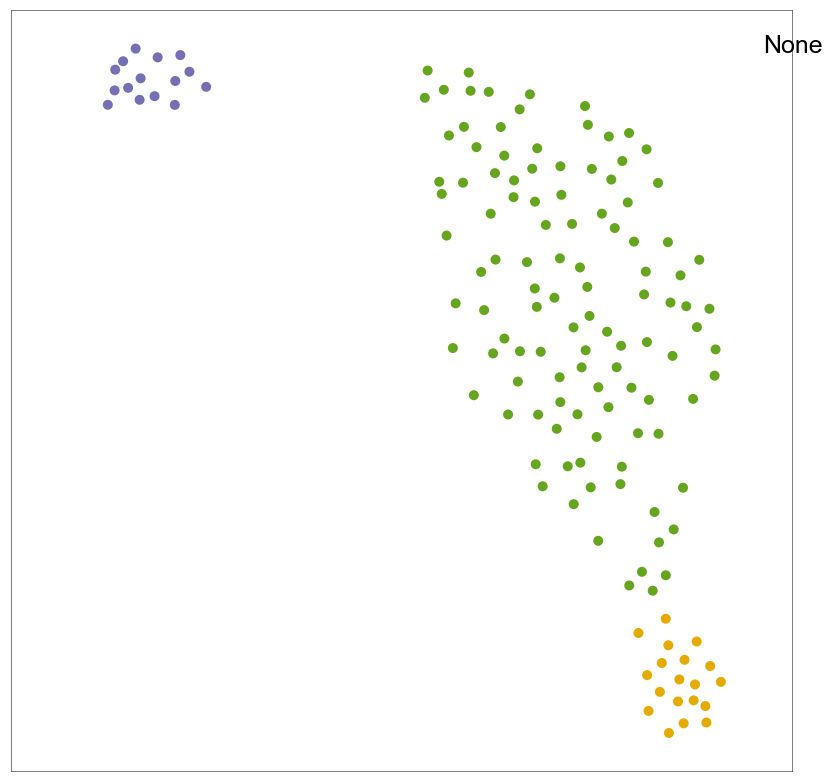

In [269]:
draw_tSNE(umap_MEL, cl_c_MEL, number = None, cmap = cmap_MEL, pad = 2)

In [270]:
cl_c_MEL = AP_order_incluster(dist_c_MEL.loc[cl_c_MEL.index, cl_c_MEL.index], cl_c_MEL, method='ward', metric='euclidean')

In [271]:
cl_c_MEL = AP_groups_reorder_v2(cl_c_MEL, ['MEL - 1','MEL - 2','MEL - 0'])

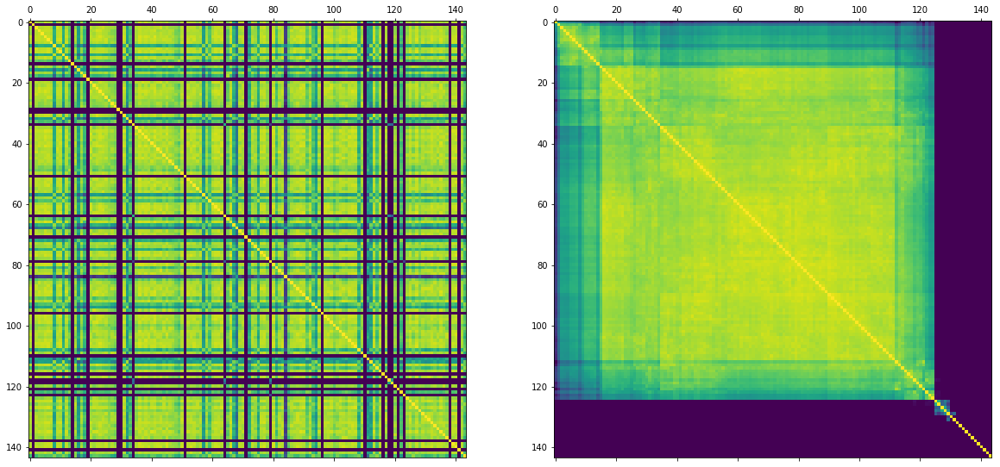

In [272]:
draw_AP_dist_mat(dist_c_MEL.loc[cl_c_MEL.index, cl_c_MEL.index], cl_c_MEL, cmap = plt.cm.viridis_r, vmin = 0, vmax = 25.0)

### Checkpoint

In [273]:
#saveData_v1(cl_c_MEL, path_output, exp_id, 'cl_c_MEL')

In [274]:
cl_c_MEL = loadData_v1(path_output, exp_id, 'cl_c_MEL', 'Series')

# Miscellaneous cell subclustering with Affinity Propagation

### Feature selection

In [437]:
c_sel_MISC = list(cl_c_1st[cl_c_1st=='MISC'].index) + list(c_FIB_to_MISC)

In [438]:
len(c_sel_MISC)

78


Dropping unexpressed genes from dataset

After mean expression cutoff of 0.025, 5957 genes remain

After high variance feature selection, 2500 genes remain


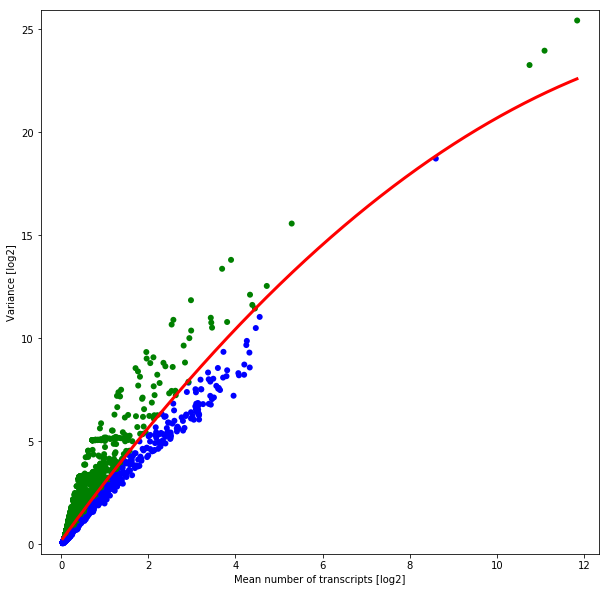

In [439]:
seq_sel_MISC = select_features_log2_var_polyfit_v2(seqN[c_sel_MISC], 0.025, 2500)

### Checkpoint

In [277]:
#saveData_v1(seq_sel_MISC, path_output, exp_id, 'seq_sel_MISC')

In [278]:
seq_sel_MISC = loadData_v1(path_output, exp_id, 'seq_sel_MISC', 'DataFrame')

## Dimensionality reduction with PCA

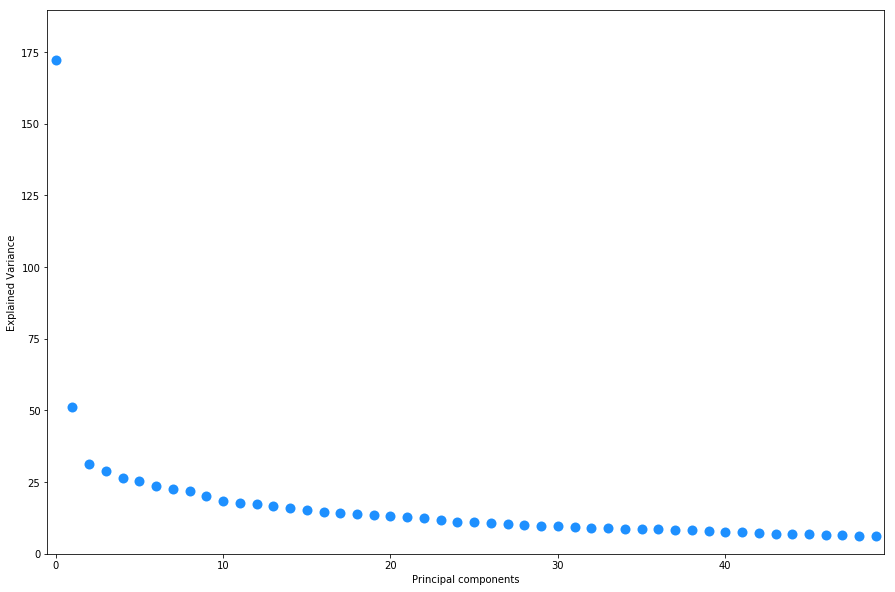

In [279]:
pca_explained_var(seq_sel_MISC)

In [280]:
seq_sel_MISC_pca, dist_c_MISC = dim_reduc_pca(seq_sel_MISC, 10, 'euclidean', inverse_transform = False)

In [281]:
aff_c_MISC = -dist_c_MISC

## Umap embedding of PCs

In [128]:
scdata_MISC = to_scanpy(seq_sel_MISC)

In [129]:
sc.pp.pca(scdata_MISC, n_comps = 10)

In [130]:
sc.pp.neighbors(scdata_MISC, n_neighbors=20, n_pcs=10, method = 'umap')

In [131]:
sc.tl.umap(scdata_MISC, min_dist = 0.5, spread = 5)

/Users/simjoo/anaconda/lib/python3.6/site-packages/scanpy/neighbors/umap/umap_.py:1173: RuntimeWarning: divide by zero encountered in power
  return 1.0 / (1.0 + a * x ** (2 * b))


In [132]:
umap_MISC = pd.DataFrame(scdata_MISC.obsm['X_umap'], index = scdata_MISC.obs['CellID'], columns = ['x','y'])

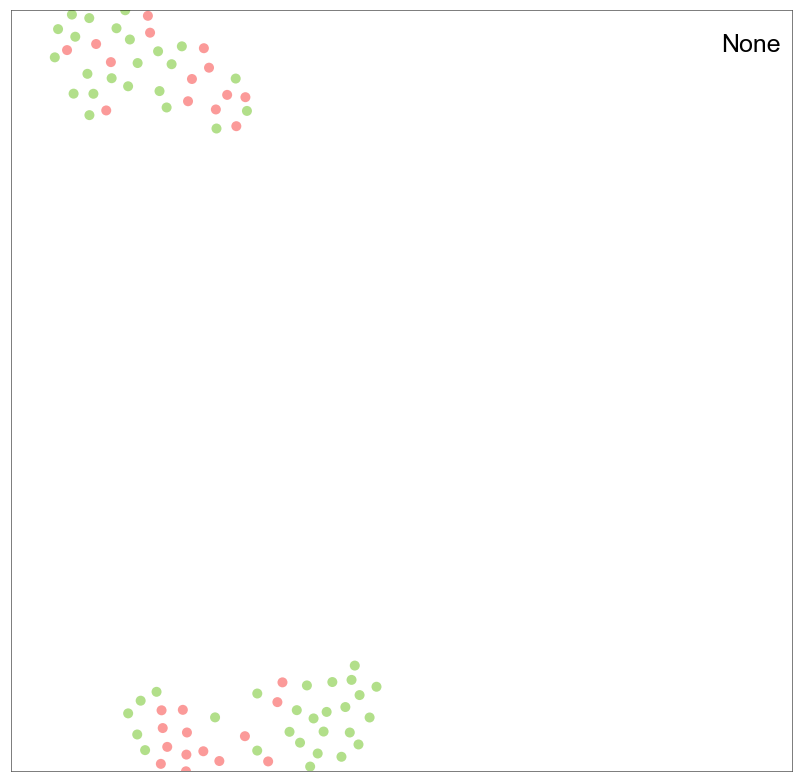

In [133]:
draw_tSNE(umap_MISC, cells_stage, number = None, cmap = {'5w':'#fb9a99','9w':'#b2df8a'})

## Cluster all cells and screen clusters for populations not yet defined in the analysis.

In [134]:
cl_c_MISC_AP =  AP_clustering_v4P(aff_c_MISC, 0, -150, 0.85)

In [135]:
len(set(cl_c_MISC_AP))

2

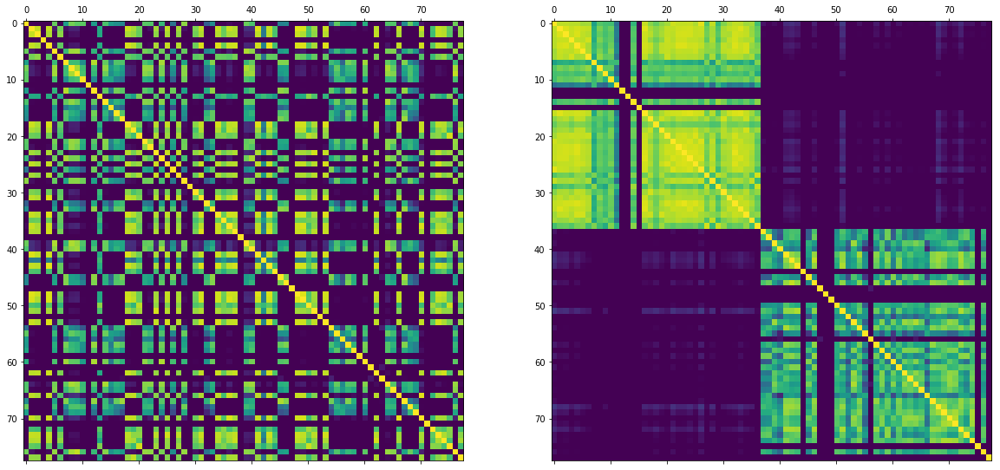

In [136]:
draw_AP_dist_mat(aff_c_MISC, cl_c_MISC_AP, cmap = plt.cm.viridis, vmin = -25.0, vmax = 0.0)

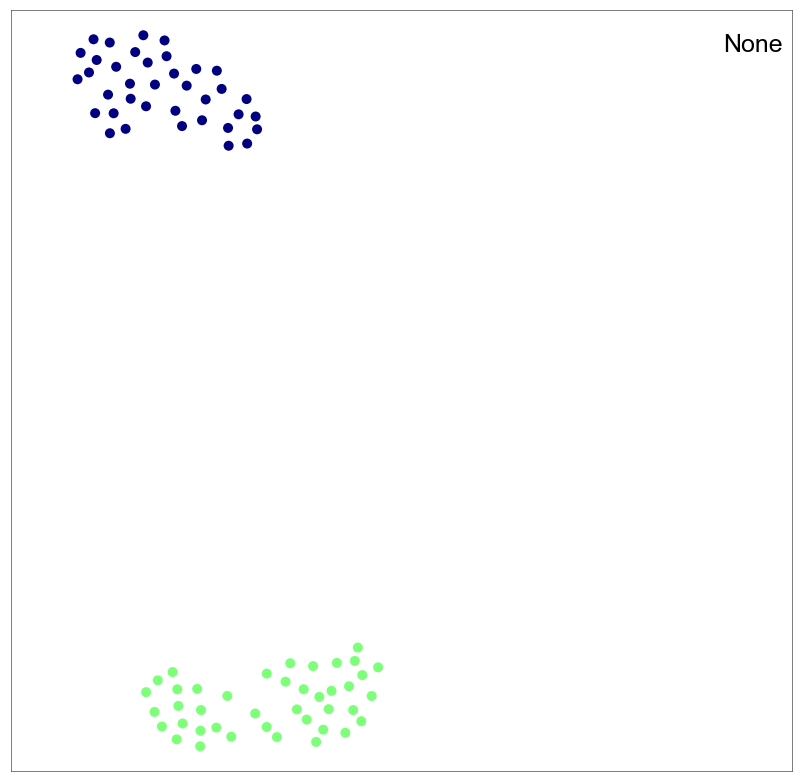

In [287]:
draw_tSNE(umap_MISC, cl_c_MISC_AP, number = None, cmap = plt.cm.jet, pad = 2)

### Checkpoint

In [288]:
#saveData_v1(umap_MISC, path_output, exp_id, 'umap_MISC')
#saveData_v1(cl_c_MISC_AP, path_output, exp_id, 'cl_c_MISC_AP')

In [289]:
umap_MISC = loadData_v1(path_output, exp_id, 'umap_MISC', 'DataFrame')
cl_c_MISC_AP = loadData_v1(path_output, exp_id, 'cl_c_MISC_AP', 'Series')

# Miscellaneous subclustering with Seurat

## Import clustering data and tSNE

In [290]:
cl_c_MISC_S = pd.read_csv('%s/Seurat/TenX_2ndLevel_Misc_ClusterIdentity.txt' % path_output, sep = '\t', header = None, index_col = 0, 
                           low_memory = False, squeeze = True)

In [291]:
tsne_MISC_S = pd.read_csv('%s/Seurat/TenX_2ndLevel_MISC_TSNEcoordinates.txt' % path_output, sep = '\t', index_col = 0, header = 0)
tsne_MISC_S.columns = ['x','y']

In [292]:
c_sel = list(set(cl_c_MISC_S.index) & set(cl_c_MISC_AP.index))

In [293]:
cl_c_MISC_S = cl_c_MISC_S[c_sel]

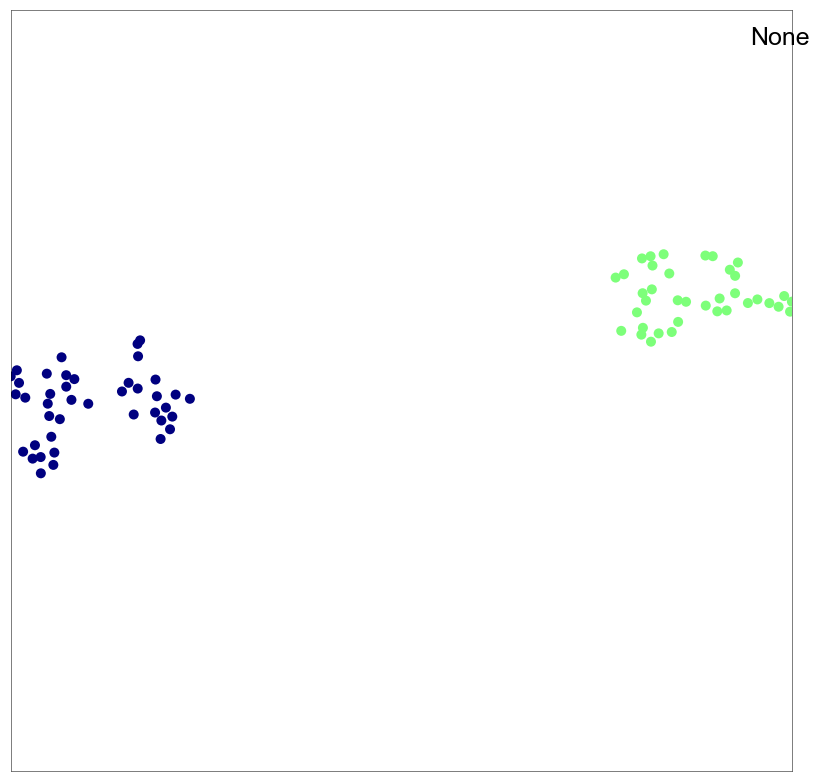

In [294]:
draw_tSNE(tsne_MISC_S, cl_c_MISC_S, number = None, cmap = plt.cm.jet)

## Compare AP and Seurat

In [295]:
seurat_vs_AP_MISC = seurat_vs_AP(cl_c_MISC_S[c_sel], cl_c_MISC_AP[c_sel])

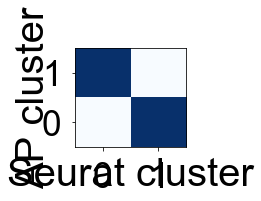

In [296]:
data = seurat_vs_AP_MISC

#generate figure

fig = plt.figure(facecolor = 'w', figsize = (len(data.columns), len(data.index)))
gs = plt.GridSpec(nrows = 2, ncols = 1, wspace=0.0, hspace=0.0, height_ratios=[1.0, 11.0])

#generate plot

ax = plt.subplot(gs[1])

#generate xaxis

ax.set_xlim(-0.5, len(data.columns) - 0.5)
ax.set_xticks(np.arange(0, len(data.columns)))
ax.set_xticklabels([c for c in data.columns], family = 'Arial', fontsize = 35)
ax.set_xlabel('Seurat cluster', family = 'Arial', fontsize = 40)
ax.xaxis.set_label_coords(0.5, -0.1)
ax.tick_params(axis='x', which='major', pad=10)

#generate yaxis

ax.set_ylim(len(data.index) -0.5, -0.5)
ax.set_yticks(np.arange(0, len(data.index)))
ax.set_yticklabels([ix for ix in data.index], family = 'Arial', fontsize = 35)
ax.set_ylabel('AP cluster', family = 'Arial', fontsize = 40)
ax.yaxis.set_label_coords(-0.2, 0.5)
ax.tick_params(axis='y', which='major', pad=10)

#plot data

ax.imshow(data.astype(float),
          cmap = plt.cm.Blues,
          aspect = 'auto',
          interpolation = 'nearest',
          vmin = 0, vmax = 1)

## Use AP data

In [297]:
cl_c_MISC = pd.Series(['MISC - %s' % c for c in cl_c_MISC_AP], index = cl_c_MISC_AP.index)

In [298]:
Counter(cl_c_MISC)

Counter({'MISC - 0': 37, 'MISC - 1': 41})

In [299]:
cmap_MISC = {'MISC - 0': '#1b9e77',
             'MISC - 1': '#d95f02'}

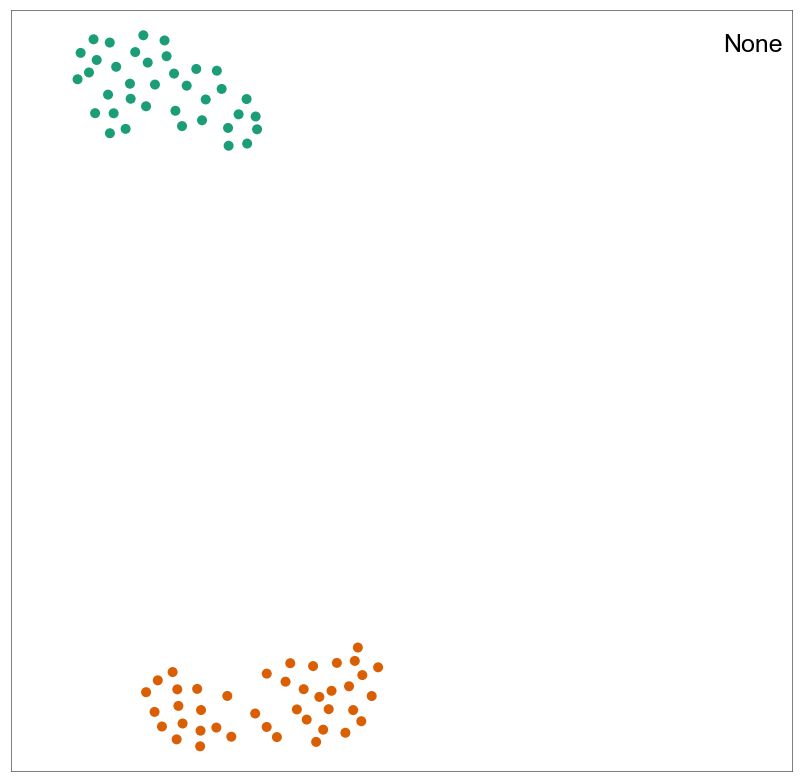

In [300]:
draw_tSNE(umap_MISC, cl_c_MISC, number = None, cmap = cmap_MISC, pad = 2)

In [301]:
cl_c_MISC = AP_order_incluster(dist_c_MISC.loc[cl_c_MISC.index, cl_c_MISC.index], cl_c_MISC, method='ward', metric='euclidean')

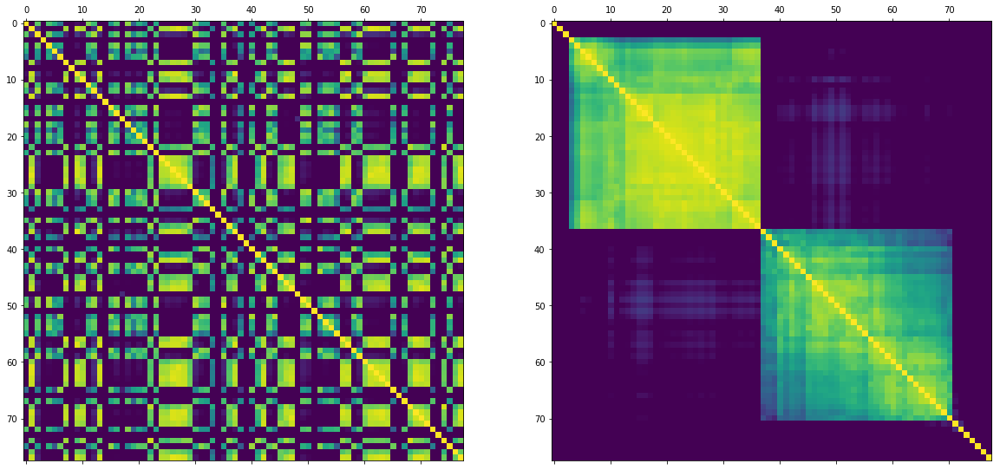

In [302]:
draw_AP_dist_mat(dist_c_MISC.loc[cl_c_MISC.index, cl_c_MISC.index], cl_c_MISC, cmap = plt.cm.viridis_r, vmin = 0, vmax = 25.0)

### Checkpoint

In [303]:
#saveData_v1(cl_c_MISC, path_output, exp_id, 'cl_c_MISC')

In [304]:
cl_c_MISC = loadData_v1(path_output, exp_id, 'cl_c_MISC', 'Series')

# Compile 2nd level clustering file

In [575]:
cl_c_2nd = pd.Series()

for c in cl_c_EPI.index:
    cl_c_2nd[c] = cl_c_EPI[c]

for c in cl_c_ANA.index:
    cl_c_2nd[c] = cl_c_ANA[c]

for c in cl_c_FIB.index:
    cl_c_2nd[c] = cl_c_FIB[c]
    
for c in cl_c_IMM.index:
    cl_c_2nd[c] = cl_c_IMM[c]
    
for c in cl_c_VASC.index:
    cl_c_2nd[c] = cl_c_VASC[c]
    
for c in cl_c_MEL.index:
    cl_c_2nd[c] = cl_c_MEL[c]
    
for c in cl_c_MISC.index:
    cl_c_2nd[c] = cl_c_MISC[c]
    
for c in [c for c in cl_c_1st.index if c not in cl_c_2nd]:
    cl_c_2nd[c] = 'JUNK'

In [576]:
Counter(cl_c_2nd)

Counter({'EPI - 0': 100,
         'EPI - 1': 1054,
         'EPI - 2': 537,
         'EPI - 3': 236,
         'EPI - 4': 397,
         'EPI - 5': 127,
         'EPI - 6': 28,
         'EPI - 7': 234,
         'EPI - 8': 98,
         'ANA - 1': 51,
         'ANA - 21': 36,
         'ANA - 0': 28,
         'ANA - 2': 101,
         'ANA - 3': 102,
         'ANA - 20': 17,
         'ANA - 16': 129,
         'ANA - 13': 139,
         'ANA - 15': 180,
         'ANA - 12': 113,
         'ANA - 17': 106,
         'ANA - 5': 182,
         'ANA - 4': 71,
         'ANA - 14': 96,
         'ANA - 6': 66,
         'ANA - 7': 123,
         'ANA - 10': 77,
         'ANA - 11': 39,
         'ANA - 18': 171,
         'ANA - 8': 147,
         'FIB - 6': 71,
         'FIB - 5': 103,
         'FIB - 4': 77,
         'FIB - 3': 63,
         'FIB - 1': 19,
         'FIB - 2': 21,
         'FIB - 0': 31,
         'IMM - 3': 28,
         'IMM - 4': 46,
         'IMM - 1': 55,
         'IMM - 5': 6,
         '

### Checkpoint

In [577]:
#saveData_v1(cl_c_2nd, path_output, exp_id, 'cl_c_2nd')

In [578]:
cl_c_2nd = loadData_v1(path_output, exp_id, 'cl_c_2nd', 'Series')

# Compile new 1st level clustering file to include reassigned cells

In [580]:
#saveData_v1(cl_c_1st, path_output, exp_id, 'cl_c_1st_intermediate')

In [581]:
#cl_c_1st = loadData_v1(path_output, exp_id, 'cl_c_1st_intermediate', 'Series')

In [582]:
cl_c_1st = pd.Series([c.split(' - ')[0] for c in cl_c_2nd], index = cl_c_2nd.index)

In [583]:
Counter(cl_c_1st)

Counter({'EPI': 2811,
         'ANA': 1974,
         'FIB': 385,
         'IMM': 210,
         'VASC': 165,
         'MEL': 144,
         'MISC': 78,
         'JUNK': 328})

### Checkpoint

In [584]:
saveData_v1(cl_c_1st, path_output, exp_id, 'cl_c_1st')

In [585]:
cl_c_1st = loadData_v1(path_output, exp_id, 'cl_c_1st', 'Series')

# Compile colormaps

In [586]:
import pickle

## 1st level clustering

In [587]:
path = '%s/%s_cmap_1st.pkl' % (path_output, exp_id)
f = open(path, 'wb')
pickle.dump(cmap_1st, f)

In [588]:
path = '%s/%s_cmap_1st.pkl' % (path_output, exp_id)
f = open(path, 'rb')
cmap_1st = pickle.load(f)

## 2nd level clustering

In [589]:
cmap_2nd = {**cmap_EPI, **cmap_ANA, **cmap_ANA_IRS, **cmap_FIB, **cmap_IMM, **cmap_VASC, **cmap_MEL, **cmap_MISC}

In [590]:
path = '%s/%s_cmap_2nd.pkl' % (path_output, exp_id)
f = open(path, 'wb')
pickle.dump(cmap_2nd, f)

In [69]:
path = '%s/%s_cmap_2nd.pkl' % (path_output, exp_id)
f = open(path, 'rb')
cmap_2nd = pickle.load(f)

# Call differentially expressed genes using Mann-Whitney U

In [592]:
seqN = loadData_v1(path_output, exp_id, 'seqN', 'DataFrame')

In [593]:
seqN_log2 = np.log2(seqN + 1)

In [20]:
cl_c_1st = loadData_v1(path_output, exp_id, 'cl_c_1st', 'Series')
cl_c_2nd = loadData_v1(path_output, exp_id, 'cl_c_2nd', 'Series')

## 1st level clustering

In [595]:
genes_sel_1st = dropNull_v2X(seqN[cl_c_1st.index], None, 0.01).index


Dropping unexpressed genes from dataset


In [596]:
len(genes_sel_1st)

11325

In [597]:
mwu_av_1st = MWU_vs_average(seqN_log2, cl_c_1st, genes_sel_1st, dview)

/Users/simjoo/Projects/10X_Skin/scripts/Skin10X_mann_whitney_u_v1_3.py:82: RuntimeWarning: divide by zero encountered in log10
  output = -np.log10(output.astype(float))


In [598]:
mwu_gr_1st = MWU_vs_groups(seqN_log2, cl_c_1st, genes_sel_1st, dview)

### Checkpoint

In [599]:
saveData_v1(mwu_av_1st, path_output, exp_id, 'mwu_av_1st')
saveData_v1(mwu_gr_1st, path_output, exp_id, 'mwu_gr_1st')

## 2nd level clustering - permanent epidermis

In [600]:
cl_c_EPI = cl_c_2nd[[ix for ix in cl_c_2nd.index if cl_c_2nd[ix].split()[0] == 'EPI']]

In [601]:
genes_sel_EPI = dropNull_v2X(seqN[cl_c_EPI.index], None, 0.01).index


Dropping unexpressed genes from dataset


In [602]:
len(genes_sel_EPI)

10133

In [603]:
mwu_av_EPI = MWU_vs_average(seqN_log2, cl_c_EPI, genes_sel_EPI, dview)

In [604]:
mwu_gr_EPI = MWU_vs_groups(seqN_log2, cl_c_EPI, genes_sel_EPI, dview)

### Checkpoint

In [605]:
saveData_v1(mwu_av_EPI, path_output, exp_id, 'mwu_av_EPI')
saveData_v1(mwu_gr_EPI, path_output, exp_id, 'mwu_gr_EPI')

## 2nd level clustering - anagen HF

In [21]:
cl_c_ANA = cl_c_2nd[[ix for ix in cl_c_2nd.index if cl_c_2nd[ix].split()[0] == 'ANA']]

In [607]:
genes_sel_ANA = dropNull_v2X(seqN[cl_c_ANA.index], None, 0.01).index


Dropping unexpressed genes from dataset


In [608]:
len(genes_sel_ANA)

9892

In [609]:
mwu_av_ANA = MWU_vs_average(seqN_log2, cl_c_ANA, genes_sel_ANA, dview)

In [610]:
mwu_gr_ANA = MWU_vs_groups(seqN_log2, cl_c_ANA, genes_sel_ANA, dview)

### Checkpoint

In [611]:
saveData_v1(mwu_av_ANA, path_output, exp_id, 'mwu_av_ANA')
saveData_v1(mwu_gr_ANA, path_output, exp_id, 'mwu_gr_ANA')

## 2nd level clustering - anagen HF - IRS

In [18]:
cl_c_ANA_IRS = loadData_v1(path_output, exp_id, 'cl_c_ANA_IRS', 'Series')

In [613]:
genes_sel_ANA_IRS = dropNull_v2X(seqN[cl_c_ANA_IRS.index], None, 0.01).index


Dropping unexpressed genes from dataset


In [614]:
len(genes_sel_ANA_IRS)

9083

In [615]:
mwu_av_ANA_IRS = MWU_vs_average(seqN_log2, cl_c_ANA_IRS, genes_sel_ANA_IRS, dview)

In [616]:
mwu_gr_ANA_IRS = MWU_vs_groups(seqN_log2, cl_c_ANA_IRS, genes_sel_ANA_IRS, dview)

### Checkpoint

In [617]:
saveData_v1(mwu_av_ANA_IRS, path_output, exp_id, 'mwu_av_ANA_IRS')
saveData_v1(mwu_gr_ANA_IRS, path_output, exp_id, 'mwu_gr_ANA_IRS')

## 2nd level clustering - fibroblasts

In [618]:
cl_c_FIB = cl_c_2nd[[ix for ix in cl_c_2nd.index if cl_c_2nd[ix].split()[0] == 'FIB']]

In [619]:
genes_sel_FIB = dropNull_v2X(seqN[cl_c_FIB.index], None, 0.01).index


Dropping unexpressed genes from dataset


In [620]:
len(genes_sel_FIB)

10839

In [621]:
mwu_av_FIB = MWU_vs_average(seqN_log2, cl_c_FIB, genes_sel_FIB, dview)

In [622]:
mwu_gr_FIB = MWU_vs_groups(seqN_log2, cl_c_FIB, genes_sel_FIB, dview)

### Checkpoint

In [623]:
saveData_v1(mwu_av_FIB, path_output, exp_id, 'mwu_av_FIB')
saveData_v1(mwu_gr_FIB, path_output, exp_id, 'mwu_gr_FIB')

## 2nd level clustering - immune cells

In [624]:
cl_c_IMM = cl_c_2nd[[ix for ix in cl_c_2nd.index if cl_c_2nd[ix].split()[0] == 'IMM']]

In [625]:
genes_sel_IMM = dropNull_v2X(seqN[cl_c_IMM.index], None, 0.01).index


Dropping unexpressed genes from dataset


In [626]:
len(genes_sel_IMM)

9154

In [627]:
mwu_av_IMM = MWU_vs_average(seqN_log2, cl_c_IMM, genes_sel_IMM, dview)

In [628]:
mwu_gr_IMM = MWU_vs_groups(seqN_log2, cl_c_IMM, genes_sel_IMM, dview)

### Checkpoint

In [629]:
saveData_v1(mwu_av_IMM, path_output, exp_id, 'mwu_av_IMM')
saveData_v1(mwu_gr_IMM, path_output, exp_id, 'mwu_gr_IMM')

## 2nd level clustering - vascular cells

In [630]:
cl_c_VASC = cl_c_2nd[[ix for ix in cl_c_2nd.index if cl_c_2nd[ix].split()[0] == 'VASC']]

In [631]:
genes_sel_VASC = dropNull_v2X(seqN[cl_c_VASC.index], None, 0.01).index


Dropping unexpressed genes from dataset


In [632]:
len(genes_sel_VASC)

10399

In [633]:
mwu_av_VASC = MWU_vs_average(seqN_log2, cl_c_VASC, genes_sel_VASC, dview)

In [634]:
mwu_gr_VASC = MWU_vs_groups(seqN_log2, cl_c_VASC, genes_sel_VASC, dview)

### Checkpoint

In [635]:
saveData_v1(mwu_av_VASC, path_output, exp_id, 'mwu_av_VASC')
saveData_v1(mwu_gr_VASC, path_output, exp_id, 'mwu_gr_VASC')

## 2nd level clustering - neural crest derived cells

In [636]:
cl_c_MEL = cl_c_2nd[[ix for ix in cl_c_2nd.index if cl_c_2nd[ix].split()[0] == 'MEL']]

In [637]:
genes_sel_MEL = dropNull_v2X(seqN[cl_c_MEL.index], None, 0.01).index


Dropping unexpressed genes from dataset


In [638]:
len(genes_sel_MEL)

9865

In [639]:
mwu_av_MEL = MWU_vs_average(seqN_log2, cl_c_MEL, genes_sel_MEL, dview)

In [640]:
mwu_gr_MEL = MWU_vs_groups(seqN_log2, cl_c_MEL, genes_sel_MEL, dview)

### Checkpoint

In [641]:
saveData_v1(mwu_av_MEL, path_output, exp_id, 'mwu_av_MEL')
saveData_v1(mwu_gr_MEL, path_output, exp_id, 'mwu_gr_MEL')

## 2nd level clustering - miscellaneous cells

In [642]:
cl_c_MISC = cl_c_2nd[[ix for ix in cl_c_2nd.index if cl_c_2nd[ix].split()[0] == 'MISC']]

In [643]:
genes_sel_MISC = dropNull_v2X(seqN[cl_c_MISC.index], None, 0.01).index


Dropping unexpressed genes from dataset


In [644]:
len(genes_sel_MISC)

6589

In [645]:
mwu_av_MISC = MWU_vs_average(seqN_log2, cl_c_MISC, genes_sel_MISC, dview)

In [646]:
mwu_gr_MISC = MWU_vs_groups(seqN_log2, cl_c_MISC, genes_sel_MISC, dview)

### Checkpoint

In [647]:
saveData_v1(mwu_av_MISC, path_output, exp_id, 'mwu_av_MISC')
saveData_v1(mwu_gr_MISC, path_output, exp_id, 'mwu_gr_MISC')

## 2nd level clustering - all cells

In [648]:
cl_c_2nd_sel = cl_c_2nd[cl_c_2nd!='JUNK']

In [649]:
genes_sel_2nd = dropNull_v2X(seqN[cl_c_2nd_sel.index], None, 0.01).index


Dropping unexpressed genes from dataset


In [650]:
len(genes_sel_2nd)

11268

In [651]:
mwu_av_2nd = MWU_vs_average(seqN_log2, cl_c_2nd_sel, genes_sel_2nd, dview)

/Users/simjoo/Projects/10X_Skin/scripts/Skin10X_mann_whitney_u_v1_3.py:82: RuntimeWarning: divide by zero encountered in log10
  output = -np.log10(output.astype(float))


In [652]:
mwu_gr_2nd = MWU_vs_groups(seqN_log2, cl_c_2nd_sel, genes_sel_2nd, dview)

### Checkpoint

In [653]:
saveData_v1(mwu_av_2nd, path_output, exp_id, 'mwu_av_2nd')
saveData_v1(mwu_gr_2nd, path_output, exp_id, 'mwu_gr_2nd')

# Cell cycle stage assignment and regression

## Performed in Seurat

In [656]:
cc_score = loadData_v1(path_output, exp_id, 'cc_score','DataFrame')
cc_score.index = [ix.replace('.','-') for ix in cc_score.index]

## Set classification threshold for S / G2M more stringently

In [657]:
cc_score_v2 = pd.Series('G1', index = cc_score.index)

for c in cc_score.index:
    if cc_score.loc[c, 'S.Score'] > 0.1 and cc_score.loc[c, 'S.Score'] >= cc_score.loc[c, 'G2M.Score']:
        cc_score_v2[c] = 'S'
    elif cc_score.loc[c, 'G2M.Score'] > 0.1 and cc_score.loc[c, 'S.Score'] <= cc_score.loc[c, 'G2M.Score']:
        cc_score_v2[c] = 'G2M'

### Checkpoint

In [658]:
saveData_v1(cc_score_v2, path_output, exp_id, 'cc_score_v2')